# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: data: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

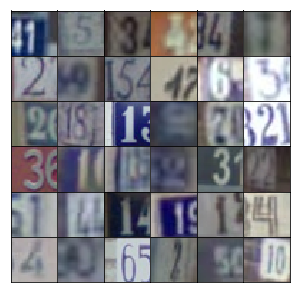

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def leaky_relu(input, alpha=0.2, name='leaky_relu'):
    return tf.maximum(input, input * alpha, name=name)

def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        h1 = tf.layers.dense(z, 4*4*512, name='h1')
        h1 = tf.reshape(h1, (-1, 4, 4, 512))
        h1 = tf.layers.batch_normalization(h1, training=training, name='h1_norm')
        h1 = leaky_relu(h1, alpha, name='h1_relu')
        
        # 8 x 8 x 256
        c1 = tf.layers.conv2d_transpose(h1, filters=256, kernel_size=5, strides=2, name='c1', padding='same')
        c1 = tf.layers.batch_normalization(c1, training=training, name='c1_norm')
        c1 = leaky_relu(c1, alpha, name='c1_relu')
        
        # 16 x 16 x 128
        c2 = tf.layers.conv2d_transpose(c1, filters=128, kernel_size=5, strides=2, name='c2', padding='same')
        c2 = tf.layers.batch_normalization(c2, training=training, name='c2_norm')
        c2 = leaky_relu(c2, alpha, name='c2_relu')

        # 32 x 32 x output_dim
        c3 = tf.layers.conv2d_transpose(c2, filters=output_dim, kernel_size=5, strides=2, name='c3', padding='same')
        # Output layer, 32x32x3
        c3.set_shape([None, 32, 32, output_dim])
        logits = c3
        
        out = tf.tanh(logits, name='c3_tanh')
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        # 16 x 16 x 64
        c1 = tf.layers.conv2d(x, filters=64, kernel_size=5, strides=2, padding='same')
        #c1 = tf.layers.batch_normalization(c1, training=True, name='c1_norm')
        c1 = leaky_relu(c1, alpha, name='c1_relu')

        # 8 x 8 x 128
        c2 = tf.layers.conv2d(c1, filters=128, kernel_size=5, strides=2, padding='same')
        c2 = tf.layers.batch_normalization(c2, training=True, name='c2_norm')
        c2 = leaky_relu(c2, alpha, name='c2_relu')

        # 4 x 4 x 256
        c3 = tf.layers.conv2d(c2, filters=256, kernel_size=5, strides=2, padding='same')
        c3 = tf.layers.batch_normalization(c3, training=True, name='c3_norm')
        c3 = leaky_relu(c3, alpha, name='c3_relu')
        c3.set_shape([None, 4, 4, 256])

        c3 = tf.reshape(c3, (-1, 4*4*256))
        logits = tf.layers.dense(c3, 1, name='out')
        out = tf.nn.sigmoid(logits, name='sigmoid')
        print('logits shape: ', logits.shape)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

logits shape:  (?, 1)
logits shape:  (?, 1)


Epoch 1/25... Discriminator Loss: 1.5108... Generator Loss: 0.5602
Epoch 1/25... Discriminator Loss: 0.3206... Generator Loss: 3.3879
Epoch 1/25... Discriminator Loss: 0.1190... Generator Loss: 2.9884
Epoch 1/25... Discriminator Loss: 0.1392... Generator Loss: 2.7610
Epoch 1/25... Discriminator Loss: 0.1570... Generator Loss: 2.8155
Epoch 1/25... Discriminator Loss: 0.1327... Generator Loss: 2.6617
Epoch 1/25... Discriminator Loss: 0.1207... Generator Loss: 2.8139
Epoch 1/25... Discriminator Loss: 0.1546... Generator Loss: 3.0015
Epoch 1/25... Discriminator Loss: 0.3576... Generator Loss: 1.5477
Epoch 1/25... Discriminator Loss: 0.1740... Generator Loss: 2.8364


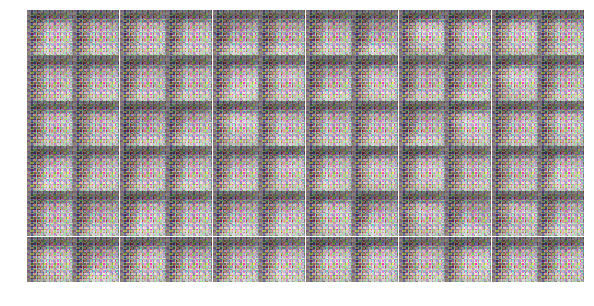

Epoch 1/25... Discriminator Loss: 0.1522... Generator Loss: 2.8285
Epoch 1/25... Discriminator Loss: 0.5711... Generator Loss: 1.4764
Epoch 1/25... Discriminator Loss: 1.0864... Generator Loss: 0.7890
Epoch 1/25... Discriminator Loss: 0.6523... Generator Loss: 1.4401
Epoch 1/25... Discriminator Loss: 0.6851... Generator Loss: 1.1563
Epoch 1/25... Discriminator Loss: 0.3733... Generator Loss: 2.8334
Epoch 1/25... Discriminator Loss: 0.2686... Generator Loss: 1.9844
Epoch 1/25... Discriminator Loss: 0.6563... Generator Loss: 2.4771
Epoch 1/25... Discriminator Loss: 0.7321... Generator Loss: 4.7606
Epoch 1/25... Discriminator Loss: 0.3192... Generator Loss: 1.6989


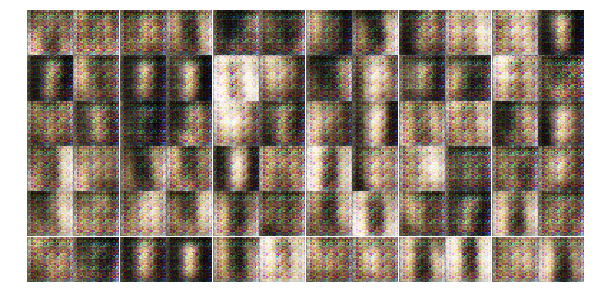

Epoch 1/25... Discriminator Loss: 1.0022... Generator Loss: 0.5956
Epoch 1/25... Discriminator Loss: 0.4784... Generator Loss: 2.3855
Epoch 1/25... Discriminator Loss: 1.4432... Generator Loss: 1.0103
Epoch 1/25... Discriminator Loss: 0.3145... Generator Loss: 3.2501
Epoch 1/25... Discriminator Loss: 0.1066... Generator Loss: 4.3006
Epoch 1/25... Discriminator Loss: 0.3241... Generator Loss: 1.5996
Epoch 1/25... Discriminator Loss: 0.9472... Generator Loss: 1.3316
Epoch 1/25... Discriminator Loss: 1.0852... Generator Loss: 0.8489
Epoch 1/25... Discriminator Loss: 0.6243... Generator Loss: 1.9619
Epoch 1/25... Discriminator Loss: 0.4819... Generator Loss: 1.7068


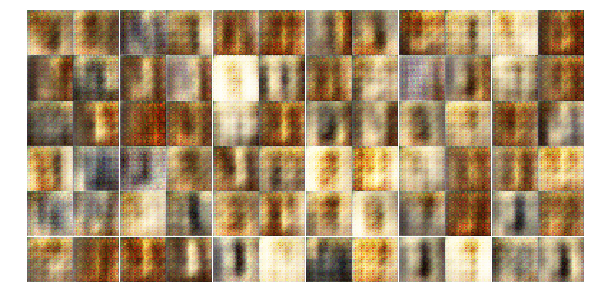

Epoch 1/25... Discriminator Loss: 0.8823... Generator Loss: 1.4877
Epoch 1/25... Discriminator Loss: 0.9478... Generator Loss: 0.9089
Epoch 1/25... Discriminator Loss: 0.8124... Generator Loss: 2.7786
Epoch 1/25... Discriminator Loss: 0.6737... Generator Loss: 1.3600
Epoch 1/25... Discriminator Loss: 0.5682... Generator Loss: 1.4567
Epoch 1/25... Discriminator Loss: 0.2276... Generator Loss: 2.6241
Epoch 1/25... Discriminator Loss: 0.3771... Generator Loss: 1.5662
Epoch 1/25... Discriminator Loss: 0.3303... Generator Loss: 3.1219
Epoch 1/25... Discriminator Loss: 0.2451... Generator Loss: 2.2885
Epoch 1/25... Discriminator Loss: 0.1554... Generator Loss: 3.3193


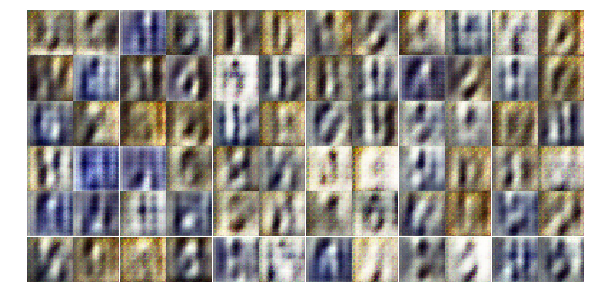

Epoch 1/25... Discriminator Loss: 0.3489... Generator Loss: 2.1260
Epoch 1/25... Discriminator Loss: 0.3723... Generator Loss: 2.2834
Epoch 1/25... Discriminator Loss: 0.4494... Generator Loss: 3.7286
Epoch 1/25... Discriminator Loss: 2.2280... Generator Loss: 3.2571
Epoch 1/25... Discriminator Loss: 1.0191... Generator Loss: 0.7813
Epoch 1/25... Discriminator Loss: 1.3859... Generator Loss: 0.5228
Epoch 1/25... Discriminator Loss: 0.3710... Generator Loss: 2.7886
Epoch 1/25... Discriminator Loss: 0.6317... Generator Loss: 2.4819
Epoch 1/25... Discriminator Loss: 0.8737... Generator Loss: 0.7728
Epoch 1/25... Discriminator Loss: 0.4906... Generator Loss: 1.8837


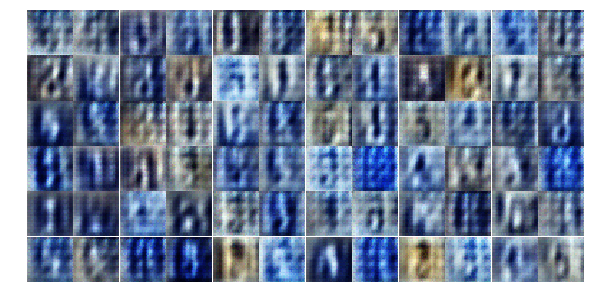

Epoch 1/25... Discriminator Loss: 0.5930... Generator Loss: 2.7341
Epoch 1/25... Discriminator Loss: 1.3863... Generator Loss: 0.4860
Epoch 1/25... Discriminator Loss: 0.8037... Generator Loss: 2.1293
Epoch 1/25... Discriminator Loss: 0.8069... Generator Loss: 1.2629
Epoch 1/25... Discriminator Loss: 0.5228... Generator Loss: 1.9806
Epoch 1/25... Discriminator Loss: 0.6288... Generator Loss: 1.2516
Epoch 1/25... Discriminator Loss: 0.6048... Generator Loss: 1.5774
Epoch 2/25... Discriminator Loss: 0.8005... Generator Loss: 1.3408
Epoch 2/25... Discriminator Loss: 0.6314... Generator Loss: 1.8174
Epoch 2/25... Discriminator Loss: 0.8750... Generator Loss: 1.1332


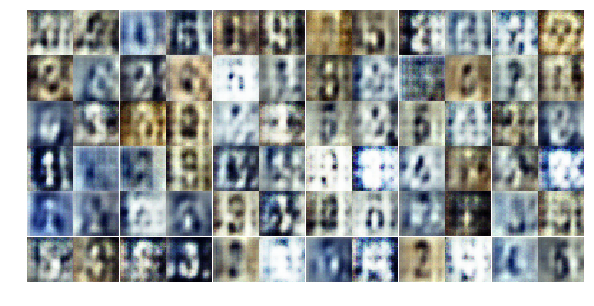

Epoch 2/25... Discriminator Loss: 0.7979... Generator Loss: 1.4794
Epoch 2/25... Discriminator Loss: 1.1035... Generator Loss: 0.7904
Epoch 2/25... Discriminator Loss: 1.0604... Generator Loss: 1.1737
Epoch 2/25... Discriminator Loss: 0.9294... Generator Loss: 1.3363
Epoch 2/25... Discriminator Loss: 0.8769... Generator Loss: 1.2805
Epoch 2/25... Discriminator Loss: 1.2041... Generator Loss: 0.7531
Epoch 2/25... Discriminator Loss: 0.9177... Generator Loss: 0.9984
Epoch 2/25... Discriminator Loss: 0.7160... Generator Loss: 1.4542
Epoch 2/25... Discriminator Loss: 0.7406... Generator Loss: 1.4165
Epoch 2/25... Discriminator Loss: 0.7621... Generator Loss: 1.1425


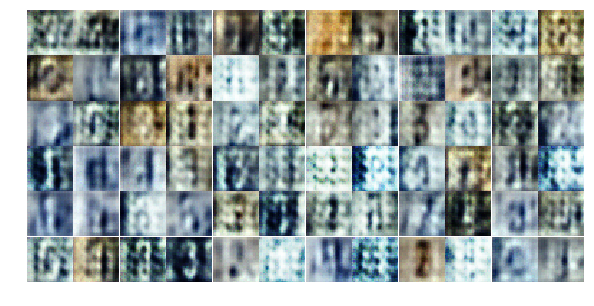

Epoch 2/25... Discriminator Loss: 1.1831... Generator Loss: 0.8731
Epoch 2/25... Discriminator Loss: 0.7952... Generator Loss: 1.3263
Epoch 2/25... Discriminator Loss: 1.0547... Generator Loss: 0.8865
Epoch 2/25... Discriminator Loss: 0.8934... Generator Loss: 1.2713
Epoch 2/25... Discriminator Loss: 1.2293... Generator Loss: 1.1039
Epoch 2/25... Discriminator Loss: 1.3594... Generator Loss: 0.7790
Epoch 2/25... Discriminator Loss: 1.0418... Generator Loss: 1.1797
Epoch 2/25... Discriminator Loss: 1.0082... Generator Loss: 1.0718
Epoch 2/25... Discriminator Loss: 1.0186... Generator Loss: 1.1629
Epoch 2/25... Discriminator Loss: 1.0257... Generator Loss: 0.8299


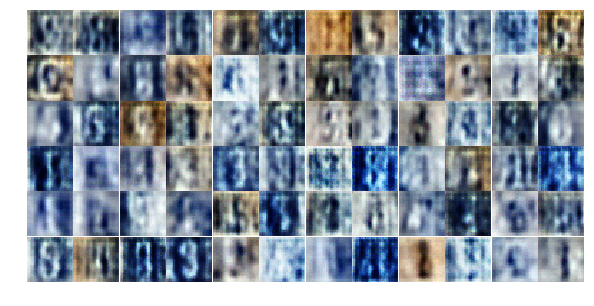

Epoch 2/25... Discriminator Loss: 0.8880... Generator Loss: 1.2063
Epoch 2/25... Discriminator Loss: 0.8483... Generator Loss: 1.2723
Epoch 2/25... Discriminator Loss: 0.8844... Generator Loss: 1.3768
Epoch 2/25... Discriminator Loss: 0.8556... Generator Loss: 1.3623
Epoch 2/25... Discriminator Loss: 1.1350... Generator Loss: 0.8778
Epoch 2/25... Discriminator Loss: 0.9394... Generator Loss: 1.0529
Epoch 2/25... Discriminator Loss: 0.7386... Generator Loss: 1.3638
Epoch 2/25... Discriminator Loss: 1.1787... Generator Loss: 0.6147
Epoch 2/25... Discriminator Loss: 1.1690... Generator Loss: 0.9405
Epoch 2/25... Discriminator Loss: 0.6790... Generator Loss: 1.3992


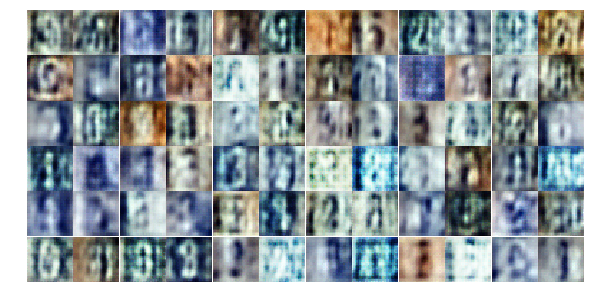

Epoch 2/25... Discriminator Loss: 0.8078... Generator Loss: 1.2353
Epoch 2/25... Discriminator Loss: 1.0974... Generator Loss: 1.1074
Epoch 2/25... Discriminator Loss: 1.4442... Generator Loss: 0.6195
Epoch 2/25... Discriminator Loss: 1.2956... Generator Loss: 0.8102
Epoch 2/25... Discriminator Loss: 0.8441... Generator Loss: 1.3447
Epoch 2/25... Discriminator Loss: 1.2905... Generator Loss: 0.9482
Epoch 2/25... Discriminator Loss: 0.6408... Generator Loss: 1.3044
Epoch 2/25... Discriminator Loss: 0.6812... Generator Loss: 1.7273
Epoch 2/25... Discriminator Loss: 1.0962... Generator Loss: 1.2324
Epoch 2/25... Discriminator Loss: 0.9179... Generator Loss: 1.1621


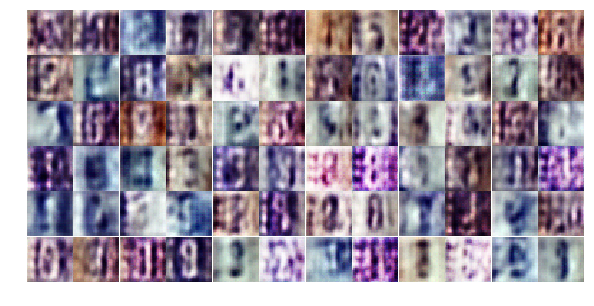

Epoch 2/25... Discriminator Loss: 0.8875... Generator Loss: 1.4025
Epoch 2/25... Discriminator Loss: 1.1665... Generator Loss: 1.5525
Epoch 2/25... Discriminator Loss: 0.9503... Generator Loss: 1.0247
Epoch 2/25... Discriminator Loss: 0.9773... Generator Loss: 1.2275
Epoch 2/25... Discriminator Loss: 1.0341... Generator Loss: 1.0846
Epoch 2/25... Discriminator Loss: 1.2032... Generator Loss: 0.6673
Epoch 2/25... Discriminator Loss: 0.8436... Generator Loss: 1.3081
Epoch 2/25... Discriminator Loss: 1.0344... Generator Loss: 0.8870
Epoch 2/25... Discriminator Loss: 0.8617... Generator Loss: 1.3169
Epoch 2/25... Discriminator Loss: 0.9588... Generator Loss: 1.0671


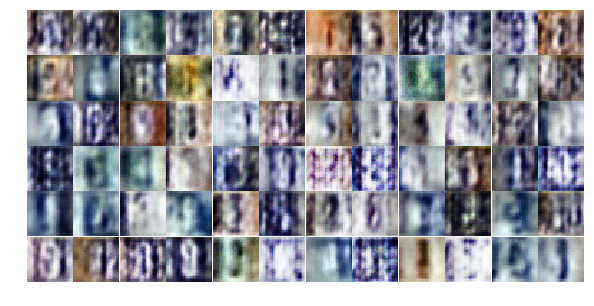

Epoch 2/25... Discriminator Loss: 0.8282... Generator Loss: 1.1653
Epoch 2/25... Discriminator Loss: 1.1013... Generator Loss: 1.0126
Epoch 2/25... Discriminator Loss: 1.1305... Generator Loss: 0.6275
Epoch 2/25... Discriminator Loss: 0.9773... Generator Loss: 1.1844
Epoch 3/25... Discriminator Loss: 0.6474... Generator Loss: 1.8882
Epoch 3/25... Discriminator Loss: 1.0742... Generator Loss: 0.7331
Epoch 3/25... Discriminator Loss: 0.8873... Generator Loss: 1.3910
Epoch 3/25... Discriminator Loss: 0.7906... Generator Loss: 1.1168
Epoch 3/25... Discriminator Loss: 0.7307... Generator Loss: 1.5467
Epoch 3/25... Discriminator Loss: 1.0169... Generator Loss: 1.0446


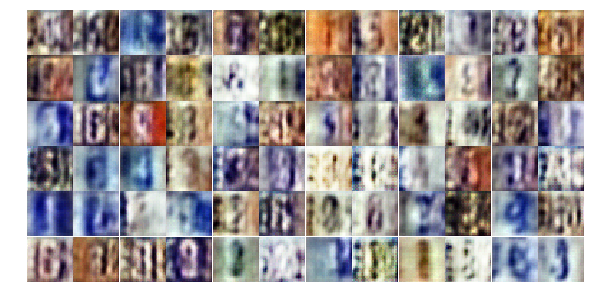

Epoch 3/25... Discriminator Loss: 0.8223... Generator Loss: 1.4515
Epoch 3/25... Discriminator Loss: 0.8731... Generator Loss: 1.1977
Epoch 3/25... Discriminator Loss: 1.0669... Generator Loss: 0.6594
Epoch 3/25... Discriminator Loss: 0.5482... Generator Loss: 1.5893
Epoch 3/25... Discriminator Loss: 0.8178... Generator Loss: 1.1880
Epoch 3/25... Discriminator Loss: 1.2961... Generator Loss: 0.5466
Epoch 3/25... Discriminator Loss: 0.9081... Generator Loss: 1.2374
Epoch 3/25... Discriminator Loss: 0.6797... Generator Loss: 1.3956
Epoch 3/25... Discriminator Loss: 0.9864... Generator Loss: 0.6182
Epoch 3/25... Discriminator Loss: 0.7565... Generator Loss: 0.9680


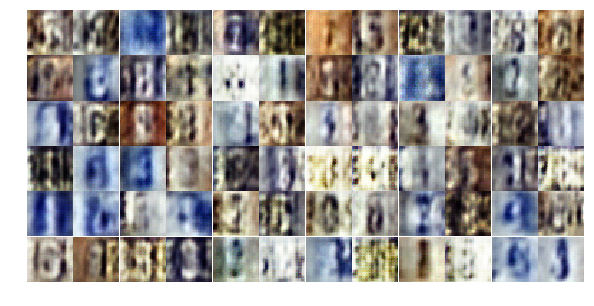

Epoch 3/25... Discriminator Loss: 0.9389... Generator Loss: 1.3291
Epoch 3/25... Discriminator Loss: 1.1950... Generator Loss: 0.8314
Epoch 3/25... Discriminator Loss: 0.5252... Generator Loss: 1.6205
Epoch 3/25... Discriminator Loss: 0.8758... Generator Loss: 1.1171
Epoch 3/25... Discriminator Loss: 0.6972... Generator Loss: 1.2996
Epoch 3/25... Discriminator Loss: 0.4755... Generator Loss: 2.3186
Epoch 3/25... Discriminator Loss: 0.7133... Generator Loss: 1.8544
Epoch 3/25... Discriminator Loss: 0.6978... Generator Loss: 1.5019
Epoch 3/25... Discriminator Loss: 0.5567... Generator Loss: 1.5934
Epoch 3/25... Discriminator Loss: 0.6767... Generator Loss: 1.1227


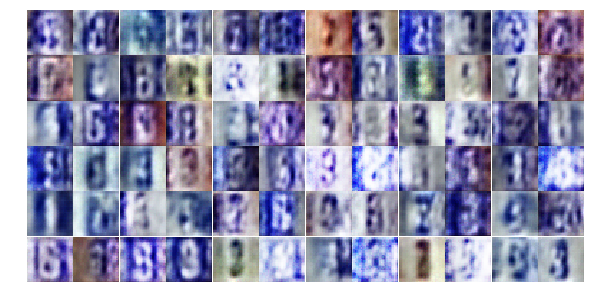

Epoch 3/25... Discriminator Loss: 0.5893... Generator Loss: 1.7476
Epoch 3/25... Discriminator Loss: 0.7264... Generator Loss: 2.0025
Epoch 3/25... Discriminator Loss: 0.6264... Generator Loss: 1.8359
Epoch 3/25... Discriminator Loss: 1.1278... Generator Loss: 0.5520
Epoch 3/25... Discriminator Loss: 0.6660... Generator Loss: 1.4014
Epoch 3/25... Discriminator Loss: 0.5887... Generator Loss: 1.3079
Epoch 3/25... Discriminator Loss: 0.7027... Generator Loss: 1.1161
Epoch 3/25... Discriminator Loss: 0.5885... Generator Loss: 1.7060
Epoch 3/25... Discriminator Loss: 0.4967... Generator Loss: 2.1020
Epoch 3/25... Discriminator Loss: 0.6538... Generator Loss: 0.9982


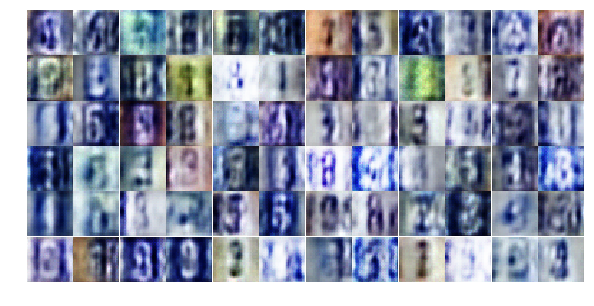

Epoch 3/25... Discriminator Loss: 1.0902... Generator Loss: 3.6200
Epoch 3/25... Discriminator Loss: 0.4531... Generator Loss: 1.6481
Epoch 3/25... Discriminator Loss: 0.5073... Generator Loss: 2.4133
Epoch 3/25... Discriminator Loss: 0.6277... Generator Loss: 1.3491
Epoch 3/25... Discriminator Loss: 0.4655... Generator Loss: 1.8149
Epoch 3/25... Discriminator Loss: 0.4002... Generator Loss: 1.7753
Epoch 3/25... Discriminator Loss: 0.5757... Generator Loss: 1.1981
Epoch 3/25... Discriminator Loss: 0.7487... Generator Loss: 0.9677
Epoch 3/25... Discriminator Loss: 0.6293... Generator Loss: 1.7550
Epoch 3/25... Discriminator Loss: 0.5889... Generator Loss: 1.3080


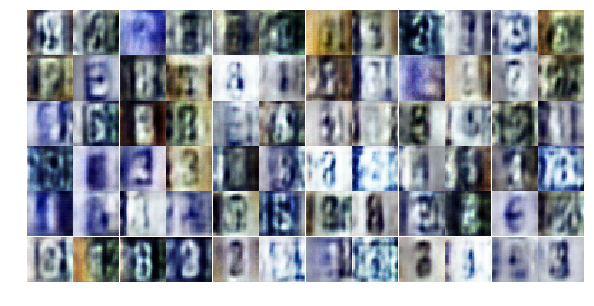

Epoch 3/25... Discriminator Loss: 1.3527... Generator Loss: 1.2456
Epoch 3/25... Discriminator Loss: 1.0488... Generator Loss: 1.0157
Epoch 3/25... Discriminator Loss: 0.9148... Generator Loss: 0.7914
Epoch 3/25... Discriminator Loss: 0.8225... Generator Loss: 0.8314
Epoch 3/25... Discriminator Loss: 0.5200... Generator Loss: 1.9628
Epoch 3/25... Discriminator Loss: 0.4235... Generator Loss: 1.7693
Epoch 3/25... Discriminator Loss: 0.6821... Generator Loss: 2.9631
Epoch 3/25... Discriminator Loss: 0.3767... Generator Loss: 2.6367
Epoch 3/25... Discriminator Loss: 0.3498... Generator Loss: 2.2766
Epoch 3/25... Discriminator Loss: 0.5082... Generator Loss: 1.7980


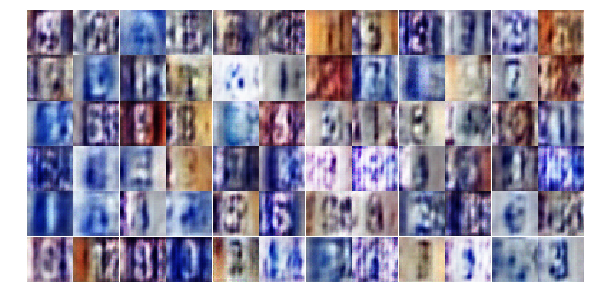

Epoch 3/25... Discriminator Loss: 0.3703... Generator Loss: 2.4616
Epoch 4/25... Discriminator Loss: 0.6612... Generator Loss: 1.0206
Epoch 4/25... Discriminator Loss: 0.5435... Generator Loss: 1.4420
Epoch 4/25... Discriminator Loss: 0.9014... Generator Loss: 0.7289
Epoch 4/25... Discriminator Loss: 0.9544... Generator Loss: 1.2971
Epoch 4/25... Discriminator Loss: 0.3399... Generator Loss: 2.4423
Epoch 4/25... Discriminator Loss: 0.8735... Generator Loss: 2.3452
Epoch 4/25... Discriminator Loss: 0.7619... Generator Loss: 0.9418
Epoch 4/25... Discriminator Loss: 0.4622... Generator Loss: 1.4781
Epoch 4/25... Discriminator Loss: 0.4244... Generator Loss: 1.8612


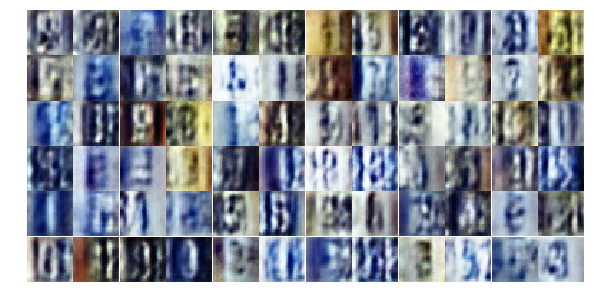

Epoch 4/25... Discriminator Loss: 0.3806... Generator Loss: 1.7532
Epoch 4/25... Discriminator Loss: 0.5948... Generator Loss: 1.1333
Epoch 4/25... Discriminator Loss: 0.4538... Generator Loss: 1.5946
Epoch 4/25... Discriminator Loss: 0.3841... Generator Loss: 2.1519
Epoch 4/25... Discriminator Loss: 1.0268... Generator Loss: 2.5258
Epoch 4/25... Discriminator Loss: 1.7008... Generator Loss: 0.2933
Epoch 4/25... Discriminator Loss: 0.6755... Generator Loss: 1.2054
Epoch 4/25... Discriminator Loss: 0.5486... Generator Loss: 1.4018
Epoch 4/25... Discriminator Loss: 0.6912... Generator Loss: 2.0887
Epoch 4/25... Discriminator Loss: 0.9291... Generator Loss: 2.5629


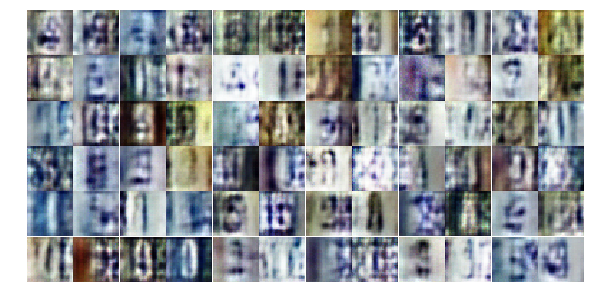

Epoch 4/25... Discriminator Loss: 0.5046... Generator Loss: 1.4833
Epoch 4/25... Discriminator Loss: 0.3771... Generator Loss: 2.2674
Epoch 4/25... Discriminator Loss: 0.4539... Generator Loss: 1.6014
Epoch 4/25... Discriminator Loss: 0.7927... Generator Loss: 1.1703
Epoch 4/25... Discriminator Loss: 0.4225... Generator Loss: 1.8680
Epoch 4/25... Discriminator Loss: 0.5173... Generator Loss: 2.5540
Epoch 4/25... Discriminator Loss: 0.5293... Generator Loss: 1.5353
Epoch 4/25... Discriminator Loss: 0.7133... Generator Loss: 1.0721
Epoch 4/25... Discriminator Loss: 0.4223... Generator Loss: 2.0018
Epoch 4/25... Discriminator Loss: 0.5830... Generator Loss: 1.6570


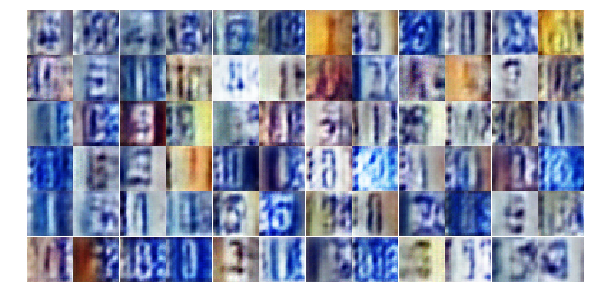

Epoch 4/25... Discriminator Loss: 0.3994... Generator Loss: 1.6724
Epoch 4/25... Discriminator Loss: 0.3242... Generator Loss: 2.0729
Epoch 4/25... Discriminator Loss: 0.8445... Generator Loss: 0.8049
Epoch 4/25... Discriminator Loss: 0.6891... Generator Loss: 2.1880
Epoch 4/25... Discriminator Loss: 0.4618... Generator Loss: 2.2229
Epoch 4/25... Discriminator Loss: 0.3721... Generator Loss: 1.7998
Epoch 4/25... Discriminator Loss: 1.3360... Generator Loss: 0.4346
Epoch 4/25... Discriminator Loss: 0.6562... Generator Loss: 1.1628
Epoch 4/25... Discriminator Loss: 0.7827... Generator Loss: 0.8166
Epoch 4/25... Discriminator Loss: 1.1396... Generator Loss: 0.5605


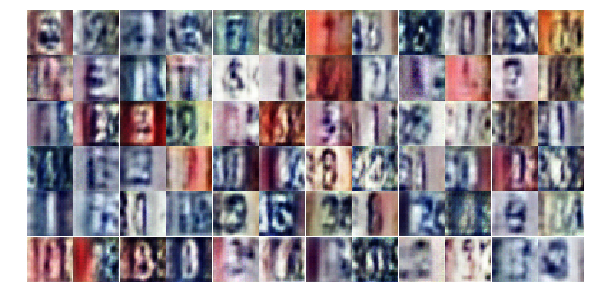

Epoch 4/25... Discriminator Loss: 0.4746... Generator Loss: 2.1906
Epoch 4/25... Discriminator Loss: 0.3157... Generator Loss: 1.9320
Epoch 4/25... Discriminator Loss: 0.6558... Generator Loss: 1.0452
Epoch 4/25... Discriminator Loss: 0.4188... Generator Loss: 2.4877
Epoch 4/25... Discriminator Loss: 0.3717... Generator Loss: 1.7565
Epoch 4/25... Discriminator Loss: 1.2961... Generator Loss: 0.4934
Epoch 4/25... Discriminator Loss: 0.5448... Generator Loss: 1.5818
Epoch 4/25... Discriminator Loss: 1.0061... Generator Loss: 0.8235
Epoch 4/25... Discriminator Loss: 0.5080... Generator Loss: 1.5572
Epoch 4/25... Discriminator Loss: 0.4693... Generator Loss: 1.7515


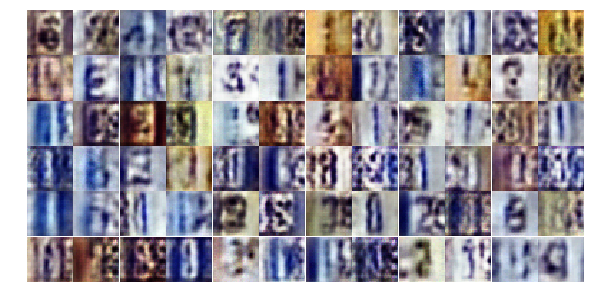

Epoch 4/25... Discriminator Loss: 0.4426... Generator Loss: 1.5596
Epoch 4/25... Discriminator Loss: 0.5492... Generator Loss: 1.9175
Epoch 4/25... Discriminator Loss: 0.7299... Generator Loss: 0.9049
Epoch 4/25... Discriminator Loss: 0.5338... Generator Loss: 1.3438
Epoch 4/25... Discriminator Loss: 0.9700... Generator Loss: 0.7817
Epoch 4/25... Discriminator Loss: 0.7146... Generator Loss: 1.9399
Epoch 4/25... Discriminator Loss: 0.7083... Generator Loss: 0.9642
Epoch 4/25... Discriminator Loss: 0.6689... Generator Loss: 1.0073
Epoch 4/25... Discriminator Loss: 0.3901... Generator Loss: 2.2354
Epoch 5/25... Discriminator Loss: 0.4009... Generator Loss: 2.1551


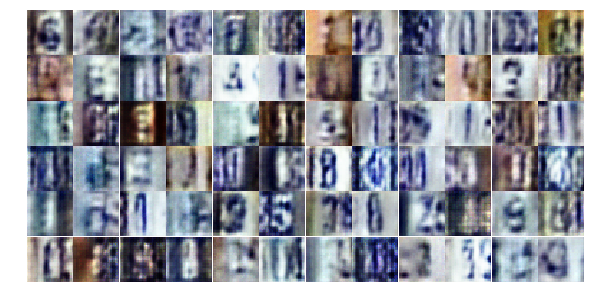

Epoch 5/25... Discriminator Loss: 0.9719... Generator Loss: 0.7204
Epoch 5/25... Discriminator Loss: 0.4856... Generator Loss: 1.5081
Epoch 5/25... Discriminator Loss: 0.6297... Generator Loss: 1.0109
Epoch 5/25... Discriminator Loss: 0.3421... Generator Loss: 2.8990
Epoch 5/25... Discriminator Loss: 1.0631... Generator Loss: 2.8430
Epoch 5/25... Discriminator Loss: 0.9571... Generator Loss: 0.7248
Epoch 5/25... Discriminator Loss: 0.7166... Generator Loss: 0.9379
Epoch 5/25... Discriminator Loss: 0.4735... Generator Loss: 1.3943
Epoch 5/25... Discriminator Loss: 0.5685... Generator Loss: 1.2530
Epoch 5/25... Discriminator Loss: 0.9909... Generator Loss: 0.6444


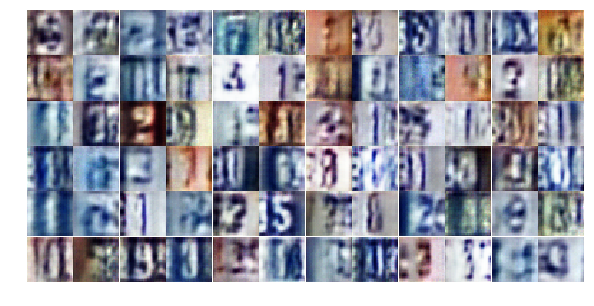

Epoch 5/25... Discriminator Loss: 0.6960... Generator Loss: 2.4521
Epoch 5/25... Discriminator Loss: 0.4272... Generator Loss: 1.6090
Epoch 5/25... Discriminator Loss: 0.4361... Generator Loss: 1.4889
Epoch 5/25... Discriminator Loss: 0.9103... Generator Loss: 0.6910
Epoch 5/25... Discriminator Loss: 0.7553... Generator Loss: 2.2749
Epoch 5/25... Discriminator Loss: 1.1660... Generator Loss: 2.7327
Epoch 5/25... Discriminator Loss: 0.4287... Generator Loss: 1.6892
Epoch 5/25... Discriminator Loss: 0.9949... Generator Loss: 0.7063
Epoch 5/25... Discriminator Loss: 0.3705... Generator Loss: 1.6899
Epoch 5/25... Discriminator Loss: 0.5340... Generator Loss: 1.4123


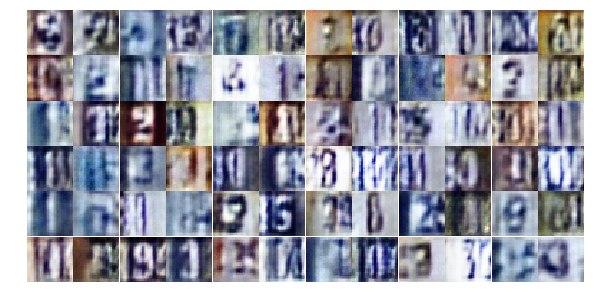

Epoch 5/25... Discriminator Loss: 0.4123... Generator Loss: 1.6875
Epoch 5/25... Discriminator Loss: 1.0657... Generator Loss: 0.6153
Epoch 5/25... Discriminator Loss: 0.5552... Generator Loss: 1.1614
Epoch 5/25... Discriminator Loss: 0.6377... Generator Loss: 1.1592
Epoch 5/25... Discriminator Loss: 0.5800... Generator Loss: 1.1228
Epoch 5/25... Discriminator Loss: 0.9205... Generator Loss: 0.6849
Epoch 5/25... Discriminator Loss: 1.3101... Generator Loss: 0.5390
Epoch 5/25... Discriminator Loss: 0.6966... Generator Loss: 1.2760
Epoch 5/25... Discriminator Loss: 1.0233... Generator Loss: 0.6377
Epoch 5/25... Discriminator Loss: 0.4893... Generator Loss: 1.5572


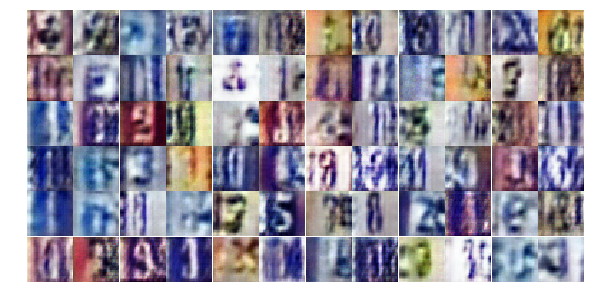

Epoch 5/25... Discriminator Loss: 0.8410... Generator Loss: 0.7815
Epoch 5/25... Discriminator Loss: 0.7278... Generator Loss: 0.9039
Epoch 5/25... Discriminator Loss: 0.8158... Generator Loss: 0.7990
Epoch 5/25... Discriminator Loss: 0.5847... Generator Loss: 1.1285
Epoch 5/25... Discriminator Loss: 1.7065... Generator Loss: 0.3174
Epoch 5/25... Discriminator Loss: 0.8789... Generator Loss: 2.8231
Epoch 5/25... Discriminator Loss: 0.8335... Generator Loss: 0.8364
Epoch 5/25... Discriminator Loss: 0.5482... Generator Loss: 1.2996
Epoch 5/25... Discriminator Loss: 0.7775... Generator Loss: 0.9535
Epoch 5/25... Discriminator Loss: 0.5474... Generator Loss: 1.3351


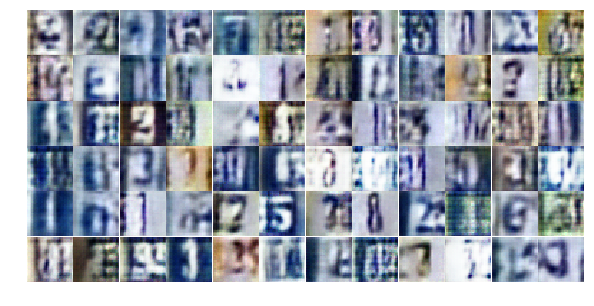

Epoch 5/25... Discriminator Loss: 0.4149... Generator Loss: 1.9163
Epoch 5/25... Discriminator Loss: 0.5790... Generator Loss: 1.2666
Epoch 5/25... Discriminator Loss: 1.4619... Generator Loss: 0.3366
Epoch 5/25... Discriminator Loss: 0.6760... Generator Loss: 1.5908
Epoch 5/25... Discriminator Loss: 0.6314... Generator Loss: 1.8773
Epoch 5/25... Discriminator Loss: 0.7180... Generator Loss: 0.9874
Epoch 5/25... Discriminator Loss: 0.9718... Generator Loss: 0.6403
Epoch 5/25... Discriminator Loss: 0.9263... Generator Loss: 0.6756
Epoch 5/25... Discriminator Loss: 0.5936... Generator Loss: 1.1310
Epoch 5/25... Discriminator Loss: 0.6971... Generator Loss: 3.2555


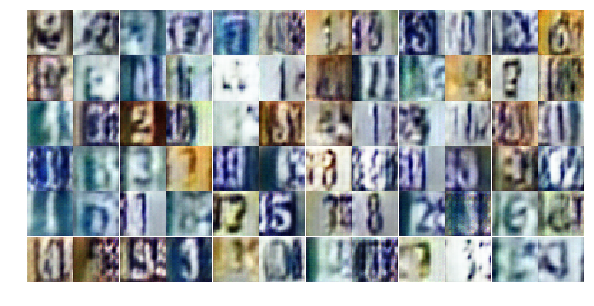

Epoch 5/25... Discriminator Loss: 1.7724... Generator Loss: 0.2496
Epoch 5/25... Discriminator Loss: 0.5647... Generator Loss: 1.4696
Epoch 5/25... Discriminator Loss: 0.8441... Generator Loss: 0.7253
Epoch 5/25... Discriminator Loss: 0.5512... Generator Loss: 1.2416
Epoch 5/25... Discriminator Loss: 0.8255... Generator Loss: 0.9763
Epoch 5/25... Discriminator Loss: 1.0561... Generator Loss: 0.6470
Epoch 6/25... Discriminator Loss: 0.7044... Generator Loss: 0.9249
Epoch 6/25... Discriminator Loss: 0.4870... Generator Loss: 1.3044
Epoch 6/25... Discriminator Loss: 0.8797... Generator Loss: 0.6962
Epoch 6/25... Discriminator Loss: 0.6723... Generator Loss: 1.1174


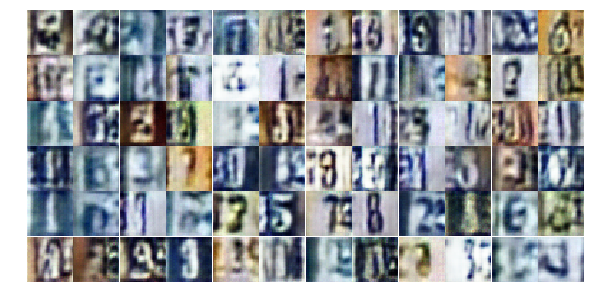

Epoch 6/25... Discriminator Loss: 1.2981... Generator Loss: 0.4879
Epoch 6/25... Discriminator Loss: 0.6126... Generator Loss: 1.8941
Epoch 6/25... Discriminator Loss: 0.7327... Generator Loss: 0.9135
Epoch 6/25... Discriminator Loss: 0.9521... Generator Loss: 0.7160
Epoch 6/25... Discriminator Loss: 0.9303... Generator Loss: 0.6414
Epoch 6/25... Discriminator Loss: 0.9294... Generator Loss: 0.6683
Epoch 6/25... Discriminator Loss: 0.5995... Generator Loss: 1.8909
Epoch 6/25... Discriminator Loss: 0.9068... Generator Loss: 0.7317
Epoch 6/25... Discriminator Loss: 0.7061... Generator Loss: 0.8881
Epoch 6/25... Discriminator Loss: 0.8400... Generator Loss: 2.6608


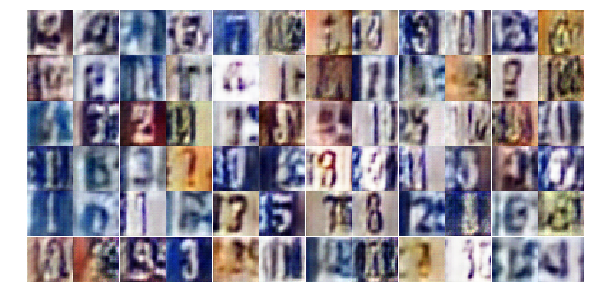

Epoch 6/25... Discriminator Loss: 0.5707... Generator Loss: 1.4081
Epoch 6/25... Discriminator Loss: 0.5188... Generator Loss: 1.4744
Epoch 6/25... Discriminator Loss: 1.2612... Generator Loss: 0.4294
Epoch 6/25... Discriminator Loss: 0.6982... Generator Loss: 0.8924
Epoch 6/25... Discriminator Loss: 0.4693... Generator Loss: 2.3174
Epoch 6/25... Discriminator Loss: 0.6003... Generator Loss: 1.0779
Epoch 6/25... Discriminator Loss: 0.6376... Generator Loss: 1.4552
Epoch 6/25... Discriminator Loss: 0.6771... Generator Loss: 1.4618
Epoch 6/25... Discriminator Loss: 1.2972... Generator Loss: 0.4965
Epoch 6/25... Discriminator Loss: 0.8501... Generator Loss: 0.8048


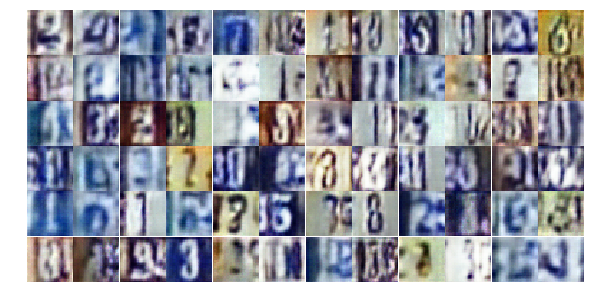

Epoch 6/25... Discriminator Loss: 0.7790... Generator Loss: 0.9149
Epoch 6/25... Discriminator Loss: 0.5960... Generator Loss: 1.6161
Epoch 6/25... Discriminator Loss: 1.8605... Generator Loss: 0.2519
Epoch 6/25... Discriminator Loss: 1.1068... Generator Loss: 0.5401
Epoch 6/25... Discriminator Loss: 0.5011... Generator Loss: 1.6892
Epoch 6/25... Discriminator Loss: 0.8893... Generator Loss: 0.8445
Epoch 6/25... Discriminator Loss: 0.6233... Generator Loss: 1.6260
Epoch 6/25... Discriminator Loss: 0.3889... Generator Loss: 1.5189
Epoch 6/25... Discriminator Loss: 0.6157... Generator Loss: 1.1913
Epoch 6/25... Discriminator Loss: 0.5005... Generator Loss: 1.7758


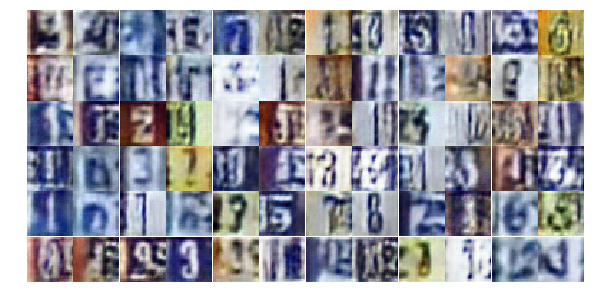

Epoch 6/25... Discriminator Loss: 0.6370... Generator Loss: 1.1890
Epoch 6/25... Discriminator Loss: 0.9093... Generator Loss: 0.6932
Epoch 6/25... Discriminator Loss: 1.0878... Generator Loss: 0.5548
Epoch 6/25... Discriminator Loss: 0.4768... Generator Loss: 1.5525
Epoch 6/25... Discriminator Loss: 0.8372... Generator Loss: 0.7786
Epoch 6/25... Discriminator Loss: 0.6311... Generator Loss: 1.0925
Epoch 6/25... Discriminator Loss: 0.5016... Generator Loss: 1.2542
Epoch 6/25... Discriminator Loss: 0.3386... Generator Loss: 2.0609
Epoch 6/25... Discriminator Loss: 0.6270... Generator Loss: 1.2591
Epoch 6/25... Discriminator Loss: 0.3051... Generator Loss: 1.7994


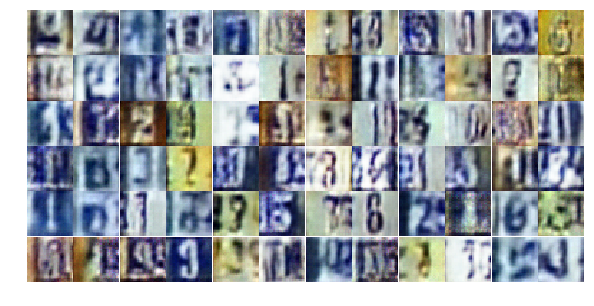

Epoch 6/25... Discriminator Loss: 1.3024... Generator Loss: 2.9064
Epoch 6/25... Discriminator Loss: 0.7080... Generator Loss: 0.9054
Epoch 6/25... Discriminator Loss: 0.7426... Generator Loss: 1.0715
Epoch 6/25... Discriminator Loss: 0.7311... Generator Loss: 1.0366
Epoch 6/25... Discriminator Loss: 0.4634... Generator Loss: 2.4104
Epoch 6/25... Discriminator Loss: 0.5239... Generator Loss: 1.9866
Epoch 6/25... Discriminator Loss: 1.1972... Generator Loss: 0.5646
Epoch 6/25... Discriminator Loss: 0.8425... Generator Loss: 0.9270
Epoch 6/25... Discriminator Loss: 0.5041... Generator Loss: 1.5218
Epoch 6/25... Discriminator Loss: 2.1041... Generator Loss: 0.1899


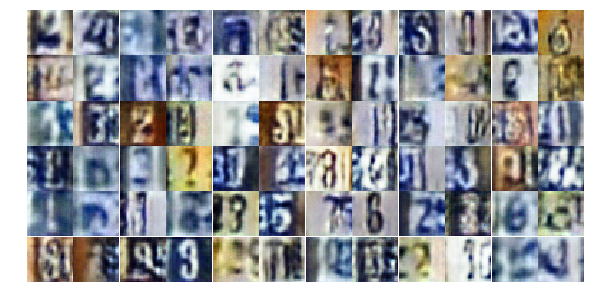

Epoch 6/25... Discriminator Loss: 0.5010... Generator Loss: 1.8945
Epoch 6/25... Discriminator Loss: 0.8512... Generator Loss: 0.7854
Epoch 6/25... Discriminator Loss: 0.4846... Generator Loss: 1.8443
Epoch 7/25... Discriminator Loss: 0.5838... Generator Loss: 1.2128
Epoch 7/25... Discriminator Loss: 1.2011... Generator Loss: 0.5717
Epoch 7/25... Discriminator Loss: 0.4407... Generator Loss: 1.7101
Epoch 7/25... Discriminator Loss: 0.4558... Generator Loss: 1.4082
Epoch 7/25... Discriminator Loss: 0.4718... Generator Loss: 1.3276
Epoch 7/25... Discriminator Loss: 0.3411... Generator Loss: 1.9066
Epoch 7/25... Discriminator Loss: 1.3966... Generator Loss: 3.8879


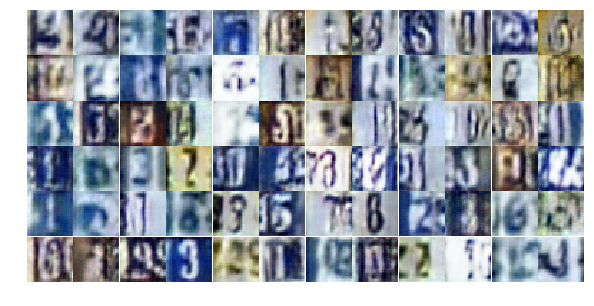

Epoch 7/25... Discriminator Loss: 0.6324... Generator Loss: 2.1164
Epoch 7/25... Discriminator Loss: 0.6911... Generator Loss: 1.0884
Epoch 7/25... Discriminator Loss: 0.7948... Generator Loss: 0.8266
Epoch 7/25... Discriminator Loss: 0.5079... Generator Loss: 1.8754
Epoch 7/25... Discriminator Loss: 0.5929... Generator Loss: 1.2659
Epoch 7/25... Discriminator Loss: 0.4859... Generator Loss: 1.3325
Epoch 7/25... Discriminator Loss: 0.8581... Generator Loss: 2.4510
Epoch 7/25... Discriminator Loss: 1.3939... Generator Loss: 3.7371
Epoch 7/25... Discriminator Loss: 0.4621... Generator Loss: 1.6590
Epoch 7/25... Discriminator Loss: 0.7765... Generator Loss: 0.9822


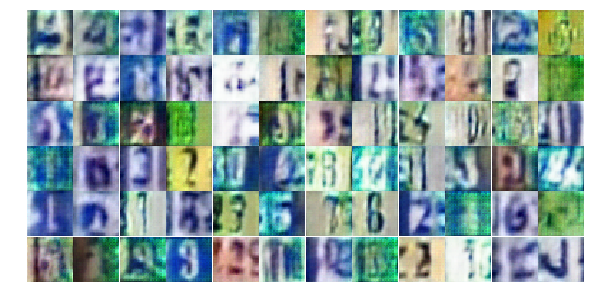

Epoch 7/25... Discriminator Loss: 0.6188... Generator Loss: 1.2366
Epoch 7/25... Discriminator Loss: 0.4514... Generator Loss: 1.6107
Epoch 7/25... Discriminator Loss: 0.5792... Generator Loss: 1.5416
Epoch 7/25... Discriminator Loss: 0.4332... Generator Loss: 1.7368
Epoch 7/25... Discriminator Loss: 0.3831... Generator Loss: 1.6929
Epoch 7/25... Discriminator Loss: 0.5568... Generator Loss: 1.3030
Epoch 7/25... Discriminator Loss: 1.1503... Generator Loss: 0.5357
Epoch 7/25... Discriminator Loss: 2.5054... Generator Loss: 0.1594
Epoch 7/25... Discriminator Loss: 0.5599... Generator Loss: 1.8816
Epoch 7/25... Discriminator Loss: 0.6409... Generator Loss: 1.2039


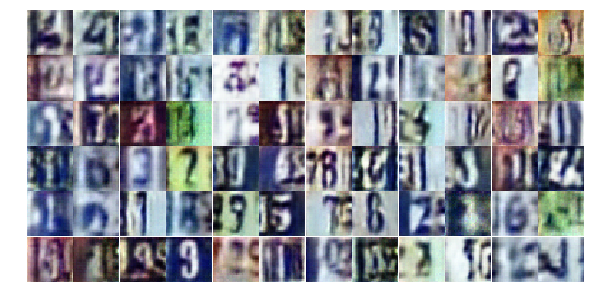

Epoch 7/25... Discriminator Loss: 0.5346... Generator Loss: 1.3501
Epoch 7/25... Discriminator Loss: 0.6172... Generator Loss: 1.2563
Epoch 7/25... Discriminator Loss: 0.4127... Generator Loss: 1.6544
Epoch 7/25... Discriminator Loss: 0.9719... Generator Loss: 0.6988
Epoch 7/25... Discriminator Loss: 0.7903... Generator Loss: 0.8334
Epoch 7/25... Discriminator Loss: 0.9319... Generator Loss: 0.7200
Epoch 7/25... Discriminator Loss: 0.3226... Generator Loss: 2.2280
Epoch 7/25... Discriminator Loss: 1.0373... Generator Loss: 0.5710
Epoch 7/25... Discriminator Loss: 1.0075... Generator Loss: 0.6358
Epoch 7/25... Discriminator Loss: 0.5657... Generator Loss: 1.7010


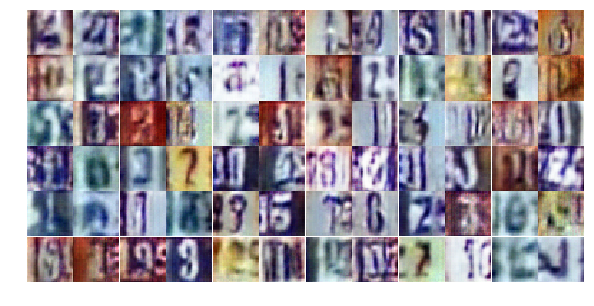

Epoch 7/25... Discriminator Loss: 1.3900... Generator Loss: 0.5959
Epoch 7/25... Discriminator Loss: 0.8343... Generator Loss: 0.9417
Epoch 7/25... Discriminator Loss: 0.5100... Generator Loss: 1.5694
Epoch 7/25... Discriminator Loss: 0.6173... Generator Loss: 1.5124
Epoch 7/25... Discriminator Loss: 0.6841... Generator Loss: 1.3055
Epoch 7/25... Discriminator Loss: 0.4092... Generator Loss: 1.6667
Epoch 7/25... Discriminator Loss: 0.9070... Generator Loss: 0.6879
Epoch 7/25... Discriminator Loss: 1.4527... Generator Loss: 2.9065
Epoch 7/25... Discriminator Loss: 0.3322... Generator Loss: 2.2380
Epoch 7/25... Discriminator Loss: 0.7899... Generator Loss: 1.1241


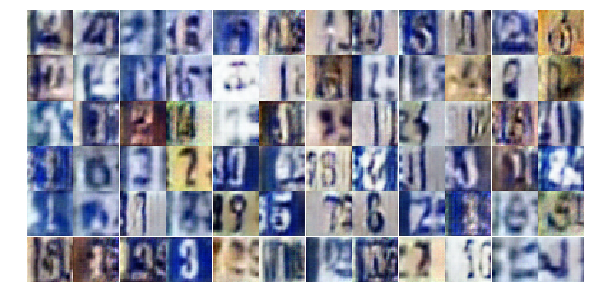

Epoch 7/25... Discriminator Loss: 0.3981... Generator Loss: 2.2807
Epoch 7/25... Discriminator Loss: 0.5862... Generator Loss: 1.2756
Epoch 7/25... Discriminator Loss: 0.5723... Generator Loss: 1.8526
Epoch 7/25... Discriminator Loss: 1.0266... Generator Loss: 0.7102
Epoch 7/25... Discriminator Loss: 0.4907... Generator Loss: 1.6308
Epoch 7/25... Discriminator Loss: 0.4366... Generator Loss: 1.6336
Epoch 7/25... Discriminator Loss: 1.5242... Generator Loss: 0.3190
Epoch 7/25... Discriminator Loss: 0.3953... Generator Loss: 3.2727
Epoch 7/25... Discriminator Loss: 0.6101... Generator Loss: 2.0751
Epoch 7/25... Discriminator Loss: 0.8461... Generator Loss: 0.8504


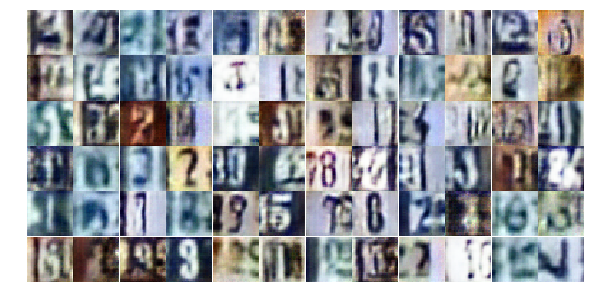

Epoch 7/25... Discriminator Loss: 0.5429... Generator Loss: 1.5911
Epoch 8/25... Discriminator Loss: 0.5890... Generator Loss: 1.0958
Epoch 8/25... Discriminator Loss: 0.5971... Generator Loss: 1.0570
Epoch 8/25... Discriminator Loss: 0.6978... Generator Loss: 1.1196
Epoch 8/25... Discriminator Loss: 0.4878... Generator Loss: 1.6695
Epoch 8/25... Discriminator Loss: 0.7748... Generator Loss: 0.8766
Epoch 8/25... Discriminator Loss: 0.6244... Generator Loss: 1.0953
Epoch 8/25... Discriminator Loss: 0.4797... Generator Loss: 2.1789
Epoch 8/25... Discriminator Loss: 0.7497... Generator Loss: 0.8780
Epoch 8/25... Discriminator Loss: 0.5567... Generator Loss: 1.1526


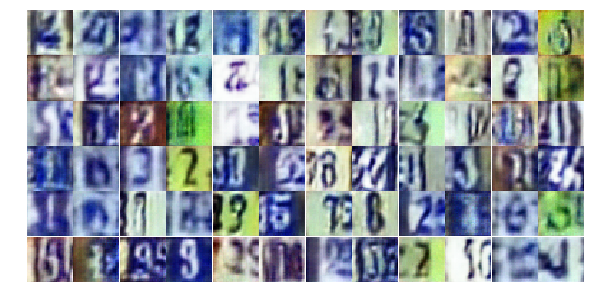

Epoch 8/25... Discriminator Loss: 0.3309... Generator Loss: 1.8796
Epoch 8/25... Discriminator Loss: 0.3871... Generator Loss: 2.0095
Epoch 8/25... Discriminator Loss: 1.1135... Generator Loss: 0.5789
Epoch 8/25... Discriminator Loss: 0.7866... Generator Loss: 2.9037
Epoch 8/25... Discriminator Loss: 1.4590... Generator Loss: 0.4303
Epoch 8/25... Discriminator Loss: 0.8958... Generator Loss: 2.0494
Epoch 8/25... Discriminator Loss: 0.5079... Generator Loss: 1.8936
Epoch 8/25... Discriminator Loss: 0.4144... Generator Loss: 1.8083
Epoch 8/25... Discriminator Loss: 0.6567... Generator Loss: 1.7778
Epoch 8/25... Discriminator Loss: 1.0794... Generator Loss: 0.5955


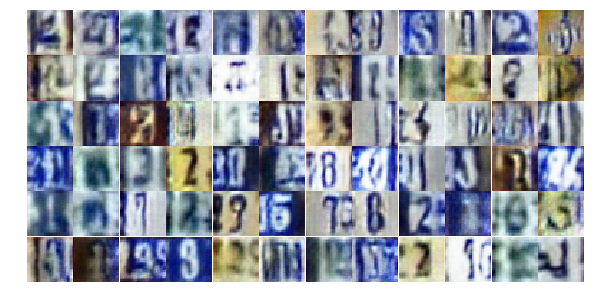

Epoch 8/25... Discriminator Loss: 0.5830... Generator Loss: 1.5705
Epoch 8/25... Discriminator Loss: 0.6670... Generator Loss: 1.3297
Epoch 8/25... Discriminator Loss: 0.7065... Generator Loss: 0.9275
Epoch 8/25... Discriminator Loss: 0.6179... Generator Loss: 1.1408
Epoch 8/25... Discriminator Loss: 0.4306... Generator Loss: 1.6429
Epoch 8/25... Discriminator Loss: 0.7279... Generator Loss: 1.3943
Epoch 8/25... Discriminator Loss: 0.5970... Generator Loss: 1.2588
Epoch 8/25... Discriminator Loss: 0.5576... Generator Loss: 1.1990
Epoch 8/25... Discriminator Loss: 0.6928... Generator Loss: 1.0798
Epoch 8/25... Discriminator Loss: 0.5821... Generator Loss: 1.2383


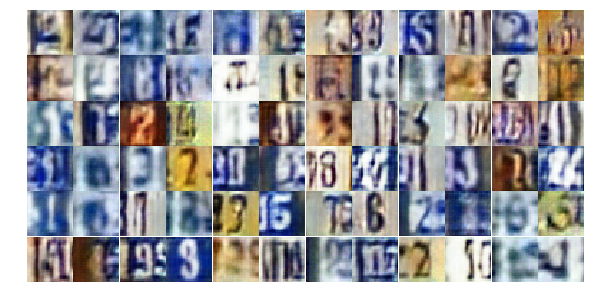

Epoch 8/25... Discriminator Loss: 0.6172... Generator Loss: 1.1923
Epoch 8/25... Discriminator Loss: 1.2087... Generator Loss: 0.4492
Epoch 8/25... Discriminator Loss: 0.4859... Generator Loss: 1.4653
Epoch 8/25... Discriminator Loss: 0.4484... Generator Loss: 1.5543
Epoch 8/25... Discriminator Loss: 0.5893... Generator Loss: 1.3136
Epoch 8/25... Discriminator Loss: 0.7648... Generator Loss: 0.8384
Epoch 8/25... Discriminator Loss: 0.6104... Generator Loss: 1.6125
Epoch 8/25... Discriminator Loss: 0.5189... Generator Loss: 1.3368
Epoch 8/25... Discriminator Loss: 0.6388... Generator Loss: 1.1149
Epoch 8/25... Discriminator Loss: 0.3584... Generator Loss: 1.6927


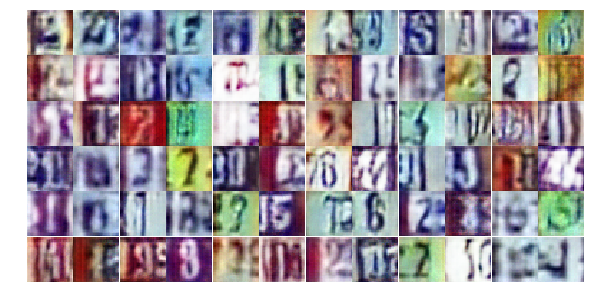

Epoch 8/25... Discriminator Loss: 0.4076... Generator Loss: 2.2649
Epoch 8/25... Discriminator Loss: 1.1041... Generator Loss: 0.5941
Epoch 8/25... Discriminator Loss: 0.7269... Generator Loss: 0.8741
Epoch 8/25... Discriminator Loss: 0.6386... Generator Loss: 2.1741
Epoch 8/25... Discriminator Loss: 0.6233... Generator Loss: 1.6283
Epoch 8/25... Discriminator Loss: 1.2750... Generator Loss: 0.4573
Epoch 8/25... Discriminator Loss: 0.7663... Generator Loss: 0.9589
Epoch 8/25... Discriminator Loss: 0.4877... Generator Loss: 2.3310
Epoch 8/25... Discriminator Loss: 0.5656... Generator Loss: 1.4599
Epoch 8/25... Discriminator Loss: 0.8649... Generator Loss: 0.8047


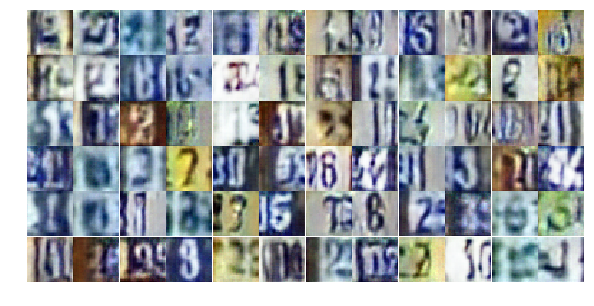

Epoch 8/25... Discriminator Loss: 0.4200... Generator Loss: 1.5903
Epoch 8/25... Discriminator Loss: 0.1511... Generator Loss: 2.9572
Epoch 8/25... Discriminator Loss: 0.5613... Generator Loss: 2.6576
Epoch 8/25... Discriminator Loss: 0.8593... Generator Loss: 0.9334
Epoch 8/25... Discriminator Loss: 0.5829... Generator Loss: 2.6973
Epoch 8/25... Discriminator Loss: 0.7461... Generator Loss: 1.3291
Epoch 8/25... Discriminator Loss: 0.5002... Generator Loss: 1.2818
Epoch 8/25... Discriminator Loss: 0.5048... Generator Loss: 1.7099
Epoch 9/25... Discriminator Loss: 0.7091... Generator Loss: 1.1918
Epoch 9/25... Discriminator Loss: 0.6967... Generator Loss: 0.9362


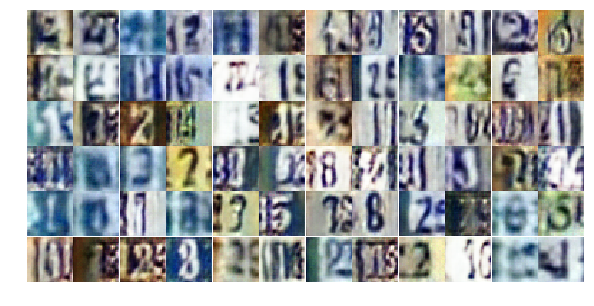

Epoch 9/25... Discriminator Loss: 0.5449... Generator Loss: 1.2231
Epoch 9/25... Discriminator Loss: 0.5219... Generator Loss: 1.4145
Epoch 9/25... Discriminator Loss: 0.7578... Generator Loss: 0.9247
Epoch 9/25... Discriminator Loss: 0.4949... Generator Loss: 1.3499
Epoch 9/25... Discriminator Loss: 0.8060... Generator Loss: 0.7906
Epoch 9/25... Discriminator Loss: 0.3824... Generator Loss: 2.6838
Epoch 9/25... Discriminator Loss: 0.8384... Generator Loss: 0.8096
Epoch 9/25... Discriminator Loss: 0.4322... Generator Loss: 1.5692
Epoch 9/25... Discriminator Loss: 0.9850... Generator Loss: 0.6782
Epoch 9/25... Discriminator Loss: 0.6971... Generator Loss: 1.3786


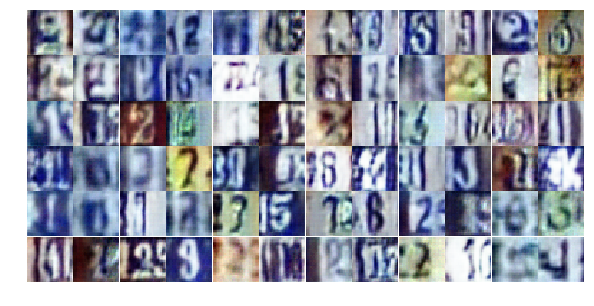

Epoch 9/25... Discriminator Loss: 0.6589... Generator Loss: 1.1668
Epoch 9/25... Discriminator Loss: 1.3214... Generator Loss: 0.4551
Epoch 9/25... Discriminator Loss: 0.6035... Generator Loss: 1.4271
Epoch 9/25... Discriminator Loss: 0.6895... Generator Loss: 1.3141
Epoch 9/25... Discriminator Loss: 0.4834... Generator Loss: 1.5225
Epoch 9/25... Discriminator Loss: 0.7503... Generator Loss: 0.8844
Epoch 9/25... Discriminator Loss: 1.0180... Generator Loss: 0.6530
Epoch 9/25... Discriminator Loss: 0.3863... Generator Loss: 1.6434
Epoch 9/25... Discriminator Loss: 1.3206... Generator Loss: 0.4141
Epoch 9/25... Discriminator Loss: 0.9729... Generator Loss: 0.6717


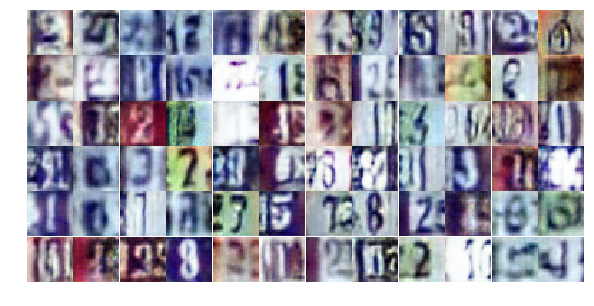

Epoch 9/25... Discriminator Loss: 1.3569... Generator Loss: 0.4327
Epoch 9/25... Discriminator Loss: 0.5338... Generator Loss: 1.5412
Epoch 9/25... Discriminator Loss: 0.5900... Generator Loss: 1.2485
Epoch 9/25... Discriminator Loss: 0.7690... Generator Loss: 0.8736
Epoch 9/25... Discriminator Loss: 0.5927... Generator Loss: 1.1567
Epoch 9/25... Discriminator Loss: 0.4773... Generator Loss: 1.3647
Epoch 9/25... Discriminator Loss: 0.6263... Generator Loss: 1.0636
Epoch 9/25... Discriminator Loss: 0.5473... Generator Loss: 1.4582
Epoch 9/25... Discriminator Loss: 0.4900... Generator Loss: 1.3228
Epoch 9/25... Discriminator Loss: 0.5717... Generator Loss: 1.0506


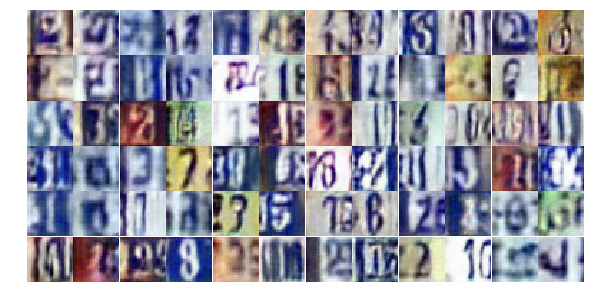

Epoch 9/25... Discriminator Loss: 0.4284... Generator Loss: 1.4261
Epoch 9/25... Discriminator Loss: 0.5090... Generator Loss: 1.3397
Epoch 9/25... Discriminator Loss: 0.5412... Generator Loss: 1.2642
Epoch 9/25... Discriminator Loss: 0.5419... Generator Loss: 1.2032
Epoch 9/25... Discriminator Loss: 1.7330... Generator Loss: 4.6118
Epoch 9/25... Discriminator Loss: 1.7752... Generator Loss: 0.3038
Epoch 9/25... Discriminator Loss: 0.6504... Generator Loss: 1.4848
Epoch 9/25... Discriminator Loss: 0.4467... Generator Loss: 1.8520
Epoch 9/25... Discriminator Loss: 0.7674... Generator Loss: 0.9848
Epoch 9/25... Discriminator Loss: 0.7557... Generator Loss: 0.8504


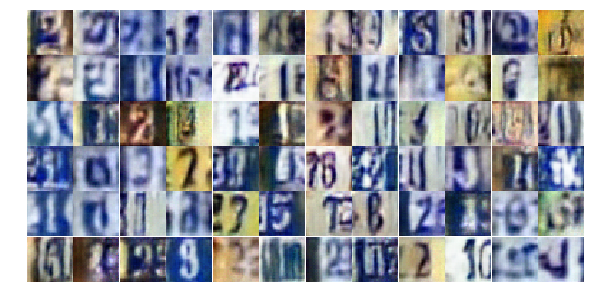

Epoch 9/25... Discriminator Loss: 0.5497... Generator Loss: 1.3488
Epoch 9/25... Discriminator Loss: 0.6025... Generator Loss: 1.0622
Epoch 9/25... Discriminator Loss: 0.7709... Generator Loss: 0.9415
Epoch 9/25... Discriminator Loss: 0.6681... Generator Loss: 1.1860
Epoch 9/25... Discriminator Loss: 0.4122... Generator Loss: 1.6538
Epoch 9/25... Discriminator Loss: 0.7357... Generator Loss: 0.9950
Epoch 9/25... Discriminator Loss: 0.7813... Generator Loss: 0.8712
Epoch 9/25... Discriminator Loss: 0.6992... Generator Loss: 0.9742
Epoch 9/25... Discriminator Loss: 0.5781... Generator Loss: 1.1208
Epoch 9/25... Discriminator Loss: 0.6976... Generator Loss: 1.9674


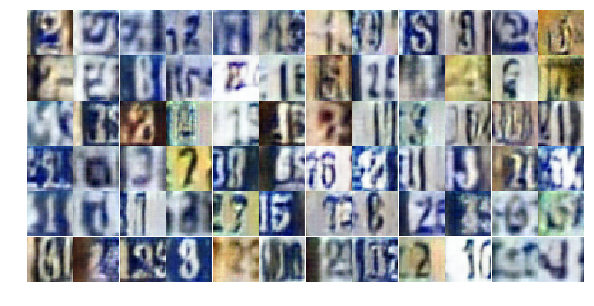

Epoch 9/25... Discriminator Loss: 0.5215... Generator Loss: 1.2565
Epoch 9/25... Discriminator Loss: 0.6605... Generator Loss: 1.1029
Epoch 9/25... Discriminator Loss: 0.8427... Generator Loss: 0.8448
Epoch 9/25... Discriminator Loss: 0.7315... Generator Loss: 0.8962
Epoch 9/25... Discriminator Loss: 0.8557... Generator Loss: 0.7868
Epoch 10/25... Discriminator Loss: 1.1202... Generator Loss: 0.5520
Epoch 10/25... Discriminator Loss: 0.5304... Generator Loss: 1.3178
Epoch 10/25... Discriminator Loss: 0.8960... Generator Loss: 0.7064
Epoch 10/25... Discriminator Loss: 0.6744... Generator Loss: 1.0001
Epoch 10/25... Discriminator Loss: 0.9844... Generator Loss: 0.7083


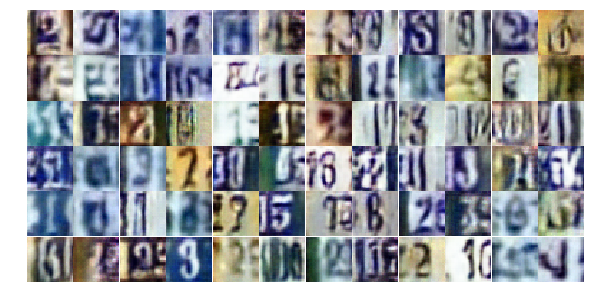

Epoch 10/25... Discriminator Loss: 0.7860... Generator Loss: 0.8269
Epoch 10/25... Discriminator Loss: 1.1255... Generator Loss: 4.5752
Epoch 10/25... Discriminator Loss: 1.4006... Generator Loss: 0.4107
Epoch 10/25... Discriminator Loss: 0.8795... Generator Loss: 0.7884
Epoch 10/25... Discriminator Loss: 0.5888... Generator Loss: 1.8422
Epoch 10/25... Discriminator Loss: 0.5780... Generator Loss: 1.2980
Epoch 10/25... Discriminator Loss: 0.5193... Generator Loss: 1.3050
Epoch 10/25... Discriminator Loss: 0.8390... Generator Loss: 0.7687
Epoch 10/25... Discriminator Loss: 0.6431... Generator Loss: 1.2736
Epoch 10/25... Discriminator Loss: 0.5170... Generator Loss: 1.5525


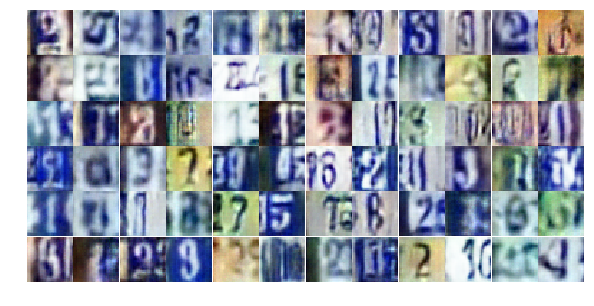

Epoch 10/25... Discriminator Loss: 0.5439... Generator Loss: 1.7307
Epoch 10/25... Discriminator Loss: 0.8197... Generator Loss: 0.8376
Epoch 10/25... Discriminator Loss: 0.8829... Generator Loss: 2.8170
Epoch 10/25... Discriminator Loss: 1.7639... Generator Loss: 0.2856
Epoch 10/25... Discriminator Loss: 0.5315... Generator Loss: 1.3406
Epoch 10/25... Discriminator Loss: 0.6749... Generator Loss: 1.0913
Epoch 10/25... Discriminator Loss: 0.7834... Generator Loss: 0.8479
Epoch 10/25... Discriminator Loss: 0.5979... Generator Loss: 1.1578
Epoch 10/25... Discriminator Loss: 0.6442... Generator Loss: 1.0602
Epoch 10/25... Discriminator Loss: 0.2425... Generator Loss: 2.1715


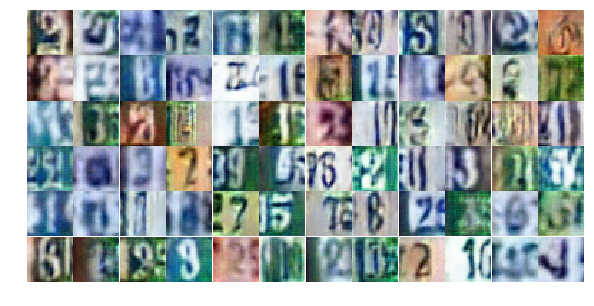

Epoch 10/25... Discriminator Loss: 1.3527... Generator Loss: 0.4335
Epoch 10/25... Discriminator Loss: 0.6271... Generator Loss: 1.1550
Epoch 10/25... Discriminator Loss: 0.4793... Generator Loss: 1.2284
Epoch 10/25... Discriminator Loss: 0.3827... Generator Loss: 2.0892
Epoch 10/25... Discriminator Loss: 1.2515... Generator Loss: 0.4382
Epoch 10/25... Discriminator Loss: 0.5964... Generator Loss: 1.2550
Epoch 10/25... Discriminator Loss: 0.3508... Generator Loss: 1.5719
Epoch 10/25... Discriminator Loss: 0.6229... Generator Loss: 1.0418
Epoch 10/25... Discriminator Loss: 0.7448... Generator Loss: 0.9044
Epoch 10/25... Discriminator Loss: 1.0136... Generator Loss: 0.6572


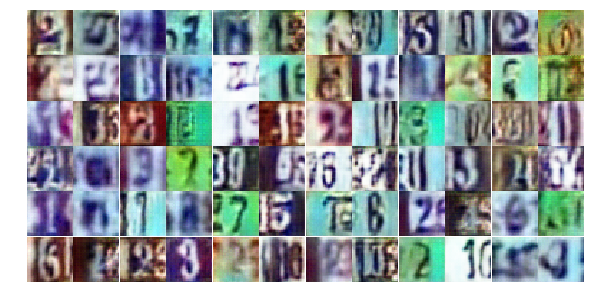

Epoch 10/25... Discriminator Loss: 0.5564... Generator Loss: 1.2638
Epoch 10/25... Discriminator Loss: 0.9288... Generator Loss: 0.6713
Epoch 10/25... Discriminator Loss: 0.4978... Generator Loss: 1.8200
Epoch 10/25... Discriminator Loss: 0.6767... Generator Loss: 1.0789
Epoch 10/25... Discriminator Loss: 0.5884... Generator Loss: 1.0791
Epoch 10/25... Discriminator Loss: 1.1291... Generator Loss: 0.5563
Epoch 10/25... Discriminator Loss: 0.8523... Generator Loss: 0.8025
Epoch 10/25... Discriminator Loss: 0.6289... Generator Loss: 1.0790
Epoch 10/25... Discriminator Loss: 0.9591... Generator Loss: 2.5176
Epoch 10/25... Discriminator Loss: 1.0593... Generator Loss: 0.6524


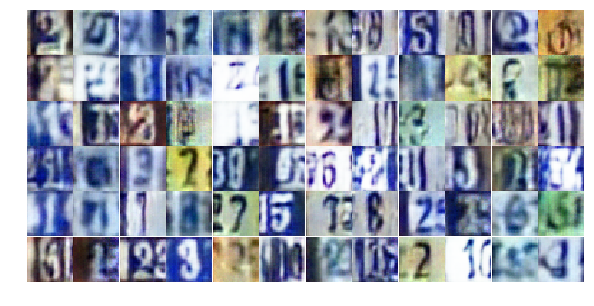

Epoch 10/25... Discriminator Loss: 1.0207... Generator Loss: 0.6793
Epoch 10/25... Discriminator Loss: 0.5507... Generator Loss: 1.4776
Epoch 10/25... Discriminator Loss: 0.9072... Generator Loss: 0.7242
Epoch 10/25... Discriminator Loss: 0.9003... Generator Loss: 0.7153
Epoch 10/25... Discriminator Loss: 0.4351... Generator Loss: 1.6161
Epoch 10/25... Discriminator Loss: 0.7151... Generator Loss: 0.9857
Epoch 10/25... Discriminator Loss: 0.6042... Generator Loss: 1.2600
Epoch 10/25... Discriminator Loss: 1.1010... Generator Loss: 2.8585
Epoch 10/25... Discriminator Loss: 0.4193... Generator Loss: 2.3667
Epoch 10/25... Discriminator Loss: 0.6593... Generator Loss: 1.2069


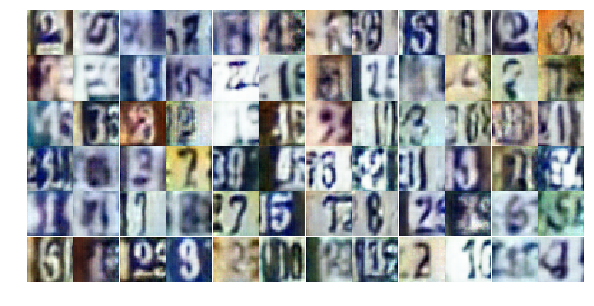

Epoch 10/25... Discriminator Loss: 0.7780... Generator Loss: 1.7668
Epoch 10/25... Discriminator Loss: 0.6212... Generator Loss: 1.2653
Epoch 10/25... Discriminator Loss: 0.3187... Generator Loss: 2.0353
Epoch 11/25... Discriminator Loss: 0.4996... Generator Loss: 1.9672
Epoch 11/25... Discriminator Loss: 0.5759... Generator Loss: 1.1961
Epoch 11/25... Discriminator Loss: 1.4655... Generator Loss: 0.3497
Epoch 11/25... Discriminator Loss: 0.4493... Generator Loss: 1.4469
Epoch 11/25... Discriminator Loss: 0.6824... Generator Loss: 1.3851
Epoch 11/25... Discriminator Loss: 1.5037... Generator Loss: 0.3344
Epoch 11/25... Discriminator Loss: 0.4243... Generator Loss: 2.1781


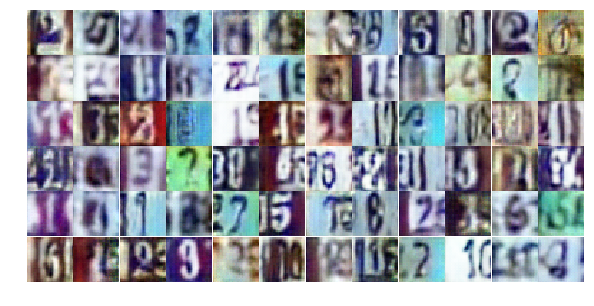

Epoch 11/25... Discriminator Loss: 0.3579... Generator Loss: 2.0326
Epoch 11/25... Discriminator Loss: 0.7369... Generator Loss: 1.0276
Epoch 11/25... Discriminator Loss: 0.4967... Generator Loss: 1.3797
Epoch 11/25... Discriminator Loss: 0.5833... Generator Loss: 1.2460
Epoch 11/25... Discriminator Loss: 0.9237... Generator Loss: 0.7138
Epoch 11/25... Discriminator Loss: 0.3614... Generator Loss: 1.7101
Epoch 11/25... Discriminator Loss: 0.7024... Generator Loss: 0.9465
Epoch 11/25... Discriminator Loss: 0.2597... Generator Loss: 2.7245
Epoch 11/25... Discriminator Loss: 0.5649... Generator Loss: 1.2431
Epoch 11/25... Discriminator Loss: 1.3455... Generator Loss: 0.4144


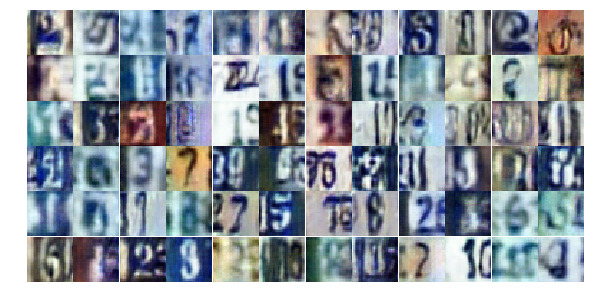

Epoch 11/25... Discriminator Loss: 0.7810... Generator Loss: 0.8385
Epoch 11/25... Discriminator Loss: 0.4512... Generator Loss: 2.1451
Epoch 11/25... Discriminator Loss: 0.5593... Generator Loss: 1.1536
Epoch 11/25... Discriminator Loss: 0.7836... Generator Loss: 0.8742
Epoch 11/25... Discriminator Loss: 0.3009... Generator Loss: 1.8795
Epoch 11/25... Discriminator Loss: 0.3894... Generator Loss: 1.7605
Epoch 11/25... Discriminator Loss: 0.4803... Generator Loss: 1.3761
Epoch 11/25... Discriminator Loss: 1.0940... Generator Loss: 0.5779
Epoch 11/25... Discriminator Loss: 0.3781... Generator Loss: 1.9397
Epoch 11/25... Discriminator Loss: 0.8594... Generator Loss: 0.8005


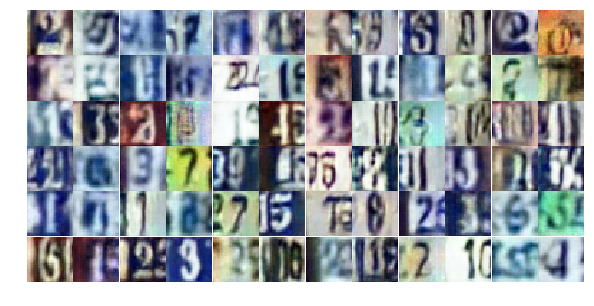

Epoch 11/25... Discriminator Loss: 0.9131... Generator Loss: 0.6866
Epoch 11/25... Discriminator Loss: 0.6110... Generator Loss: 1.1557
Epoch 11/25... Discriminator Loss: 0.8104... Generator Loss: 0.9217
Epoch 11/25... Discriminator Loss: 0.4362... Generator Loss: 1.5961
Epoch 11/25... Discriminator Loss: 0.9308... Generator Loss: 0.6718
Epoch 11/25... Discriminator Loss: 1.0445... Generator Loss: 0.5727
Epoch 11/25... Discriminator Loss: 1.6205... Generator Loss: 4.1943
Epoch 11/25... Discriminator Loss: 1.2631... Generator Loss: 0.4874
Epoch 11/25... Discriminator Loss: 0.5760... Generator Loss: 1.5390
Epoch 11/25... Discriminator Loss: 1.1748... Generator Loss: 0.6038


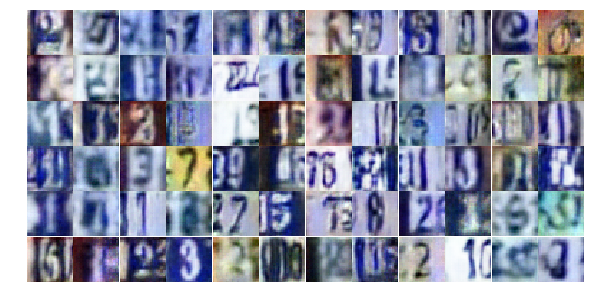

Epoch 11/25... Discriminator Loss: 0.4235... Generator Loss: 1.4562
Epoch 11/25... Discriminator Loss: 0.5558... Generator Loss: 1.3446
Epoch 11/25... Discriminator Loss: 0.5134... Generator Loss: 1.2962
Epoch 11/25... Discriminator Loss: 0.5489... Generator Loss: 1.3806
Epoch 11/25... Discriminator Loss: 0.7777... Generator Loss: 0.8119
Epoch 11/25... Discriminator Loss: 0.4510... Generator Loss: 1.4236
Epoch 11/25... Discriminator Loss: 0.2584... Generator Loss: 2.9642
Epoch 11/25... Discriminator Loss: 0.7159... Generator Loss: 0.9236
Epoch 11/25... Discriminator Loss: 1.6012... Generator Loss: 0.3417
Epoch 11/25... Discriminator Loss: 0.4272... Generator Loss: 1.7017


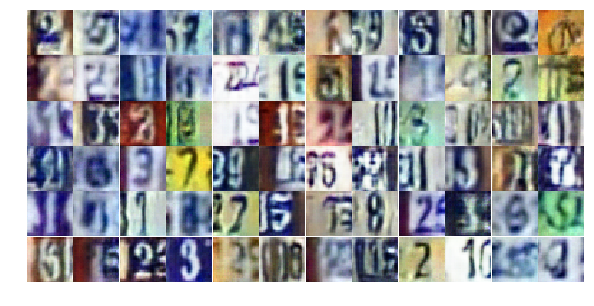

Epoch 11/25... Discriminator Loss: 0.7634... Generator Loss: 2.4949
Epoch 11/25... Discriminator Loss: 0.5411... Generator Loss: 1.5237
Epoch 11/25... Discriminator Loss: 0.8444... Generator Loss: 0.8976
Epoch 11/25... Discriminator Loss: 0.4705... Generator Loss: 1.3514
Epoch 11/25... Discriminator Loss: 0.7708... Generator Loss: 1.0233
Epoch 11/25... Discriminator Loss: 0.6294... Generator Loss: 1.0653
Epoch 11/25... Discriminator Loss: 0.9616... Generator Loss: 0.6966
Epoch 11/25... Discriminator Loss: 0.4632... Generator Loss: 1.8287
Epoch 11/25... Discriminator Loss: 0.8610... Generator Loss: 0.9205
Epoch 11/25... Discriminator Loss: 0.6082... Generator Loss: 1.2287


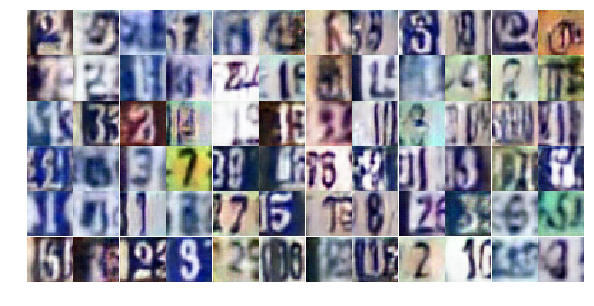

Epoch 12/25... Discriminator Loss: 0.6525... Generator Loss: 1.9416
Epoch 12/25... Discriminator Loss: 0.5000... Generator Loss: 1.7966
Epoch 12/25... Discriminator Loss: 0.7646... Generator Loss: 0.9786
Epoch 12/25... Discriminator Loss: 0.5325... Generator Loss: 1.7814
Epoch 12/25... Discriminator Loss: 0.4693... Generator Loss: 1.4495
Epoch 12/25... Discriminator Loss: 0.9621... Generator Loss: 0.6875
Epoch 12/25... Discriminator Loss: 0.5322... Generator Loss: 1.3291
Epoch 12/25... Discriminator Loss: 0.5831... Generator Loss: 1.3427
Epoch 12/25... Discriminator Loss: 0.6348... Generator Loss: 1.0624
Epoch 12/25... Discriminator Loss: 0.9348... Generator Loss: 0.7910


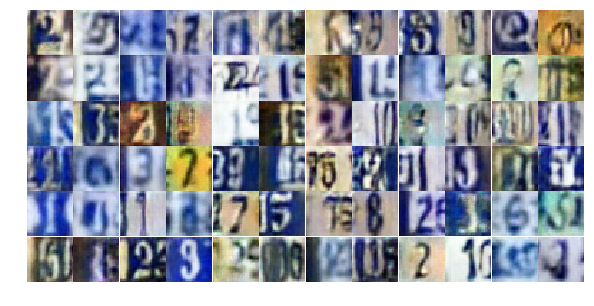

Epoch 12/25... Discriminator Loss: 0.8167... Generator Loss: 0.7892
Epoch 12/25... Discriminator Loss: 0.7493... Generator Loss: 0.8810
Epoch 12/25... Discriminator Loss: 0.4776... Generator Loss: 1.4000
Epoch 12/25... Discriminator Loss: 0.7277... Generator Loss: 1.3329
Epoch 12/25... Discriminator Loss: 0.4694... Generator Loss: 1.7731
Epoch 12/25... Discriminator Loss: 0.7785... Generator Loss: 0.8948
Epoch 12/25... Discriminator Loss: 1.5616... Generator Loss: 0.3651
Epoch 12/25... Discriminator Loss: 1.2216... Generator Loss: 3.2411
Epoch 12/25... Discriminator Loss: 0.6265... Generator Loss: 1.3045
Epoch 12/25... Discriminator Loss: 0.9174... Generator Loss: 0.7374


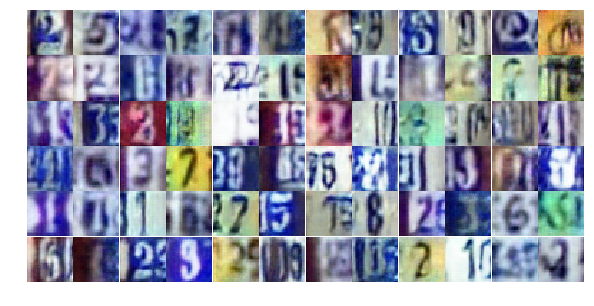

Epoch 12/25... Discriminator Loss: 0.5096... Generator Loss: 2.4522
Epoch 12/25... Discriminator Loss: 0.4905... Generator Loss: 1.6286
Epoch 12/25... Discriminator Loss: 0.7266... Generator Loss: 2.2359
Epoch 12/25... Discriminator Loss: 0.4174... Generator Loss: 1.7859
Epoch 12/25... Discriminator Loss: 0.3499... Generator Loss: 1.8032
Epoch 12/25... Discriminator Loss: 0.4420... Generator Loss: 1.4149
Epoch 12/25... Discriminator Loss: 0.6415... Generator Loss: 1.1338
Epoch 12/25... Discriminator Loss: 0.4106... Generator Loss: 1.5233
Epoch 12/25... Discriminator Loss: 0.5082... Generator Loss: 1.3412
Epoch 12/25... Discriminator Loss: 0.5812... Generator Loss: 1.3281


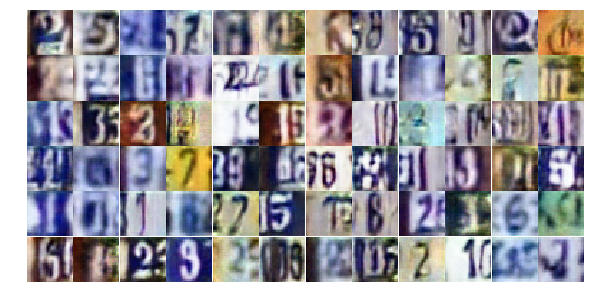

Epoch 12/25... Discriminator Loss: 0.3362... Generator Loss: 1.9095
Epoch 12/25... Discriminator Loss: 0.8464... Generator Loss: 0.7702
Epoch 12/25... Discriminator Loss: 0.8175... Generator Loss: 0.8449
Epoch 12/25... Discriminator Loss: 1.4797... Generator Loss: 0.4370
Epoch 12/25... Discriminator Loss: 0.5957... Generator Loss: 2.4738
Epoch 12/25... Discriminator Loss: 0.7593... Generator Loss: 0.9570
Epoch 12/25... Discriminator Loss: 0.8559... Generator Loss: 0.7498
Epoch 12/25... Discriminator Loss: 0.5445... Generator Loss: 1.4302
Epoch 12/25... Discriminator Loss: 0.4200... Generator Loss: 1.4962
Epoch 12/25... Discriminator Loss: 0.2339... Generator Loss: 2.5683


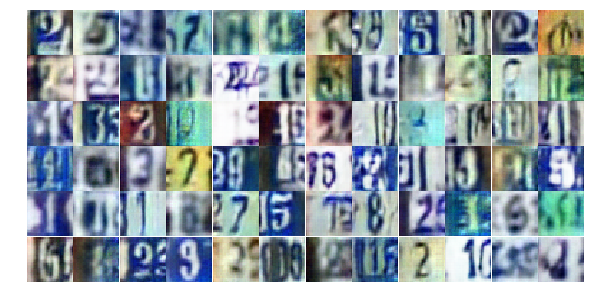

Epoch 12/25... Discriminator Loss: 0.6616... Generator Loss: 1.8939
Epoch 12/25... Discriminator Loss: 0.5150... Generator Loss: 1.2341
Epoch 12/25... Discriminator Loss: 0.3959... Generator Loss: 1.6478
Epoch 12/25... Discriminator Loss: 0.7805... Generator Loss: 0.9236
Epoch 12/25... Discriminator Loss: 0.6370... Generator Loss: 1.1801
Epoch 12/25... Discriminator Loss: 1.4131... Generator Loss: 0.4640
Epoch 12/25... Discriminator Loss: 0.4611... Generator Loss: 1.5575
Epoch 12/25... Discriminator Loss: 0.8317... Generator Loss: 0.9346
Epoch 12/25... Discriminator Loss: 0.4243... Generator Loss: 1.4541
Epoch 12/25... Discriminator Loss: 0.4679... Generator Loss: 1.3220


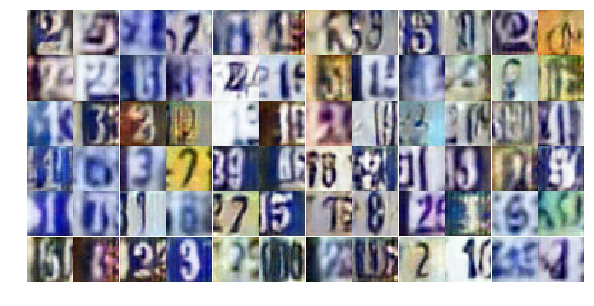

Epoch 12/25... Discriminator Loss: 0.8333... Generator Loss: 0.8359
Epoch 12/25... Discriminator Loss: 0.3792... Generator Loss: 1.8749
Epoch 12/25... Discriminator Loss: 0.9193... Generator Loss: 2.6912
Epoch 12/25... Discriminator Loss: 0.7327... Generator Loss: 1.0494
Epoch 12/25... Discriminator Loss: 0.5032... Generator Loss: 1.3779
Epoch 12/25... Discriminator Loss: 0.7427... Generator Loss: 2.7596
Epoch 12/25... Discriminator Loss: 1.1407... Generator Loss: 0.5550
Epoch 13/25... Discriminator Loss: 0.5370... Generator Loss: 1.3072
Epoch 13/25... Discriminator Loss: 0.4175... Generator Loss: 1.7166
Epoch 13/25... Discriminator Loss: 0.7127... Generator Loss: 0.9586


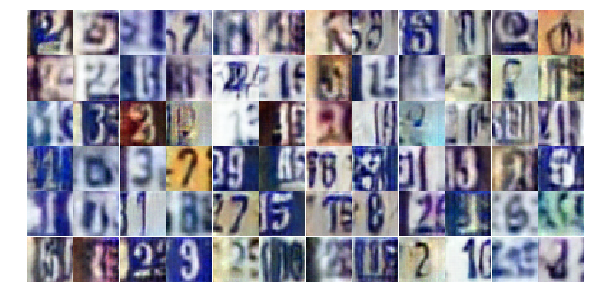

Epoch 13/25... Discriminator Loss: 0.5466... Generator Loss: 1.4731
Epoch 13/25... Discriminator Loss: 0.5783... Generator Loss: 1.1626
Epoch 13/25... Discriminator Loss: 1.2427... Generator Loss: 0.4711
Epoch 13/25... Discriminator Loss: 1.5473... Generator Loss: 0.3238
Epoch 13/25... Discriminator Loss: 0.6998... Generator Loss: 1.0331
Epoch 13/25... Discriminator Loss: 0.5058... Generator Loss: 1.7359
Epoch 13/25... Discriminator Loss: 0.4389... Generator Loss: 1.9559
Epoch 13/25... Discriminator Loss: 0.4131... Generator Loss: 1.5430
Epoch 13/25... Discriminator Loss: 0.6552... Generator Loss: 0.9568
Epoch 13/25... Discriminator Loss: 0.5258... Generator Loss: 2.3126


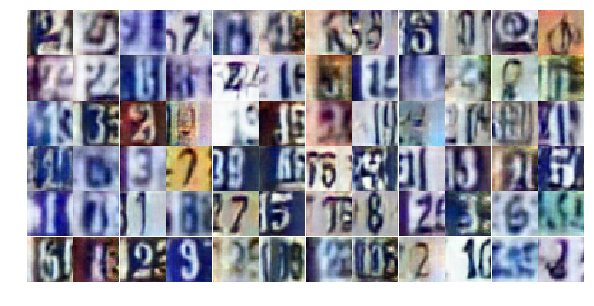

Epoch 13/25... Discriminator Loss: 0.8400... Generator Loss: 0.7849
Epoch 13/25... Discriminator Loss: 0.5234... Generator Loss: 1.3224
Epoch 13/25... Discriminator Loss: 1.2224... Generator Loss: 0.5444
Epoch 13/25... Discriminator Loss: 1.0077... Generator Loss: 0.6665
Epoch 13/25... Discriminator Loss: 0.3875... Generator Loss: 1.8873
Epoch 13/25... Discriminator Loss: 1.0080... Generator Loss: 0.7071
Epoch 13/25... Discriminator Loss: 0.6849... Generator Loss: 0.9977
Epoch 13/25... Discriminator Loss: 1.2385... Generator Loss: 0.5051
Epoch 13/25... Discriminator Loss: 0.4086... Generator Loss: 2.1553
Epoch 13/25... Discriminator Loss: 0.8261... Generator Loss: 0.7554


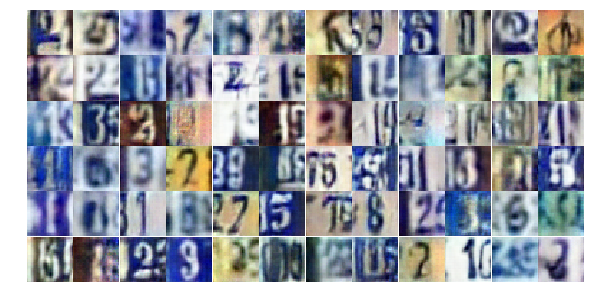

Epoch 13/25... Discriminator Loss: 0.5751... Generator Loss: 1.1803
Epoch 13/25... Discriminator Loss: 0.8311... Generator Loss: 0.9368
Epoch 13/25... Discriminator Loss: 0.3754... Generator Loss: 2.4020
Epoch 13/25... Discriminator Loss: 0.7557... Generator Loss: 0.9241
Epoch 13/25... Discriminator Loss: 0.8352... Generator Loss: 0.7882
Epoch 13/25... Discriminator Loss: 0.5751... Generator Loss: 1.2836
Epoch 13/25... Discriminator Loss: 1.2247... Generator Loss: 2.6270
Epoch 13/25... Discriminator Loss: 0.7970... Generator Loss: 0.8544
Epoch 13/25... Discriminator Loss: 0.4847... Generator Loss: 1.4524
Epoch 13/25... Discriminator Loss: 0.6241... Generator Loss: 1.1424


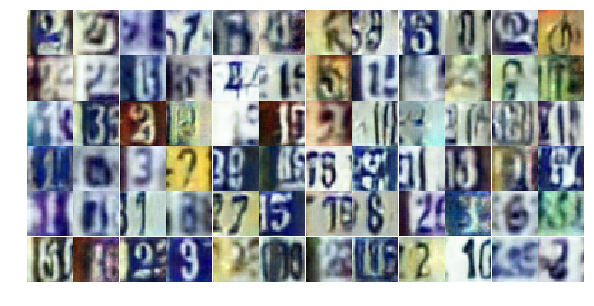

Epoch 13/25... Discriminator Loss: 1.3556... Generator Loss: 0.4732
Epoch 13/25... Discriminator Loss: 0.9503... Generator Loss: 0.7409
Epoch 13/25... Discriminator Loss: 0.9372... Generator Loss: 0.6650
Epoch 13/25... Discriminator Loss: 0.9978... Generator Loss: 0.6326
Epoch 13/25... Discriminator Loss: 0.5434... Generator Loss: 1.3264
Epoch 13/25... Discriminator Loss: 0.4121... Generator Loss: 1.5037
Epoch 13/25... Discriminator Loss: 0.4626... Generator Loss: 1.4242
Epoch 13/25... Discriminator Loss: 0.7833... Generator Loss: 0.9002
Epoch 13/25... Discriminator Loss: 0.5044... Generator Loss: 1.6248
Epoch 13/25... Discriminator Loss: 0.6961... Generator Loss: 1.0510


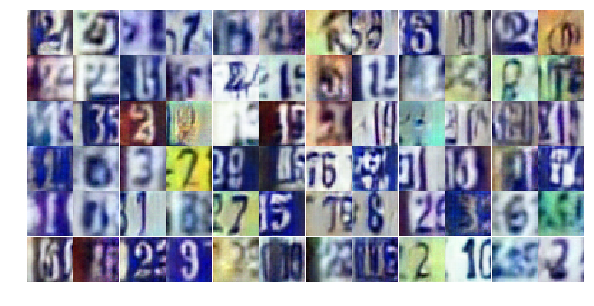

Epoch 13/25... Discriminator Loss: 0.3970... Generator Loss: 1.9483
Epoch 13/25... Discriminator Loss: 1.9570... Generator Loss: 1.1452
Epoch 13/25... Discriminator Loss: 2.0626... Generator Loss: 5.0694
Epoch 13/25... Discriminator Loss: 0.8530... Generator Loss: 0.8539
Epoch 13/25... Discriminator Loss: 0.8217... Generator Loss: 0.9552
Epoch 13/25... Discriminator Loss: 0.7319... Generator Loss: 1.0096
Epoch 13/25... Discriminator Loss: 0.6293... Generator Loss: 1.3713
Epoch 13/25... Discriminator Loss: 0.7973... Generator Loss: 0.8530
Epoch 13/25... Discriminator Loss: 0.8384... Generator Loss: 0.7859
Epoch 13/25... Discriminator Loss: 0.7226... Generator Loss: 0.9813


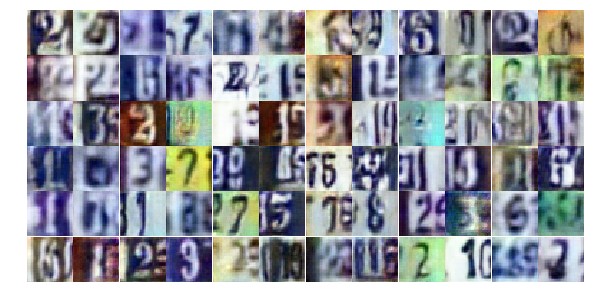

Epoch 13/25... Discriminator Loss: 0.3210... Generator Loss: 2.4032
Epoch 13/25... Discriminator Loss: 1.4580... Generator Loss: 0.3699
Epoch 13/25... Discriminator Loss: 0.4909... Generator Loss: 1.7232
Epoch 13/25... Discriminator Loss: 0.6670... Generator Loss: 1.0498
Epoch 14/25... Discriminator Loss: 1.0537... Generator Loss: 0.5814
Epoch 14/25... Discriminator Loss: 0.6462... Generator Loss: 1.0745
Epoch 14/25... Discriminator Loss: 0.7845... Generator Loss: 1.0712
Epoch 14/25... Discriminator Loss: 0.5266... Generator Loss: 1.3380
Epoch 14/25... Discriminator Loss: 0.6138... Generator Loss: 1.0581
Epoch 14/25... Discriminator Loss: 0.6006... Generator Loss: 1.2842


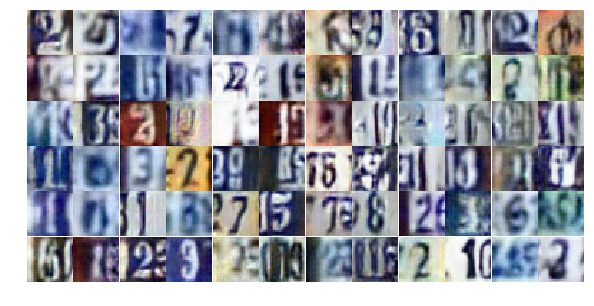

Epoch 14/25... Discriminator Loss: 0.5855... Generator Loss: 1.7871
Epoch 14/25... Discriminator Loss: 1.1534... Generator Loss: 0.5845
Epoch 14/25... Discriminator Loss: 0.5517... Generator Loss: 1.3162
Epoch 14/25... Discriminator Loss: 0.7585... Generator Loss: 0.8983
Epoch 14/25... Discriminator Loss: 1.1094... Generator Loss: 0.5414
Epoch 14/25... Discriminator Loss: 0.3358... Generator Loss: 1.5915
Epoch 14/25... Discriminator Loss: 0.3518... Generator Loss: 2.0017
Epoch 14/25... Discriminator Loss: 1.0297... Generator Loss: 0.6665
Epoch 14/25... Discriminator Loss: 0.9455... Generator Loss: 0.6721
Epoch 14/25... Discriminator Loss: 4.1913... Generator Loss: 0.0382


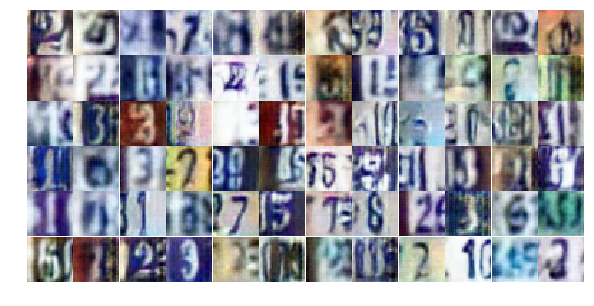

Epoch 14/25... Discriminator Loss: 0.5013... Generator Loss: 2.1071
Epoch 14/25... Discriminator Loss: 0.9273... Generator Loss: 2.8574
Epoch 14/25... Discriminator Loss: 0.8870... Generator Loss: 0.8829
Epoch 14/25... Discriminator Loss: 0.4222... Generator Loss: 1.7878
Epoch 14/25... Discriminator Loss: 1.0943... Generator Loss: 0.5813
Epoch 14/25... Discriminator Loss: 0.9764... Generator Loss: 0.6760
Epoch 14/25... Discriminator Loss: 0.5738... Generator Loss: 1.3590
Epoch 14/25... Discriminator Loss: 0.5776... Generator Loss: 1.2387
Epoch 14/25... Discriminator Loss: 0.5615... Generator Loss: 1.1384
Epoch 14/25... Discriminator Loss: 0.6822... Generator Loss: 1.0149


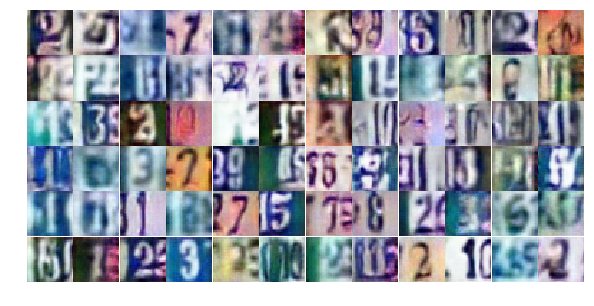

Epoch 14/25... Discriminator Loss: 1.2027... Generator Loss: 0.5171
Epoch 14/25... Discriminator Loss: 0.4208... Generator Loss: 1.4478
Epoch 14/25... Discriminator Loss: 0.6643... Generator Loss: 1.1309
Epoch 14/25... Discriminator Loss: 0.4490... Generator Loss: 1.5679
Epoch 14/25... Discriminator Loss: 0.5109... Generator Loss: 1.7339
Epoch 14/25... Discriminator Loss: 0.8134... Generator Loss: 0.8940
Epoch 14/25... Discriminator Loss: 0.5483... Generator Loss: 1.3984
Epoch 14/25... Discriminator Loss: 0.4936... Generator Loss: 1.2760
Epoch 14/25... Discriminator Loss: 0.4779... Generator Loss: 2.3046
Epoch 14/25... Discriminator Loss: 0.7624... Generator Loss: 0.8997


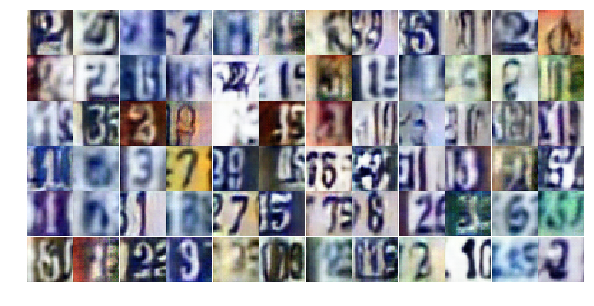

Epoch 14/25... Discriminator Loss: 1.2344... Generator Loss: 0.5136
Epoch 14/25... Discriminator Loss: 0.7144... Generator Loss: 1.8375
Epoch 14/25... Discriminator Loss: 0.7381... Generator Loss: 0.9271
Epoch 14/25... Discriminator Loss: 0.9793... Generator Loss: 0.6251
Epoch 14/25... Discriminator Loss: 0.6907... Generator Loss: 1.0292
Epoch 14/25... Discriminator Loss: 0.4761... Generator Loss: 1.5089
Epoch 14/25... Discriminator Loss: 0.6712... Generator Loss: 1.0323
Epoch 14/25... Discriminator Loss: 0.5768... Generator Loss: 1.1859
Epoch 14/25... Discriminator Loss: 1.2691... Generator Loss: 0.5151
Epoch 14/25... Discriminator Loss: 1.3882... Generator Loss: 0.4079


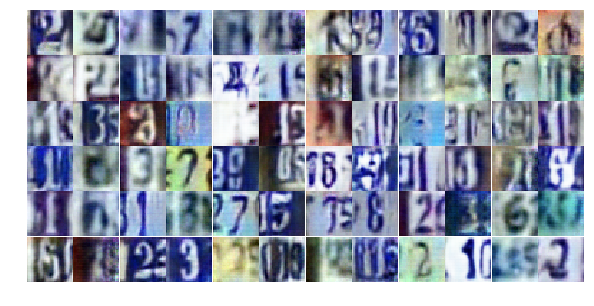

Epoch 14/25... Discriminator Loss: 0.8074... Generator Loss: 1.3239
Epoch 14/25... Discriminator Loss: 0.9666... Generator Loss: 0.6996
Epoch 14/25... Discriminator Loss: 0.5891... Generator Loss: 1.1394
Epoch 14/25... Discriminator Loss: 1.2186... Generator Loss: 0.4753
Epoch 14/25... Discriminator Loss: 0.6823... Generator Loss: 1.0059
Epoch 14/25... Discriminator Loss: 0.6924... Generator Loss: 0.9276
Epoch 14/25... Discriminator Loss: 1.1776... Generator Loss: 2.7235
Epoch 14/25... Discriminator Loss: 0.5488... Generator Loss: 1.6009
Epoch 14/25... Discriminator Loss: 1.0024... Generator Loss: 0.6419
Epoch 14/25... Discriminator Loss: 1.4701... Generator Loss: 0.4529


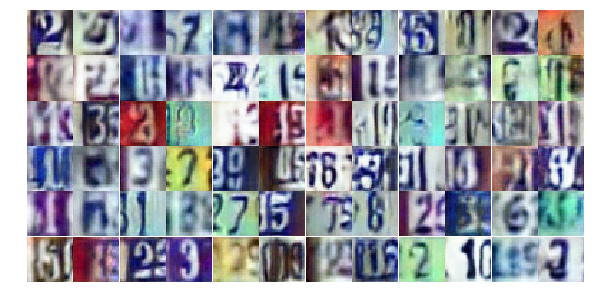

Epoch 14/25... Discriminator Loss: 0.9586... Generator Loss: 0.7835
Epoch 14/25... Discriminator Loss: 0.9308... Generator Loss: 0.9087
Epoch 15/25... Discriminator Loss: 0.7430... Generator Loss: 0.9175
Epoch 15/25... Discriminator Loss: 0.5088... Generator Loss: 1.4873
Epoch 15/25... Discriminator Loss: 0.6311... Generator Loss: 1.1940
Epoch 15/25... Discriminator Loss: 0.6546... Generator Loss: 1.0869
Epoch 15/25... Discriminator Loss: 0.8738... Generator Loss: 0.7656
Epoch 15/25... Discriminator Loss: 0.6924... Generator Loss: 2.2158
Epoch 15/25... Discriminator Loss: 1.2254... Generator Loss: 0.5289
Epoch 15/25... Discriminator Loss: 0.6076... Generator Loss: 1.0732


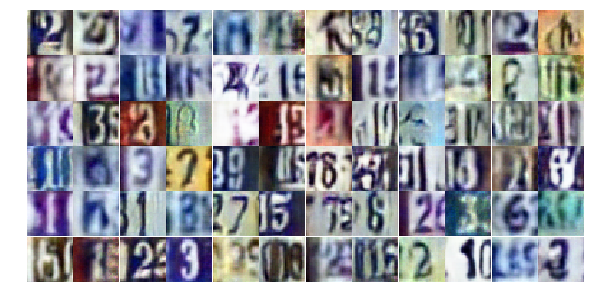

Epoch 15/25... Discriminator Loss: 0.5821... Generator Loss: 1.2891
Epoch 15/25... Discriminator Loss: 0.7299... Generator Loss: 1.9863
Epoch 15/25... Discriminator Loss: 0.5750... Generator Loss: 1.5364
Epoch 15/25... Discriminator Loss: 0.5809... Generator Loss: 1.3778
Epoch 15/25... Discriminator Loss: 1.1501... Generator Loss: 0.5334
Epoch 15/25... Discriminator Loss: 0.4454... Generator Loss: 1.5822
Epoch 15/25... Discriminator Loss: 1.1067... Generator Loss: 0.5486
Epoch 15/25... Discriminator Loss: 0.9739... Generator Loss: 0.7502
Epoch 15/25... Discriminator Loss: 0.4668... Generator Loss: 2.3861
Epoch 15/25... Discriminator Loss: 0.7049... Generator Loss: 1.2290


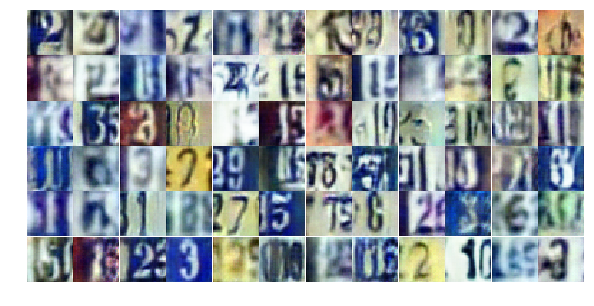

Epoch 15/25... Discriminator Loss: 0.8149... Generator Loss: 0.9323
Epoch 15/25... Discriminator Loss: 0.5216... Generator Loss: 1.4060
Epoch 15/25... Discriminator Loss: 0.5239... Generator Loss: 1.4234
Epoch 15/25... Discriminator Loss: 0.9128... Generator Loss: 0.7213
Epoch 15/25... Discriminator Loss: 1.0631... Generator Loss: 0.6712
Epoch 15/25... Discriminator Loss: 0.8982... Generator Loss: 0.8034
Epoch 15/25... Discriminator Loss: 1.1063... Generator Loss: 0.5722
Epoch 15/25... Discriminator Loss: 0.6709... Generator Loss: 1.0307
Epoch 15/25... Discriminator Loss: 0.5532... Generator Loss: 1.1397
Epoch 15/25... Discriminator Loss: 1.6813... Generator Loss: 0.3756


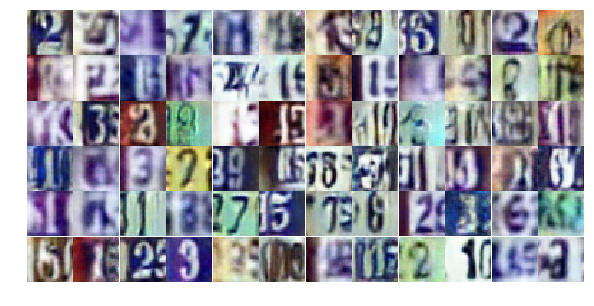

Epoch 15/25... Discriminator Loss: 0.4336... Generator Loss: 1.4597
Epoch 15/25... Discriminator Loss: 1.0678... Generator Loss: 1.3516
Epoch 15/25... Discriminator Loss: 0.5695... Generator Loss: 1.2987
Epoch 15/25... Discriminator Loss: 0.6134... Generator Loss: 1.2788
Epoch 15/25... Discriminator Loss: 0.6092... Generator Loss: 1.0916
Epoch 15/25... Discriminator Loss: 1.3421... Generator Loss: 3.0649
Epoch 15/25... Discriminator Loss: 0.6869... Generator Loss: 1.0198
Epoch 15/25... Discriminator Loss: 0.5944... Generator Loss: 1.1985
Epoch 15/25... Discriminator Loss: 0.4984... Generator Loss: 1.2716
Epoch 15/25... Discriminator Loss: 0.5822... Generator Loss: 1.3031


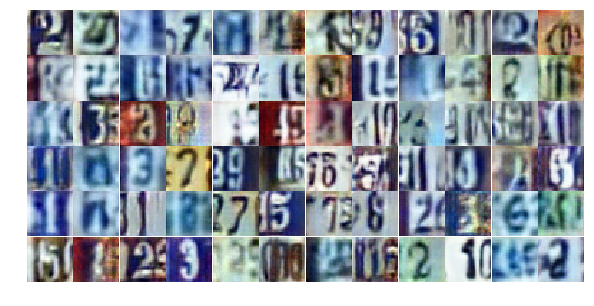

Epoch 15/25... Discriminator Loss: 0.6692... Generator Loss: 1.0082
Epoch 15/25... Discriminator Loss: 1.3096... Generator Loss: 0.4766
Epoch 15/25... Discriminator Loss: 0.6769... Generator Loss: 1.0374
Epoch 15/25... Discriminator Loss: 0.2932... Generator Loss: 2.0209
Epoch 15/25... Discriminator Loss: 0.7635... Generator Loss: 0.8666
Epoch 15/25... Discriminator Loss: 1.4683... Generator Loss: 0.4288
Epoch 15/25... Discriminator Loss: 2.3246... Generator Loss: 0.2220
Epoch 15/25... Discriminator Loss: 1.4533... Generator Loss: 0.6680
Epoch 15/25... Discriminator Loss: 0.8527... Generator Loss: 0.8750
Epoch 15/25... Discriminator Loss: 0.7012... Generator Loss: 1.6021


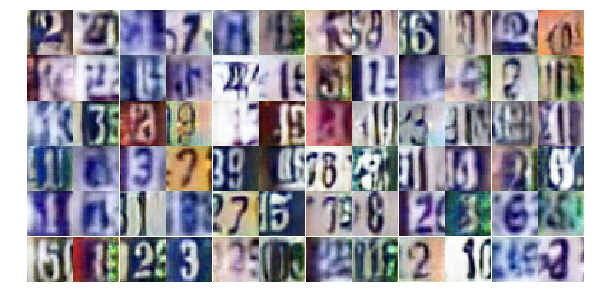

Epoch 15/25... Discriminator Loss: 1.3319... Generator Loss: 0.4613
Epoch 15/25... Discriminator Loss: 0.7929... Generator Loss: 0.9012
Epoch 15/25... Discriminator Loss: 0.6003... Generator Loss: 1.0970
Epoch 15/25... Discriminator Loss: 0.9690... Generator Loss: 0.6541
Epoch 15/25... Discriminator Loss: 0.6384... Generator Loss: 1.1372
Epoch 15/25... Discriminator Loss: 0.6792... Generator Loss: 1.2157
Epoch 15/25... Discriminator Loss: 0.7668... Generator Loss: 0.9019
Epoch 15/25... Discriminator Loss: 0.3857... Generator Loss: 1.7919
Epoch 15/25... Discriminator Loss: 1.6393... Generator Loss: 0.3071
Epoch 16/25... Discriminator Loss: 0.9179... Generator Loss: 0.7017


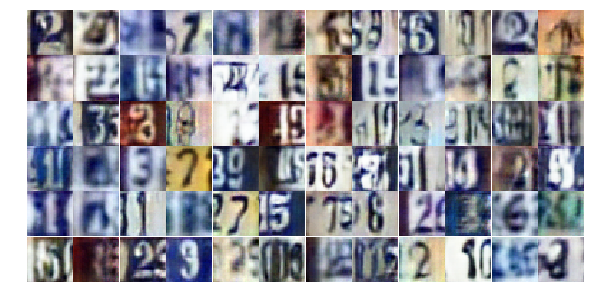

Epoch 16/25... Discriminator Loss: 0.5646... Generator Loss: 1.1989
Epoch 16/25... Discriminator Loss: 0.7400... Generator Loss: 0.9230
Epoch 16/25... Discriminator Loss: 0.8013... Generator Loss: 0.8828
Epoch 16/25... Discriminator Loss: 0.7014... Generator Loss: 1.4912
Epoch 16/25... Discriminator Loss: 1.1919... Generator Loss: 3.4441
Epoch 16/25... Discriminator Loss: 0.5433... Generator Loss: 1.5332
Epoch 16/25... Discriminator Loss: 1.2693... Generator Loss: 0.4869
Epoch 16/25... Discriminator Loss: 0.6494... Generator Loss: 1.0704
Epoch 16/25... Discriminator Loss: 0.6278... Generator Loss: 1.0770
Epoch 16/25... Discriminator Loss: 0.8039... Generator Loss: 0.8545


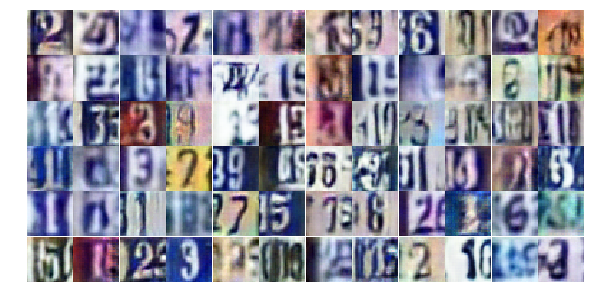

Epoch 16/25... Discriminator Loss: 1.3357... Generator Loss: 0.4261
Epoch 16/25... Discriminator Loss: 0.6935... Generator Loss: 1.0411
Epoch 16/25... Discriminator Loss: 0.7069... Generator Loss: 1.0691
Epoch 16/25... Discriminator Loss: 1.8591... Generator Loss: 0.2770
Epoch 16/25... Discriminator Loss: 0.6872... Generator Loss: 1.0779
Epoch 16/25... Discriminator Loss: 0.6138... Generator Loss: 1.0916
Epoch 16/25... Discriminator Loss: 1.6517... Generator Loss: 0.3710
Epoch 16/25... Discriminator Loss: 0.5071... Generator Loss: 1.6487
Epoch 16/25... Discriminator Loss: 0.5129... Generator Loss: 1.2178
Epoch 16/25... Discriminator Loss: 0.8782... Generator Loss: 0.7529


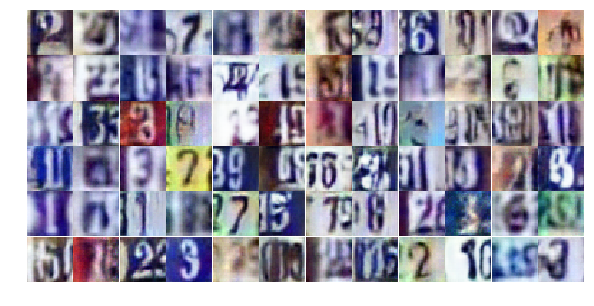

Epoch 16/25... Discriminator Loss: 0.6083... Generator Loss: 1.2957
Epoch 16/25... Discriminator Loss: 0.6224... Generator Loss: 1.1697
Epoch 16/25... Discriminator Loss: 0.7240... Generator Loss: 0.9596
Epoch 16/25... Discriminator Loss: 0.9485... Generator Loss: 0.6666
Epoch 16/25... Discriminator Loss: 0.7608... Generator Loss: 1.0337
Epoch 16/25... Discriminator Loss: 0.8067... Generator Loss: 0.9938
Epoch 16/25... Discriminator Loss: 0.8966... Generator Loss: 0.7422
Epoch 16/25... Discriminator Loss: 0.4667... Generator Loss: 1.5717
Epoch 16/25... Discriminator Loss: 1.1118... Generator Loss: 0.6271
Epoch 16/25... Discriminator Loss: 0.7182... Generator Loss: 0.9419


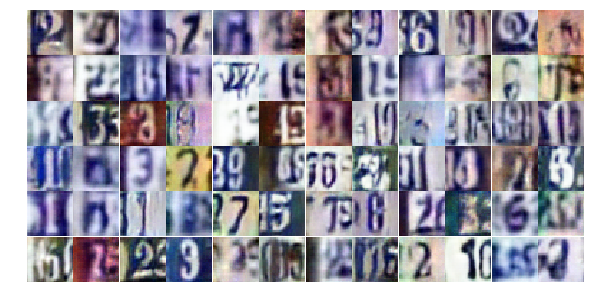

Epoch 16/25... Discriminator Loss: 0.6046... Generator Loss: 1.1374
Epoch 16/25... Discriminator Loss: 0.5624... Generator Loss: 1.1820
Epoch 16/25... Discriminator Loss: 0.6828... Generator Loss: 1.1705
Epoch 16/25... Discriminator Loss: 0.7612... Generator Loss: 1.0119
Epoch 16/25... Discriminator Loss: 0.7583... Generator Loss: 1.5232
Epoch 16/25... Discriminator Loss: 0.8774... Generator Loss: 0.7630
Epoch 16/25... Discriminator Loss: 0.7854... Generator Loss: 0.8457
Epoch 16/25... Discriminator Loss: 0.9117... Generator Loss: 0.7580
Epoch 16/25... Discriminator Loss: 0.4977... Generator Loss: 1.4263
Epoch 16/25... Discriminator Loss: 0.4610... Generator Loss: 1.6802


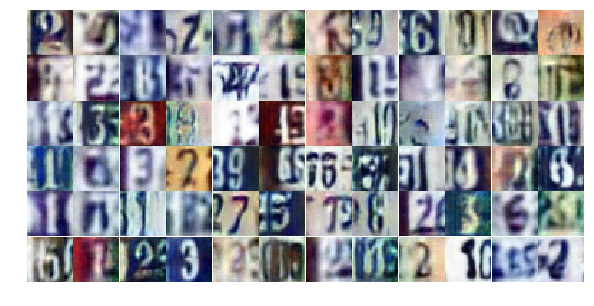

Epoch 16/25... Discriminator Loss: 0.5086... Generator Loss: 1.7926
Epoch 16/25... Discriminator Loss: 0.5702... Generator Loss: 1.5098
Epoch 16/25... Discriminator Loss: 1.0621... Generator Loss: 0.5854
Epoch 16/25... Discriminator Loss: 1.6286... Generator Loss: 0.2861
Epoch 16/25... Discriminator Loss: 1.8694... Generator Loss: 0.2968
Epoch 16/25... Discriminator Loss: 1.8612... Generator Loss: 0.3807
Epoch 16/25... Discriminator Loss: 0.5229... Generator Loss: 1.2963
Epoch 16/25... Discriminator Loss: 0.8246... Generator Loss: 0.8316
Epoch 16/25... Discriminator Loss: 0.5127... Generator Loss: 1.3546
Epoch 16/25... Discriminator Loss: 0.8080... Generator Loss: 0.8498


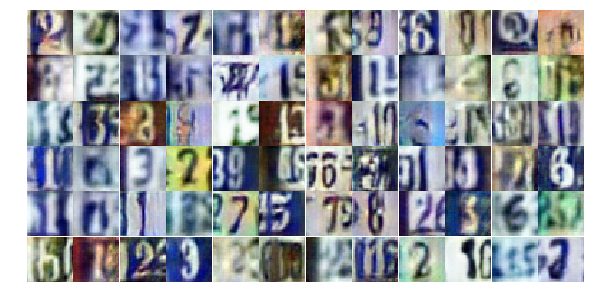

Epoch 16/25... Discriminator Loss: 1.2189... Generator Loss: 0.6456
Epoch 16/25... Discriminator Loss: 0.6994... Generator Loss: 1.0169
Epoch 16/25... Discriminator Loss: 1.4287... Generator Loss: 0.4471
Epoch 16/25... Discriminator Loss: 0.5000... Generator Loss: 1.3519
Epoch 16/25... Discriminator Loss: 0.6399... Generator Loss: 1.0779
Epoch 16/25... Discriminator Loss: 0.6845... Generator Loss: 0.9907
Epoch 17/25... Discriminator Loss: 0.8059... Generator Loss: 0.8959
Epoch 17/25... Discriminator Loss: 1.0780... Generator Loss: 0.6031
Epoch 17/25... Discriminator Loss: 0.8193... Generator Loss: 0.8544
Epoch 17/25... Discriminator Loss: 0.6292... Generator Loss: 1.1098


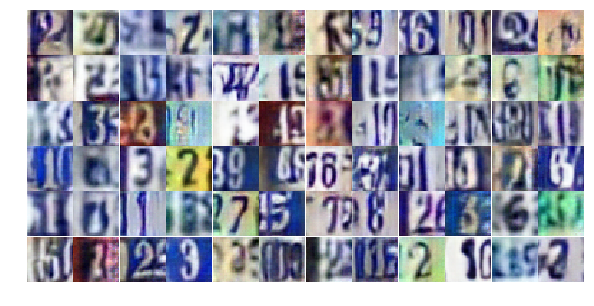

Epoch 17/25... Discriminator Loss: 0.4995... Generator Loss: 1.3660
Epoch 17/25... Discriminator Loss: 0.4492... Generator Loss: 1.4195
Epoch 17/25... Discriminator Loss: 0.6772... Generator Loss: 1.6975
Epoch 17/25... Discriminator Loss: 0.7104... Generator Loss: 1.0805
Epoch 17/25... Discriminator Loss: 0.9475... Generator Loss: 0.7449
Epoch 17/25... Discriminator Loss: 0.9834... Generator Loss: 0.6890
Epoch 17/25... Discriminator Loss: 0.8493... Generator Loss: 0.9995
Epoch 17/25... Discriminator Loss: 0.4736... Generator Loss: 1.2925
Epoch 17/25... Discriminator Loss: 0.4973... Generator Loss: 1.4201
Epoch 17/25... Discriminator Loss: 0.7706... Generator Loss: 0.9873


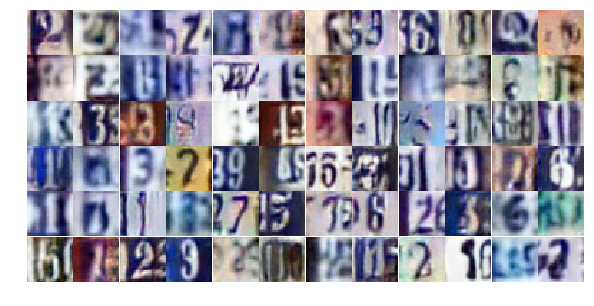

Epoch 17/25... Discriminator Loss: 0.7454... Generator Loss: 1.1624
Epoch 17/25... Discriminator Loss: 0.7429... Generator Loss: 0.8978
Epoch 17/25... Discriminator Loss: 0.5932... Generator Loss: 1.1441
Epoch 17/25... Discriminator Loss: 1.2414... Generator Loss: 0.5387
Epoch 17/25... Discriminator Loss: 0.7032... Generator Loss: 2.3913
Epoch 17/25... Discriminator Loss: 0.7453... Generator Loss: 0.9024
Epoch 17/25... Discriminator Loss: 0.6577... Generator Loss: 1.1354
Epoch 17/25... Discriminator Loss: 0.4832... Generator Loss: 1.4008
Epoch 17/25... Discriminator Loss: 0.7008... Generator Loss: 0.9637
Epoch 17/25... Discriminator Loss: 0.5949... Generator Loss: 1.1038


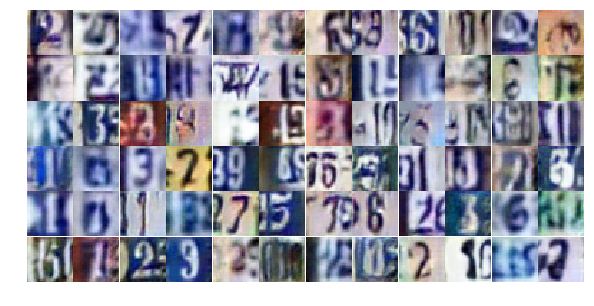

Epoch 17/25... Discriminator Loss: 1.6762... Generator Loss: 0.2942
Epoch 17/25... Discriminator Loss: 0.4154... Generator Loss: 1.6836
Epoch 17/25... Discriminator Loss: 0.5294... Generator Loss: 1.4029
Epoch 17/25... Discriminator Loss: 0.8356... Generator Loss: 0.8831
Epoch 17/25... Discriminator Loss: 1.5421... Generator Loss: 0.3633
Epoch 17/25... Discriminator Loss: 0.5799... Generator Loss: 1.1341
Epoch 17/25... Discriminator Loss: 0.5019... Generator Loss: 1.4099
Epoch 17/25... Discriminator Loss: 1.1572... Generator Loss: 0.5482
Epoch 17/25... Discriminator Loss: 1.0519... Generator Loss: 0.6733
Epoch 17/25... Discriminator Loss: 0.3365... Generator Loss: 1.9729


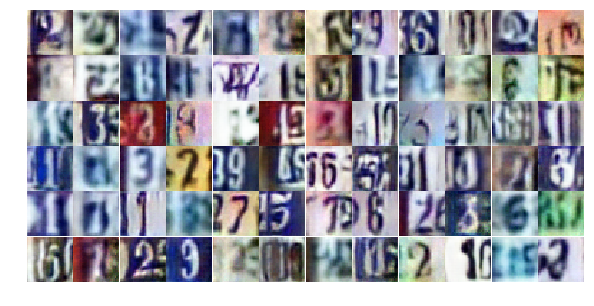

Epoch 17/25... Discriminator Loss: 2.2621... Generator Loss: 0.2033
Epoch 17/25... Discriminator Loss: 1.4456... Generator Loss: 0.4489
Epoch 17/25... Discriminator Loss: 0.8444... Generator Loss: 1.0018
Epoch 17/25... Discriminator Loss: 0.8524... Generator Loss: 1.7917
Epoch 17/25... Discriminator Loss: 0.7988... Generator Loss: 0.9323
Epoch 17/25... Discriminator Loss: 1.0019... Generator Loss: 0.6740
Epoch 17/25... Discriminator Loss: 0.7806... Generator Loss: 0.8851
Epoch 17/25... Discriminator Loss: 0.5364... Generator Loss: 1.2973
Epoch 17/25... Discriminator Loss: 0.3583... Generator Loss: 1.8725
Epoch 17/25... Discriminator Loss: 0.8359... Generator Loss: 0.8225


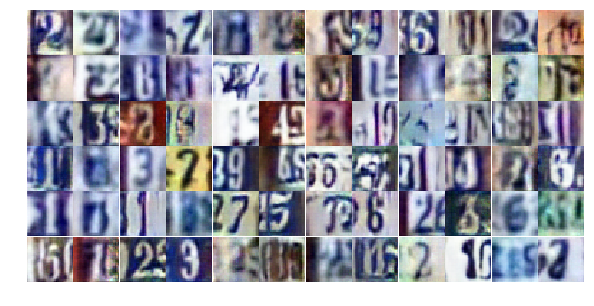

Epoch 17/25... Discriminator Loss: 1.0646... Generator Loss: 0.7510
Epoch 17/25... Discriminator Loss: 0.2685... Generator Loss: 2.2429
Epoch 17/25... Discriminator Loss: 0.5532... Generator Loss: 1.6224
Epoch 17/25... Discriminator Loss: 0.3577... Generator Loss: 1.6937
Epoch 17/25... Discriminator Loss: 0.7649... Generator Loss: 0.9189
Epoch 17/25... Discriminator Loss: 0.7158... Generator Loss: 1.0062
Epoch 17/25... Discriminator Loss: 0.7666... Generator Loss: 0.9588
Epoch 17/25... Discriminator Loss: 0.4919... Generator Loss: 1.3099
Epoch 17/25... Discriminator Loss: 0.6109... Generator Loss: 1.1975
Epoch 17/25... Discriminator Loss: 1.0430... Generator Loss: 0.9970


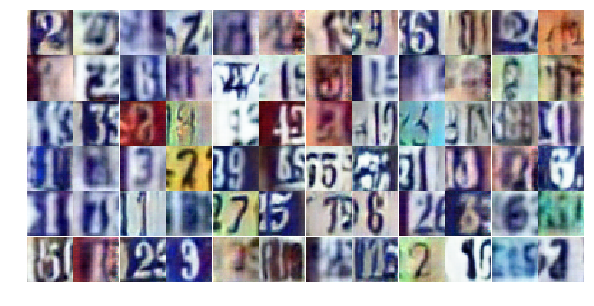

Epoch 17/25... Discriminator Loss: 0.8163... Generator Loss: 1.0583
Epoch 17/25... Discriminator Loss: 0.8404... Generator Loss: 0.8785
Epoch 17/25... Discriminator Loss: 0.4079... Generator Loss: 3.3524
Epoch 17/25... Discriminator Loss: 0.5794... Generator Loss: 1.8070
Epoch 18/25... Discriminator Loss: 1.2079... Generator Loss: 0.5312
Epoch 18/25... Discriminator Loss: 1.1781... Generator Loss: 0.5080
Epoch 18/25... Discriminator Loss: 0.6824... Generator Loss: 1.0504
Epoch 18/25... Discriminator Loss: 0.7059... Generator Loss: 0.9396
Epoch 18/25... Discriminator Loss: 1.1892... Generator Loss: 0.5432
Epoch 18/25... Discriminator Loss: 0.8344... Generator Loss: 0.8922


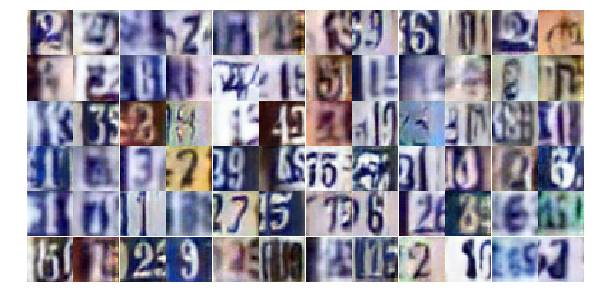

Epoch 18/25... Discriminator Loss: 0.4879... Generator Loss: 2.1733
Epoch 18/25... Discriminator Loss: 1.2953... Generator Loss: 0.4614
Epoch 18/25... Discriminator Loss: 0.9171... Generator Loss: 0.7010
Epoch 18/25... Discriminator Loss: 0.5233... Generator Loss: 1.2666
Epoch 18/25... Discriminator Loss: 0.5060... Generator Loss: 1.9419
Epoch 18/25... Discriminator Loss: 0.8072... Generator Loss: 0.7837
Epoch 18/25... Discriminator Loss: 0.6460... Generator Loss: 1.0520
Epoch 18/25... Discriminator Loss: 0.9780... Generator Loss: 0.6169
Epoch 18/25... Discriminator Loss: 0.6370... Generator Loss: 1.0698
Epoch 18/25... Discriminator Loss: 0.3663... Generator Loss: 2.0909


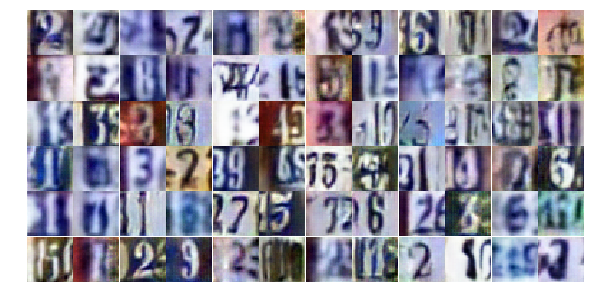

Epoch 18/25... Discriminator Loss: 0.4651... Generator Loss: 1.5282
Epoch 18/25... Discriminator Loss: 0.7331... Generator Loss: 2.3482
Epoch 18/25... Discriminator Loss: 0.8089... Generator Loss: 0.9425
Epoch 18/25... Discriminator Loss: 0.4784... Generator Loss: 1.3662
Epoch 18/25... Discriminator Loss: 0.7640... Generator Loss: 0.8568
Epoch 18/25... Discriminator Loss: 0.8513... Generator Loss: 0.7682
Epoch 18/25... Discriminator Loss: 0.7595... Generator Loss: 1.2043
Epoch 18/25... Discriminator Loss: 0.9673... Generator Loss: 0.6131
Epoch 18/25... Discriminator Loss: 0.6846... Generator Loss: 1.0532
Epoch 18/25... Discriminator Loss: 0.4739... Generator Loss: 1.4404


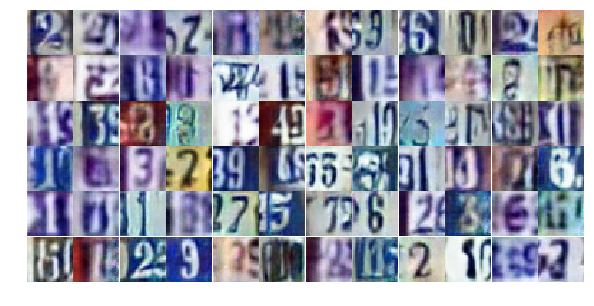

Epoch 18/25... Discriminator Loss: 0.4381... Generator Loss: 1.6175
Epoch 18/25... Discriminator Loss: 0.8156... Generator Loss: 1.1004
Epoch 18/25... Discriminator Loss: 0.6712... Generator Loss: 1.0449
Epoch 18/25... Discriminator Loss: 0.8150... Generator Loss: 0.9360
Epoch 18/25... Discriminator Loss: 0.8441... Generator Loss: 0.8257
Epoch 18/25... Discriminator Loss: 0.6595... Generator Loss: 1.0766
Epoch 18/25... Discriminator Loss: 0.5848... Generator Loss: 1.1926
Epoch 18/25... Discriminator Loss: 0.6112... Generator Loss: 1.1240
Epoch 18/25... Discriminator Loss: 0.6029... Generator Loss: 1.2205
Epoch 18/25... Discriminator Loss: 0.6560... Generator Loss: 1.0531


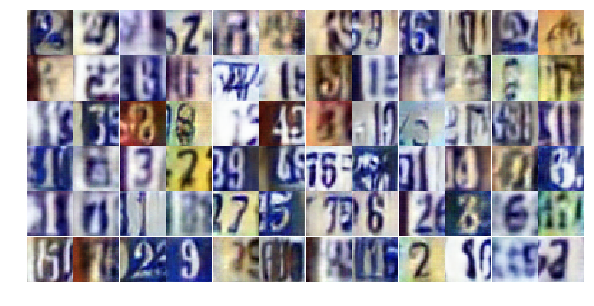

Epoch 18/25... Discriminator Loss: 0.7902... Generator Loss: 0.8336
Epoch 18/25... Discriminator Loss: 0.6435... Generator Loss: 1.0985
Epoch 18/25... Discriminator Loss: 0.5906... Generator Loss: 1.1396
Epoch 18/25... Discriminator Loss: 0.4738... Generator Loss: 1.3937
Epoch 18/25... Discriminator Loss: 0.7231... Generator Loss: 1.0796
Epoch 18/25... Discriminator Loss: 0.5177... Generator Loss: 1.2414
Epoch 18/25... Discriminator Loss: 0.9657... Generator Loss: 0.6405
Epoch 18/25... Discriminator Loss: 1.9375... Generator Loss: 3.5110
Epoch 18/25... Discriminator Loss: 0.8764... Generator Loss: 0.7753
Epoch 18/25... Discriminator Loss: 0.5112... Generator Loss: 1.3927


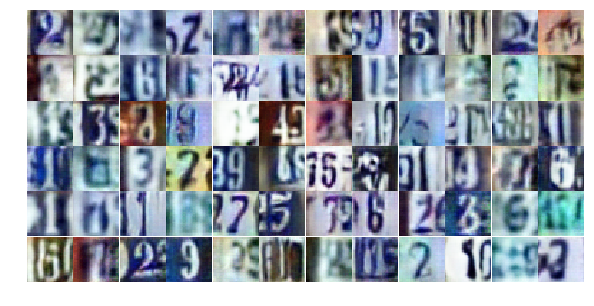

Epoch 18/25... Discriminator Loss: 0.7630... Generator Loss: 0.9146
Epoch 18/25... Discriminator Loss: 0.7021... Generator Loss: 0.9819
Epoch 18/25... Discriminator Loss: 0.6603... Generator Loss: 1.1186
Epoch 18/25... Discriminator Loss: 0.9265... Generator Loss: 0.7407
Epoch 18/25... Discriminator Loss: 0.6081... Generator Loss: 1.2819
Epoch 18/25... Discriminator Loss: 0.8768... Generator Loss: 2.6076
Epoch 18/25... Discriminator Loss: 2.9702... Generator Loss: 5.9493
Epoch 18/25... Discriminator Loss: 0.6466... Generator Loss: 1.7338
Epoch 18/25... Discriminator Loss: 1.1233... Generator Loss: 0.6814
Epoch 18/25... Discriminator Loss: 0.5229... Generator Loss: 1.2436


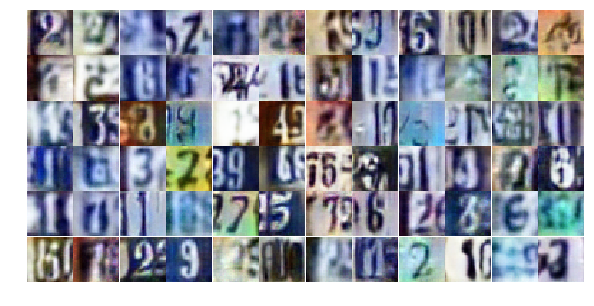

Epoch 18/25... Discriminator Loss: 0.7903... Generator Loss: 2.5270
Epoch 19/25... Discriminator Loss: 1.1193... Generator Loss: 0.6153
Epoch 19/25... Discriminator Loss: 1.5864... Generator Loss: 0.3497
Epoch 19/25... Discriminator Loss: 0.9518... Generator Loss: 0.7995
Epoch 19/25... Discriminator Loss: 0.8035... Generator Loss: 0.8681
Epoch 19/25... Discriminator Loss: 0.9696... Generator Loss: 0.6759
Epoch 19/25... Discriminator Loss: 0.4899... Generator Loss: 1.6492
Epoch 19/25... Discriminator Loss: 0.6607... Generator Loss: 1.0890
Epoch 19/25... Discriminator Loss: 0.8026... Generator Loss: 0.9215
Epoch 19/25... Discriminator Loss: 0.8510... Generator Loss: 0.7607


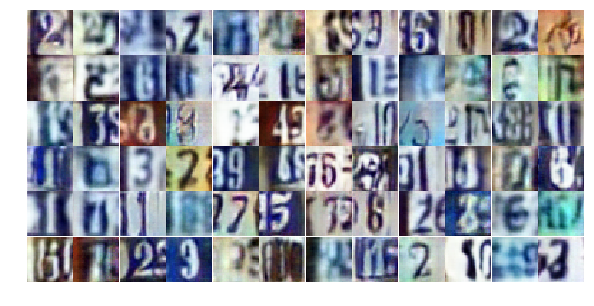

Epoch 19/25... Discriminator Loss: 0.7984... Generator Loss: 0.8342
Epoch 19/25... Discriminator Loss: 0.7000... Generator Loss: 1.0352
Epoch 19/25... Discriminator Loss: 0.8841... Generator Loss: 0.8551
Epoch 19/25... Discriminator Loss: 1.0724... Generator Loss: 0.6107
Epoch 19/25... Discriminator Loss: 0.6922... Generator Loss: 1.0337
Epoch 19/25... Discriminator Loss: 0.6219... Generator Loss: 1.1454
Epoch 19/25... Discriminator Loss: 1.4003... Generator Loss: 0.4038
Epoch 19/25... Discriminator Loss: 0.5858... Generator Loss: 1.1210
Epoch 19/25... Discriminator Loss: 0.8118... Generator Loss: 1.0474
Epoch 19/25... Discriminator Loss: 0.9028... Generator Loss: 0.7794


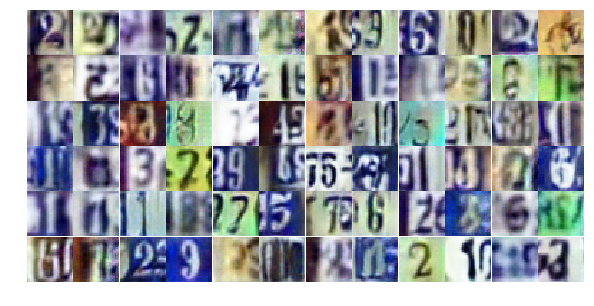

Epoch 19/25... Discriminator Loss: 0.8674... Generator Loss: 0.8141
Epoch 19/25... Discriminator Loss: 1.3961... Generator Loss: 0.4411
Epoch 19/25... Discriminator Loss: 1.4025... Generator Loss: 0.4231
Epoch 19/25... Discriminator Loss: 1.0373... Generator Loss: 0.6027
Epoch 19/25... Discriminator Loss: 1.4122... Generator Loss: 0.4189
Epoch 19/25... Discriminator Loss: 0.8174... Generator Loss: 1.2634
Epoch 19/25... Discriminator Loss: 0.6719... Generator Loss: 1.0566
Epoch 19/25... Discriminator Loss: 0.4973... Generator Loss: 1.3570
Epoch 19/25... Discriminator Loss: 0.7101... Generator Loss: 0.9072
Epoch 19/25... Discriminator Loss: 1.0141... Generator Loss: 0.6511


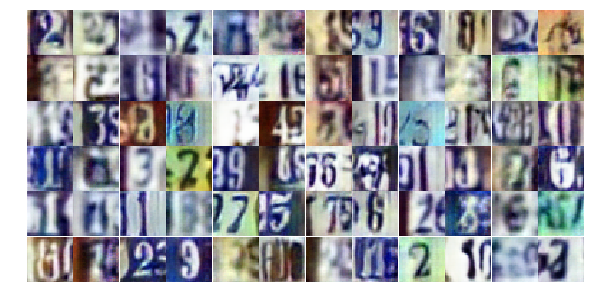

Epoch 19/25... Discriminator Loss: 0.7019... Generator Loss: 1.0342
Epoch 19/25... Discriminator Loss: 0.8593... Generator Loss: 0.7824
Epoch 19/25... Discriminator Loss: 0.8862... Generator Loss: 0.7381
Epoch 19/25... Discriminator Loss: 0.5519... Generator Loss: 1.2088
Epoch 19/25... Discriminator Loss: 0.5409... Generator Loss: 1.2889
Epoch 19/25... Discriminator Loss: 1.5641... Generator Loss: 0.3609
Epoch 19/25... Discriminator Loss: 1.2638... Generator Loss: 0.5357
Epoch 19/25... Discriminator Loss: 0.5764... Generator Loss: 1.2577
Epoch 19/25... Discriminator Loss: 0.9036... Generator Loss: 0.7869
Epoch 19/25... Discriminator Loss: 0.5990... Generator Loss: 1.2715


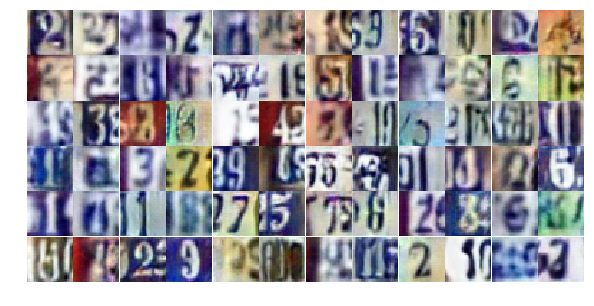

Epoch 19/25... Discriminator Loss: 0.7535... Generator Loss: 0.8532
Epoch 19/25... Discriminator Loss: 0.7271... Generator Loss: 0.9777
Epoch 19/25... Discriminator Loss: 0.9116... Generator Loss: 0.7450
Epoch 19/25... Discriminator Loss: 0.5237... Generator Loss: 1.3331
Epoch 19/25... Discriminator Loss: 0.8390... Generator Loss: 1.1590
Epoch 19/25... Discriminator Loss: 1.4915... Generator Loss: 3.1336
Epoch 19/25... Discriminator Loss: 0.8680... Generator Loss: 0.8733
Epoch 19/25... Discriminator Loss: 0.6654... Generator Loss: 1.0639
Epoch 19/25... Discriminator Loss: 0.6918... Generator Loss: 1.1649
Epoch 19/25... Discriminator Loss: 0.6829... Generator Loss: 1.1651


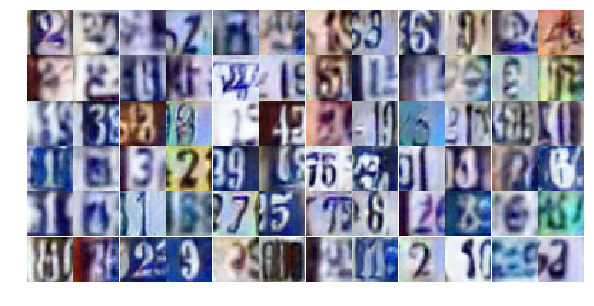

Epoch 19/25... Discriminator Loss: 0.6412... Generator Loss: 1.0465
Epoch 19/25... Discriminator Loss: 0.5475... Generator Loss: 1.4012
Epoch 19/25... Discriminator Loss: 0.6762... Generator Loss: 1.4898
Epoch 19/25... Discriminator Loss: 0.7382... Generator Loss: 0.8695
Epoch 19/25... Discriminator Loss: 0.7045... Generator Loss: 1.8052
Epoch 19/25... Discriminator Loss: 0.6406... Generator Loss: 1.1449
Epoch 19/25... Discriminator Loss: 1.7980... Generator Loss: 0.2749
Epoch 19/25... Discriminator Loss: 1.0023... Generator Loss: 0.6405
Epoch 20/25... Discriminator Loss: 0.7803... Generator Loss: 1.0459
Epoch 20/25... Discriminator Loss: 0.7779... Generator Loss: 0.8826


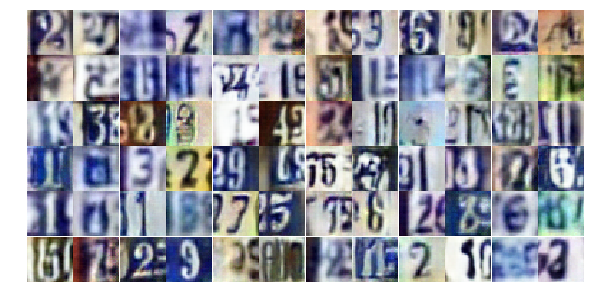

Epoch 20/25... Discriminator Loss: 0.8918... Generator Loss: 0.7306
Epoch 20/25... Discriminator Loss: 0.9566... Generator Loss: 0.6703
Epoch 20/25... Discriminator Loss: 1.1981... Generator Loss: 0.4865
Epoch 20/25... Discriminator Loss: 1.3481... Generator Loss: 0.4243
Epoch 20/25... Discriminator Loss: 0.5535... Generator Loss: 1.2659
Epoch 20/25... Discriminator Loss: 0.5703... Generator Loss: 1.1178
Epoch 20/25... Discriminator Loss: 0.6712... Generator Loss: 1.3547
Epoch 20/25... Discriminator Loss: 0.9374... Generator Loss: 0.6963
Epoch 20/25... Discriminator Loss: 0.7963... Generator Loss: 0.8603
Epoch 20/25... Discriminator Loss: 0.7194... Generator Loss: 0.9484


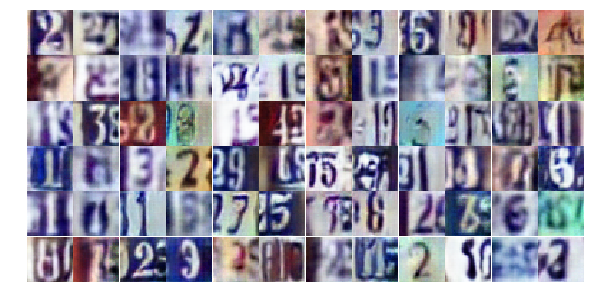

Epoch 20/25... Discriminator Loss: 0.7861... Generator Loss: 0.9416
Epoch 20/25... Discriminator Loss: 1.3786... Generator Loss: 0.4253
Epoch 20/25... Discriminator Loss: 0.6470... Generator Loss: 1.1654
Epoch 20/25... Discriminator Loss: 0.8780... Generator Loss: 0.8130
Epoch 20/25... Discriminator Loss: 1.7664... Generator Loss: 0.3012
Epoch 20/25... Discriminator Loss: 0.9317... Generator Loss: 2.1708
Epoch 20/25... Discriminator Loss: 1.4466... Generator Loss: 3.1543
Epoch 20/25... Discriminator Loss: 0.7698... Generator Loss: 1.1837
Epoch 20/25... Discriminator Loss: 0.9318... Generator Loss: 0.7087
Epoch 20/25... Discriminator Loss: 0.6834... Generator Loss: 1.0624


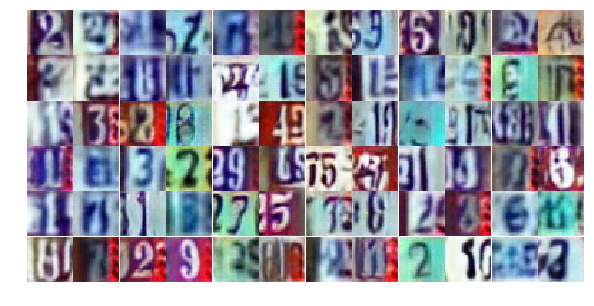

Epoch 20/25... Discriminator Loss: 0.3927... Generator Loss: 1.7826
Epoch 20/25... Discriminator Loss: 0.9420... Generator Loss: 0.8662
Epoch 20/25... Discriminator Loss: 0.3664... Generator Loss: 1.6865
Epoch 20/25... Discriminator Loss: 1.3039... Generator Loss: 0.5029
Epoch 20/25... Discriminator Loss: 1.1376... Generator Loss: 0.5514
Epoch 20/25... Discriminator Loss: 0.6027... Generator Loss: 1.1202
Epoch 20/25... Discriminator Loss: 0.4558... Generator Loss: 2.2275
Epoch 20/25... Discriminator Loss: 1.6483... Generator Loss: 0.3432
Epoch 20/25... Discriminator Loss: 0.8211... Generator Loss: 0.8438
Epoch 20/25... Discriminator Loss: 0.6193... Generator Loss: 1.0251


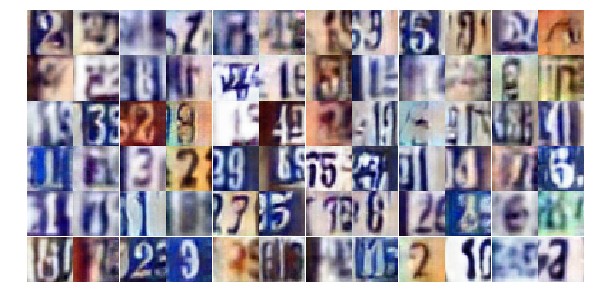

Epoch 20/25... Discriminator Loss: 0.5836... Generator Loss: 1.5763
Epoch 20/25... Discriminator Loss: 0.5869... Generator Loss: 1.2055
Epoch 20/25... Discriminator Loss: 1.6210... Generator Loss: 0.4308
Epoch 20/25... Discriminator Loss: 0.9200... Generator Loss: 0.9299
Epoch 20/25... Discriminator Loss: 0.7923... Generator Loss: 0.8760
Epoch 20/25... Discriminator Loss: 0.6892... Generator Loss: 1.0605
Epoch 20/25... Discriminator Loss: 0.7447... Generator Loss: 1.0094
Epoch 20/25... Discriminator Loss: 0.9336... Generator Loss: 0.7792
Epoch 20/25... Discriminator Loss: 0.6525... Generator Loss: 1.0666
Epoch 20/25... Discriminator Loss: 1.0417... Generator Loss: 0.6296


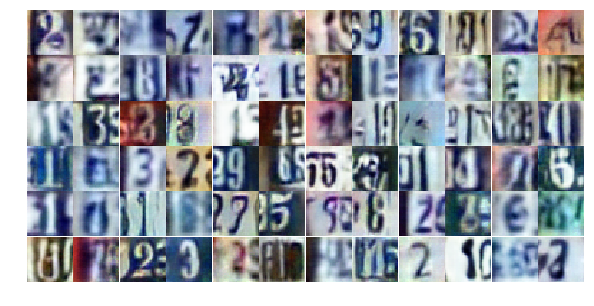

Epoch 20/25... Discriminator Loss: 1.5740... Generator Loss: 0.3572
Epoch 20/25... Discriminator Loss: 0.8519... Generator Loss: 0.8500
Epoch 20/25... Discriminator Loss: 0.6580... Generator Loss: 1.7726
Epoch 20/25... Discriminator Loss: 0.9981... Generator Loss: 0.7415
Epoch 20/25... Discriminator Loss: 0.9632... Generator Loss: 0.7238
Epoch 20/25... Discriminator Loss: 1.0599... Generator Loss: 0.6743
Epoch 20/25... Discriminator Loss: 0.9006... Generator Loss: 0.7622
Epoch 20/25... Discriminator Loss: 0.4866... Generator Loss: 1.5455
Epoch 20/25... Discriminator Loss: 0.8115... Generator Loss: 0.8312
Epoch 20/25... Discriminator Loss: 0.8065... Generator Loss: 0.9016


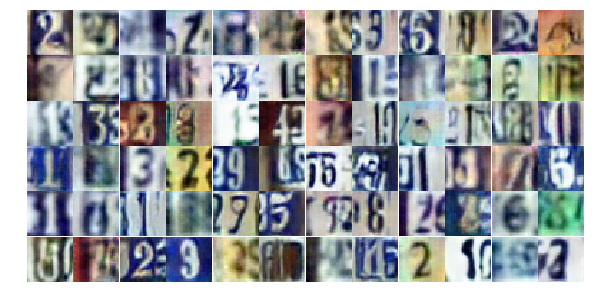

Epoch 20/25... Discriminator Loss: 0.5213... Generator Loss: 1.4761
Epoch 20/25... Discriminator Loss: 0.8764... Generator Loss: 0.8938
Epoch 20/25... Discriminator Loss: 0.4723... Generator Loss: 1.6707
Epoch 20/25... Discriminator Loss: 0.7175... Generator Loss: 2.1213
Epoch 20/25... Discriminator Loss: 0.5742... Generator Loss: 1.1346
Epoch 20/25... Discriminator Loss: 0.4912... Generator Loss: 1.3953
Epoch 21/25... Discriminator Loss: 1.0283... Generator Loss: 0.6378
Epoch 21/25... Discriminator Loss: 0.6776... Generator Loss: 0.9819
Epoch 21/25... Discriminator Loss: 1.5573... Generator Loss: 0.4120
Epoch 21/25... Discriminator Loss: 0.8979... Generator Loss: 0.7995


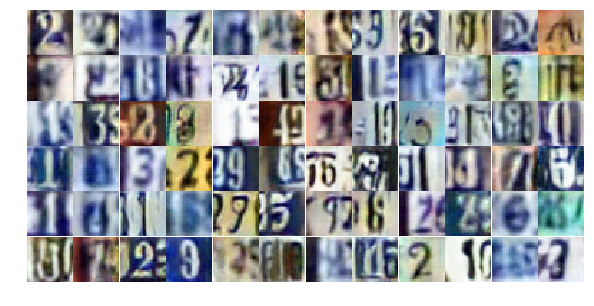

Epoch 21/25... Discriminator Loss: 0.6764... Generator Loss: 1.4301
Epoch 21/25... Discriminator Loss: 1.3436... Generator Loss: 0.5080
Epoch 21/25... Discriminator Loss: 0.3979... Generator Loss: 1.7917
Epoch 21/25... Discriminator Loss: 0.3548... Generator Loss: 1.6558
Epoch 21/25... Discriminator Loss: 0.6225... Generator Loss: 1.2042
Epoch 21/25... Discriminator Loss: 0.4086... Generator Loss: 1.5810
Epoch 21/25... Discriminator Loss: 1.0882... Generator Loss: 0.6094
Epoch 21/25... Discriminator Loss: 1.8337... Generator Loss: 0.2987
Epoch 21/25... Discriminator Loss: 0.6609... Generator Loss: 0.9708
Epoch 21/25... Discriminator Loss: 1.2425... Generator Loss: 0.4994


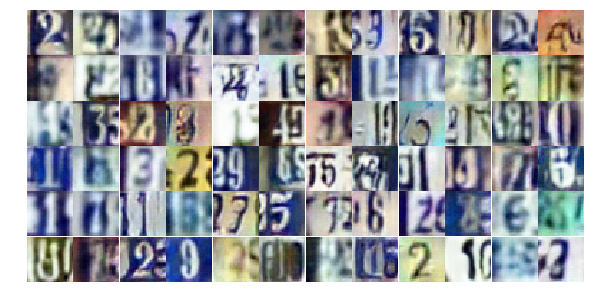

Epoch 21/25... Discriminator Loss: 0.3614... Generator Loss: 2.2365
Epoch 21/25... Discriminator Loss: 1.0082... Generator Loss: 0.6588
Epoch 21/25... Discriminator Loss: 1.8929... Generator Loss: 0.3275
Epoch 21/25... Discriminator Loss: 2.4727... Generator Loss: 0.2758
Epoch 21/25... Discriminator Loss: 0.8719... Generator Loss: 2.2653
Epoch 21/25... Discriminator Loss: 1.4509... Generator Loss: 0.4379
Epoch 21/25... Discriminator Loss: 1.1753... Generator Loss: 0.5417
Epoch 21/25... Discriminator Loss: 0.5539... Generator Loss: 1.2541
Epoch 21/25... Discriminator Loss: 0.4722... Generator Loss: 1.5950
Epoch 21/25... Discriminator Loss: 0.7287... Generator Loss: 0.9498


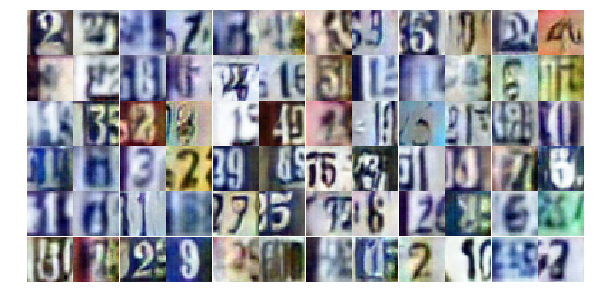

Epoch 21/25... Discriminator Loss: 1.1735... Generator Loss: 0.5705
Epoch 21/25... Discriminator Loss: 0.3876... Generator Loss: 2.0154
Epoch 21/25... Discriminator Loss: 0.9465... Generator Loss: 0.6809
Epoch 21/25... Discriminator Loss: 1.0152... Generator Loss: 0.6195
Epoch 21/25... Discriminator Loss: 0.9132... Generator Loss: 0.7778
Epoch 21/25... Discriminator Loss: 1.2038... Generator Loss: 0.6072
Epoch 21/25... Discriminator Loss: 0.5779... Generator Loss: 1.1513
Epoch 21/25... Discriminator Loss: 1.1118... Generator Loss: 0.5946
Epoch 21/25... Discriminator Loss: 1.0093... Generator Loss: 0.6653
Epoch 21/25... Discriminator Loss: 1.5117... Generator Loss: 0.4272


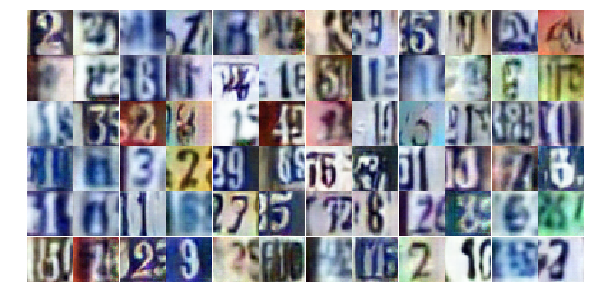

Epoch 21/25... Discriminator Loss: 1.4618... Generator Loss: 0.3768
Epoch 21/25... Discriminator Loss: 0.9908... Generator Loss: 0.6826
Epoch 21/25... Discriminator Loss: 1.3330... Generator Loss: 0.4354
Epoch 21/25... Discriminator Loss: 0.4012... Generator Loss: 1.5241
Epoch 21/25... Discriminator Loss: 0.5805... Generator Loss: 1.1527
Epoch 21/25... Discriminator Loss: 1.1274... Generator Loss: 0.5710
Epoch 21/25... Discriminator Loss: 1.0254... Generator Loss: 0.6616
Epoch 21/25... Discriminator Loss: 1.5353... Generator Loss: 0.3868
Epoch 21/25... Discriminator Loss: 0.7715... Generator Loss: 0.9376
Epoch 21/25... Discriminator Loss: 0.3994... Generator Loss: 2.1667


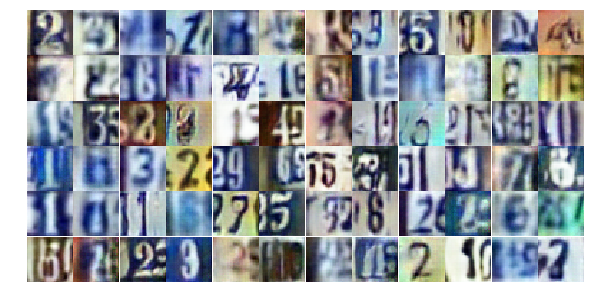

Epoch 21/25... Discriminator Loss: 0.9331... Generator Loss: 0.6589
Epoch 21/25... Discriminator Loss: 0.9830... Generator Loss: 0.7257
Epoch 21/25... Discriminator Loss: 1.6408... Generator Loss: 0.3263
Epoch 21/25... Discriminator Loss: 1.1288... Generator Loss: 0.5950
Epoch 21/25... Discriminator Loss: 0.3868... Generator Loss: 2.2633
Epoch 21/25... Discriminator Loss: 0.6504... Generator Loss: 1.2261
Epoch 21/25... Discriminator Loss: 0.9799... Generator Loss: 0.6464
Epoch 21/25... Discriminator Loss: 1.0963... Generator Loss: 0.6778
Epoch 21/25... Discriminator Loss: 0.7073... Generator Loss: 0.9771
Epoch 21/25... Discriminator Loss: 0.9339... Generator Loss: 0.7876


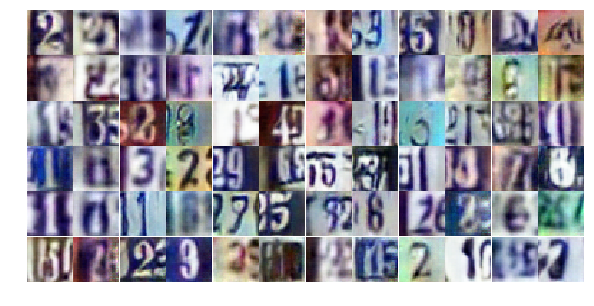

Epoch 21/25... Discriminator Loss: 0.5260... Generator Loss: 2.0372
Epoch 21/25... Discriminator Loss: 0.7733... Generator Loss: 0.9177
Epoch 21/25... Discriminator Loss: 0.8901... Generator Loss: 0.8803
Epoch 22/25... Discriminator Loss: 0.6883... Generator Loss: 2.0787
Epoch 22/25... Discriminator Loss: 0.9144... Generator Loss: 0.8544
Epoch 22/25... Discriminator Loss: 0.5968... Generator Loss: 1.2604
Epoch 22/25... Discriminator Loss: 0.6280... Generator Loss: 1.1636
Epoch 22/25... Discriminator Loss: 0.6432... Generator Loss: 1.1390
Epoch 22/25... Discriminator Loss: 0.8928... Generator Loss: 0.7146
Epoch 22/25... Discriminator Loss: 0.7461... Generator Loss: 1.2078


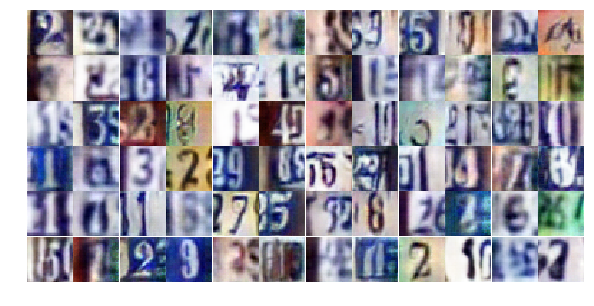

Epoch 22/25... Discriminator Loss: 0.7001... Generator Loss: 1.8835
Epoch 22/25... Discriminator Loss: 0.8633... Generator Loss: 0.8180
Epoch 22/25... Discriminator Loss: 1.3319... Generator Loss: 0.5030
Epoch 22/25... Discriminator Loss: 0.9402... Generator Loss: 0.6461
Epoch 22/25... Discriminator Loss: 1.0577... Generator Loss: 0.7354
Epoch 22/25... Discriminator Loss: 0.6008... Generator Loss: 1.0445
Epoch 22/25... Discriminator Loss: 0.7799... Generator Loss: 0.9205
Epoch 22/25... Discriminator Loss: 0.5938... Generator Loss: 1.9325
Epoch 22/25... Discriminator Loss: 1.1682... Generator Loss: 0.5577
Epoch 22/25... Discriminator Loss: 1.5305... Generator Loss: 0.4448


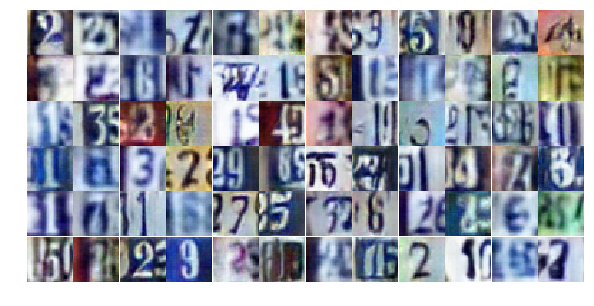

Epoch 22/25... Discriminator Loss: 0.5204... Generator Loss: 1.4648
Epoch 22/25... Discriminator Loss: 0.5576... Generator Loss: 1.1716
Epoch 22/25... Discriminator Loss: 1.0283... Generator Loss: 0.6236
Epoch 22/25... Discriminator Loss: 0.4524... Generator Loss: 1.5536
Epoch 22/25... Discriminator Loss: 0.5348... Generator Loss: 1.2189
Epoch 22/25... Discriminator Loss: 0.6953... Generator Loss: 1.0618
Epoch 22/25... Discriminator Loss: 0.5148... Generator Loss: 1.2905
Epoch 22/25... Discriminator Loss: 0.3895... Generator Loss: 1.6424
Epoch 22/25... Discriminator Loss: 0.4958... Generator Loss: 1.6201
Epoch 22/25... Discriminator Loss: 1.1436... Generator Loss: 0.5764


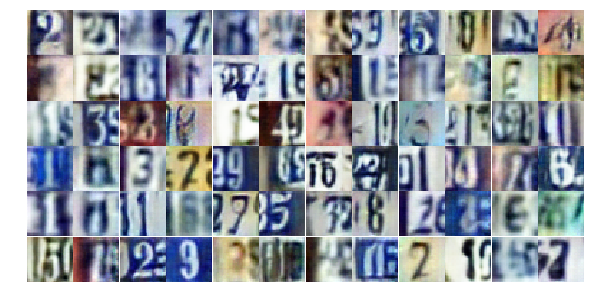

Epoch 22/25... Discriminator Loss: 0.5622... Generator Loss: 1.1838
Epoch 22/25... Discriminator Loss: 0.7822... Generator Loss: 0.8340
Epoch 22/25... Discriminator Loss: 0.7329... Generator Loss: 1.0217
Epoch 22/25... Discriminator Loss: 0.6097... Generator Loss: 1.0795
Epoch 22/25... Discriminator Loss: 0.9144... Generator Loss: 0.7458
Epoch 22/25... Discriminator Loss: 0.7762... Generator Loss: 0.8860
Epoch 22/25... Discriminator Loss: 1.5404... Generator Loss: 0.3700
Epoch 22/25... Discriminator Loss: 1.6755... Generator Loss: 3.9443
Epoch 22/25... Discriminator Loss: 0.9375... Generator Loss: 0.9501
Epoch 22/25... Discriminator Loss: 1.2191... Generator Loss: 0.5392


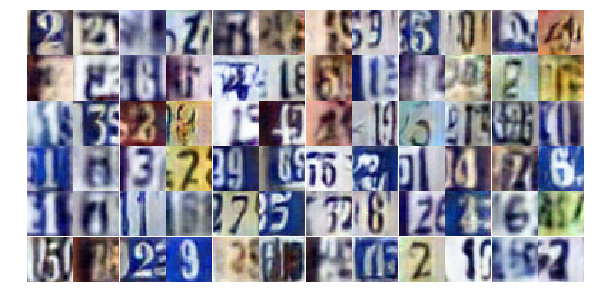

Epoch 22/25... Discriminator Loss: 1.0077... Generator Loss: 0.8182
Epoch 22/25... Discriminator Loss: 0.6412... Generator Loss: 1.0085
Epoch 22/25... Discriminator Loss: 0.3548... Generator Loss: 1.8164
Epoch 22/25... Discriminator Loss: 0.7648... Generator Loss: 0.8899
Epoch 22/25... Discriminator Loss: 0.6534... Generator Loss: 0.9644
Epoch 22/25... Discriminator Loss: 0.4708... Generator Loss: 1.3313
Epoch 22/25... Discriminator Loss: 0.8531... Generator Loss: 0.9334
Epoch 22/25... Discriminator Loss: 0.9939... Generator Loss: 0.7016
Epoch 22/25... Discriminator Loss: 0.9584... Generator Loss: 0.7382
Epoch 22/25... Discriminator Loss: 0.7479... Generator Loss: 0.9448


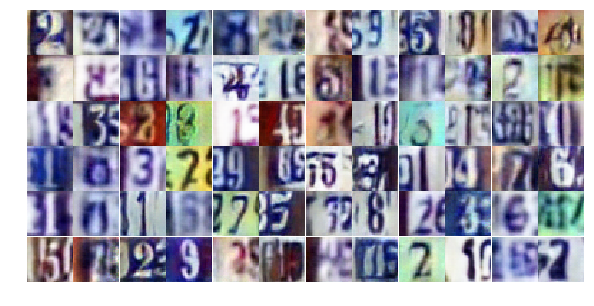

Epoch 22/25... Discriminator Loss: 1.1539... Generator Loss: 0.5045
Epoch 22/25... Discriminator Loss: 0.4538... Generator Loss: 1.3862
Epoch 22/25... Discriminator Loss: 0.6627... Generator Loss: 1.0186
Epoch 22/25... Discriminator Loss: 0.9606... Generator Loss: 0.7429
Epoch 22/25... Discriminator Loss: 0.9228... Generator Loss: 0.7533
Epoch 22/25... Discriminator Loss: 0.7242... Generator Loss: 0.9492
Epoch 22/25... Discriminator Loss: 1.0384... Generator Loss: 0.6101
Epoch 22/25... Discriminator Loss: 0.6499... Generator Loss: 1.1697
Epoch 22/25... Discriminator Loss: 1.2002... Generator Loss: 2.6187
Epoch 22/25... Discriminator Loss: 1.0682... Generator Loss: 0.6791


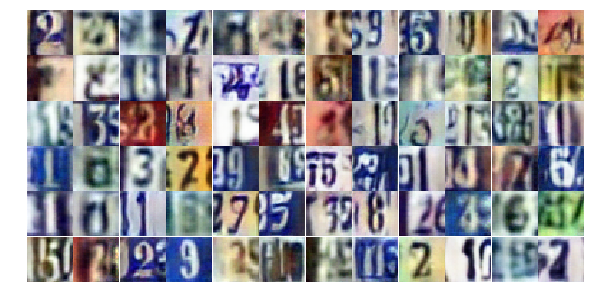

Epoch 23/25... Discriminator Loss: 0.5037... Generator Loss: 1.4451
Epoch 23/25... Discriminator Loss: 0.4286... Generator Loss: 1.4149
Epoch 23/25... Discriminator Loss: 1.7485... Generator Loss: 0.2759
Epoch 23/25... Discriminator Loss: 0.7194... Generator Loss: 1.0449
Epoch 23/25... Discriminator Loss: 0.6527... Generator Loss: 1.0560
Epoch 23/25... Discriminator Loss: 1.7007... Generator Loss: 0.3345
Epoch 23/25... Discriminator Loss: 0.9734... Generator Loss: 0.7359
Epoch 23/25... Discriminator Loss: 0.5564... Generator Loss: 1.2627
Epoch 23/25... Discriminator Loss: 0.5358... Generator Loss: 1.6608
Epoch 23/25... Discriminator Loss: 0.5425... Generator Loss: 1.3360


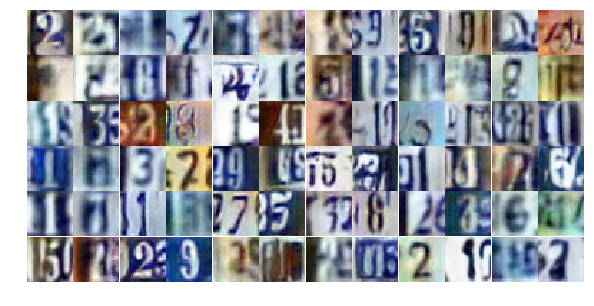

Epoch 23/25... Discriminator Loss: 0.7181... Generator Loss: 0.9106
Epoch 23/25... Discriminator Loss: 0.8001... Generator Loss: 0.7776
Epoch 23/25... Discriminator Loss: 0.6508... Generator Loss: 1.2289
Epoch 23/25... Discriminator Loss: 0.7645... Generator Loss: 0.9104
Epoch 23/25... Discriminator Loss: 0.7267... Generator Loss: 0.9813
Epoch 23/25... Discriminator Loss: 1.1046... Generator Loss: 0.5806
Epoch 23/25... Discriminator Loss: 1.0121... Generator Loss: 0.6712
Epoch 23/25... Discriminator Loss: 0.6090... Generator Loss: 1.5054
Epoch 23/25... Discriminator Loss: 1.4832... Generator Loss: 0.4404
Epoch 23/25... Discriminator Loss: 1.0024... Generator Loss: 0.6740


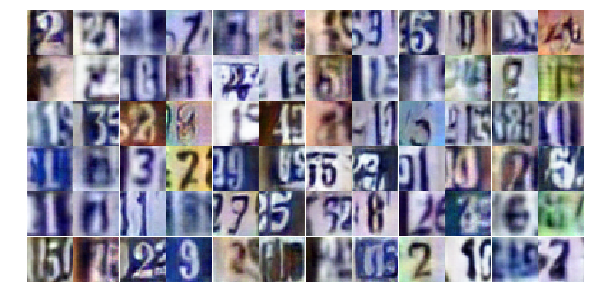

Epoch 23/25... Discriminator Loss: 1.0924... Generator Loss: 0.6136
Epoch 23/25... Discriminator Loss: 0.6638... Generator Loss: 0.9767
Epoch 23/25... Discriminator Loss: 1.0028... Generator Loss: 0.6457
Epoch 23/25... Discriminator Loss: 0.7508... Generator Loss: 0.9759
Epoch 23/25... Discriminator Loss: 0.4758... Generator Loss: 1.4753
Epoch 23/25... Discriminator Loss: 0.7773... Generator Loss: 0.9288
Epoch 23/25... Discriminator Loss: 0.7378... Generator Loss: 0.9448
Epoch 23/25... Discriminator Loss: 0.8963... Generator Loss: 0.7811
Epoch 23/25... Discriminator Loss: 0.7450... Generator Loss: 0.9483
Epoch 23/25... Discriminator Loss: 0.7008... Generator Loss: 1.4470


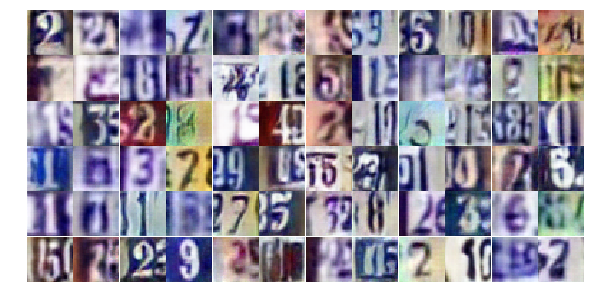

Epoch 23/25... Discriminator Loss: 0.4665... Generator Loss: 1.6235
Epoch 23/25... Discriminator Loss: 0.6409... Generator Loss: 1.1574
Epoch 23/25... Discriminator Loss: 0.6834... Generator Loss: 0.9871
Epoch 23/25... Discriminator Loss: 1.0732... Generator Loss: 0.6509
Epoch 23/25... Discriminator Loss: 2.0711... Generator Loss: 0.2148
Epoch 23/25... Discriminator Loss: 2.2373... Generator Loss: 0.2994
Epoch 23/25... Discriminator Loss: 2.9312... Generator Loss: 4.8047
Epoch 23/25... Discriminator Loss: 0.9046... Generator Loss: 1.0067
Epoch 23/25... Discriminator Loss: 0.6338... Generator Loss: 1.3802
Epoch 23/25... Discriminator Loss: 0.6788... Generator Loss: 1.1211


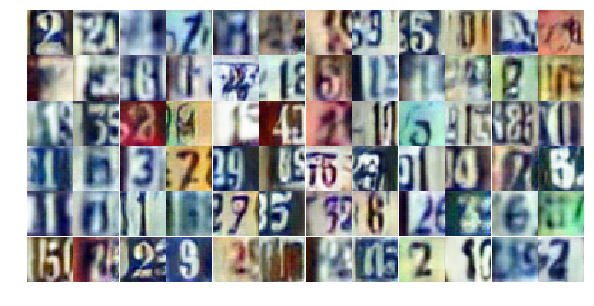

Epoch 23/25... Discriminator Loss: 0.7869... Generator Loss: 0.9550
Epoch 23/25... Discriminator Loss: 0.9486... Generator Loss: 0.7252
Epoch 23/25... Discriminator Loss: 1.6035... Generator Loss: 0.4142
Epoch 23/25... Discriminator Loss: 0.8208... Generator Loss: 2.4487
Epoch 23/25... Discriminator Loss: 0.6572... Generator Loss: 1.1441
Epoch 23/25... Discriminator Loss: 1.0699... Generator Loss: 0.5906
Epoch 23/25... Discriminator Loss: 0.7630... Generator Loss: 1.0586
Epoch 23/25... Discriminator Loss: 1.1841... Generator Loss: 0.6121
Epoch 23/25... Discriminator Loss: 0.7389... Generator Loss: 1.1100
Epoch 23/25... Discriminator Loss: 0.7814... Generator Loss: 0.9663


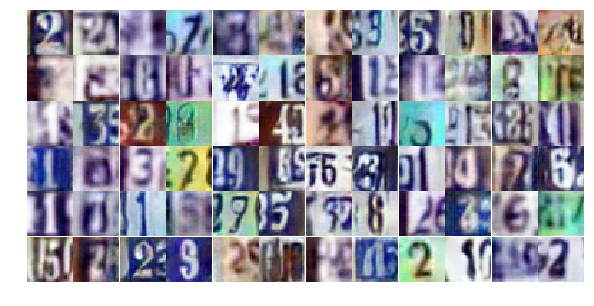

Epoch 23/25... Discriminator Loss: 0.6487... Generator Loss: 1.0423
Epoch 23/25... Discriminator Loss: 1.2955... Generator Loss: 0.4514
Epoch 23/25... Discriminator Loss: 1.1537... Generator Loss: 0.5877
Epoch 23/25... Discriminator Loss: 0.4736... Generator Loss: 1.8166
Epoch 23/25... Discriminator Loss: 1.0599... Generator Loss: 0.7103
Epoch 23/25... Discriminator Loss: 0.5318... Generator Loss: 1.8126
Epoch 23/25... Discriminator Loss: 0.8872... Generator Loss: 0.7270
Epoch 24/25... Discriminator Loss: 0.7504... Generator Loss: 0.9445
Epoch 24/25... Discriminator Loss: 0.6457... Generator Loss: 1.5661
Epoch 24/25... Discriminator Loss: 0.7386... Generator Loss: 1.0007


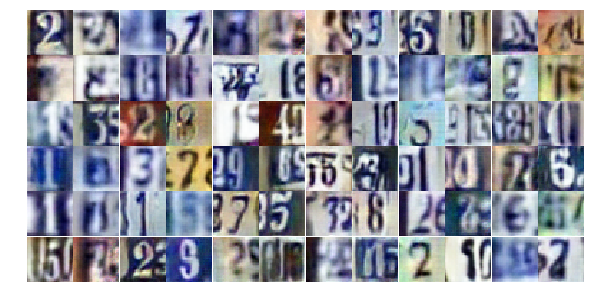

Epoch 24/25... Discriminator Loss: 0.5271... Generator Loss: 1.4859
Epoch 24/25... Discriminator Loss: 0.7183... Generator Loss: 0.9292
Epoch 24/25... Discriminator Loss: 0.6326... Generator Loss: 1.0239
Epoch 24/25... Discriminator Loss: 0.8968... Generator Loss: 2.3951
Epoch 24/25... Discriminator Loss: 0.6784... Generator Loss: 1.0300
Epoch 24/25... Discriminator Loss: 0.5444... Generator Loss: 1.3943
Epoch 24/25... Discriminator Loss: 0.6234... Generator Loss: 1.2766
Epoch 24/25... Discriminator Loss: 1.1245... Generator Loss: 0.6112
Epoch 24/25... Discriminator Loss: 0.5479... Generator Loss: 1.1604
Epoch 24/25... Discriminator Loss: 0.4767... Generator Loss: 1.3261


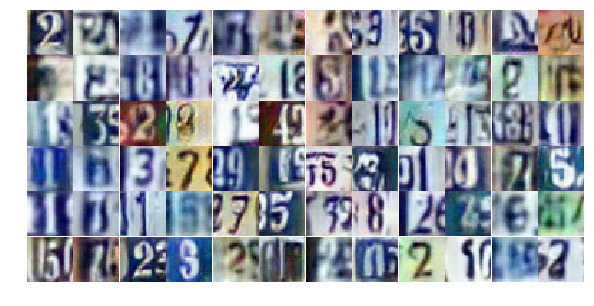

Epoch 24/25... Discriminator Loss: 1.4344... Generator Loss: 0.3995
Epoch 24/25... Discriminator Loss: 1.3538... Generator Loss: 0.4547
Epoch 24/25... Discriminator Loss: 1.1481... Generator Loss: 0.5475
Epoch 24/25... Discriminator Loss: 0.7062... Generator Loss: 0.8721
Epoch 24/25... Discriminator Loss: 0.6486... Generator Loss: 2.2310
Epoch 24/25... Discriminator Loss: 0.6285... Generator Loss: 1.8809
Epoch 24/25... Discriminator Loss: 0.6135... Generator Loss: 1.3286
Epoch 24/25... Discriminator Loss: 1.7352... Generator Loss: 0.2691
Epoch 24/25... Discriminator Loss: 1.1159... Generator Loss: 0.6153
Epoch 24/25... Discriminator Loss: 1.3389... Generator Loss: 0.4844


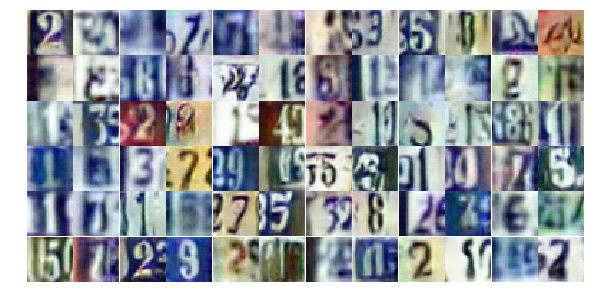

Epoch 24/25... Discriminator Loss: 0.8432... Generator Loss: 0.8072
Epoch 24/25... Discriminator Loss: 0.6263... Generator Loss: 1.1699
Epoch 24/25... Discriminator Loss: 0.5191... Generator Loss: 1.8599
Epoch 24/25... Discriminator Loss: 1.6168... Generator Loss: 0.3386
Epoch 24/25... Discriminator Loss: 0.9691... Generator Loss: 0.6567
Epoch 24/25... Discriminator Loss: 0.4342... Generator Loss: 1.3911
Epoch 24/25... Discriminator Loss: 0.4474... Generator Loss: 1.3459
Epoch 24/25... Discriminator Loss: 0.5152... Generator Loss: 1.9366
Epoch 24/25... Discriminator Loss: 0.6820... Generator Loss: 1.1957
Epoch 24/25... Discriminator Loss: 0.9314... Generator Loss: 0.7228


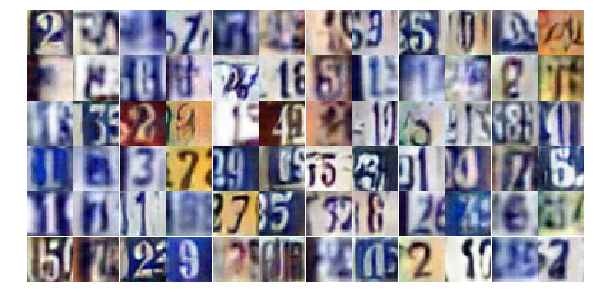

Epoch 24/25... Discriminator Loss: 0.4374... Generator Loss: 1.8972
Epoch 24/25... Discriminator Loss: 0.3893... Generator Loss: 1.6411
Epoch 24/25... Discriminator Loss: 0.9476... Generator Loss: 0.6937
Epoch 24/25... Discriminator Loss: 1.4155... Generator Loss: 0.4165
Epoch 24/25... Discriminator Loss: 0.5790... Generator Loss: 1.2765
Epoch 24/25... Discriminator Loss: 0.7063... Generator Loss: 0.9320
Epoch 24/25... Discriminator Loss: 1.2739... Generator Loss: 0.5164
Epoch 24/25... Discriminator Loss: 0.9797... Generator Loss: 0.6703
Epoch 24/25... Discriminator Loss: 0.6525... Generator Loss: 1.4107
Epoch 24/25... Discriminator Loss: 0.5550... Generator Loss: 1.8558


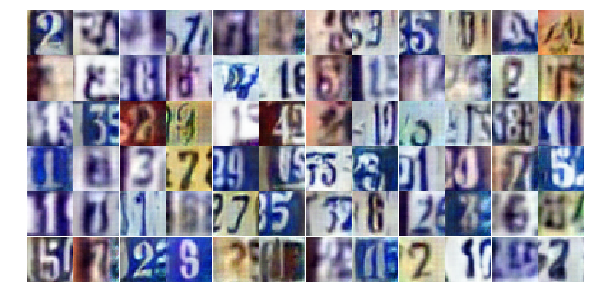

Epoch 24/25... Discriminator Loss: 0.7670... Generator Loss: 0.9421
Epoch 24/25... Discriminator Loss: 1.8834... Generator Loss: 0.2912
Epoch 24/25... Discriminator Loss: 1.4181... Generator Loss: 0.4248
Epoch 24/25... Discriminator Loss: 1.6072... Generator Loss: 0.3564
Epoch 24/25... Discriminator Loss: 1.3603... Generator Loss: 0.4219
Epoch 24/25... Discriminator Loss: 0.7058... Generator Loss: 1.0845
Epoch 24/25... Discriminator Loss: 0.9516... Generator Loss: 0.7202
Epoch 24/25... Discriminator Loss: 0.6053... Generator Loss: 1.1000
Epoch 24/25... Discriminator Loss: 0.8531... Generator Loss: 0.8919
Epoch 24/25... Discriminator Loss: 1.0686... Generator Loss: 0.6886


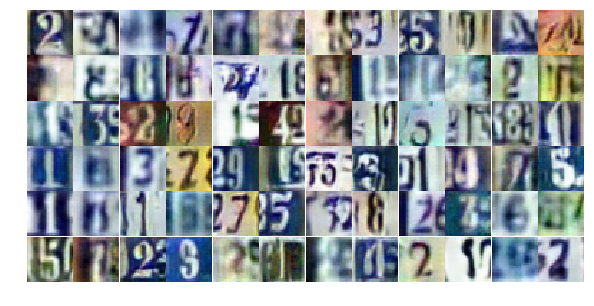

Epoch 24/25... Discriminator Loss: 1.2947... Generator Loss: 0.4990
Epoch 24/25... Discriminator Loss: 1.0094... Generator Loss: 0.6871
Epoch 24/25... Discriminator Loss: 1.1354... Generator Loss: 0.6349
Epoch 24/25... Discriminator Loss: 2.2488... Generator Loss: 0.1723
Epoch 24/25... Discriminator Loss: 0.7642... Generator Loss: 1.2022
Epoch 25/25... Discriminator Loss: 0.9445... Generator Loss: 0.8457
Epoch 25/25... Discriminator Loss: 0.5165... Generator Loss: 1.4839
Epoch 25/25... Discriminator Loss: 0.9764... Generator Loss: 0.6922
Epoch 25/25... Discriminator Loss: 0.9824... Generator Loss: 0.6664
Epoch 25/25... Discriminator Loss: 1.1213... Generator Loss: 0.5758


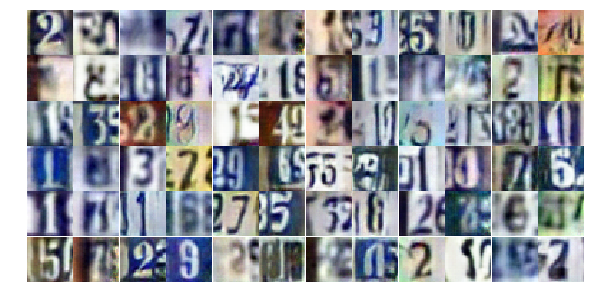

Epoch 25/25... Discriminator Loss: 1.1932... Generator Loss: 0.5567
Epoch 25/25... Discriminator Loss: 0.9953... Generator Loss: 0.7982
Epoch 25/25... Discriminator Loss: 0.7962... Generator Loss: 0.8730
Epoch 25/25... Discriminator Loss: 0.7949... Generator Loss: 0.8700
Epoch 25/25... Discriminator Loss: 0.7012... Generator Loss: 1.1139
Epoch 25/25... Discriminator Loss: 1.2520... Generator Loss: 0.4801
Epoch 25/25... Discriminator Loss: 0.9320... Generator Loss: 0.7776
Epoch 25/25... Discriminator Loss: 0.7757... Generator Loss: 1.1055
Epoch 25/25... Discriminator Loss: 0.5457... Generator Loss: 1.1840
Epoch 25/25... Discriminator Loss: 0.8836... Generator Loss: 0.9082


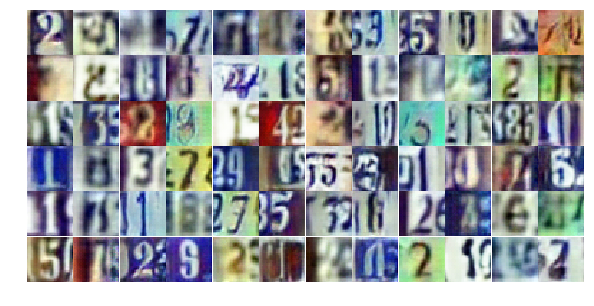

Epoch 25/25... Discriminator Loss: 0.6021... Generator Loss: 1.4277
Epoch 25/25... Discriminator Loss: 0.9846... Generator Loss: 3.6726
Epoch 25/25... Discriminator Loss: 1.4925... Generator Loss: 0.4200
Epoch 25/25... Discriminator Loss: 0.8310... Generator Loss: 0.9190
Epoch 25/25... Discriminator Loss: 1.0119... Generator Loss: 0.6759
Epoch 25/25... Discriminator Loss: 0.4718... Generator Loss: 1.6862
Epoch 25/25... Discriminator Loss: 0.8761... Generator Loss: 0.8774
Epoch 25/25... Discriminator Loss: 0.9952... Generator Loss: 0.8993
Epoch 25/25... Discriminator Loss: 0.6014... Generator Loss: 1.1776
Epoch 25/25... Discriminator Loss: 1.7399... Generator Loss: 0.3193


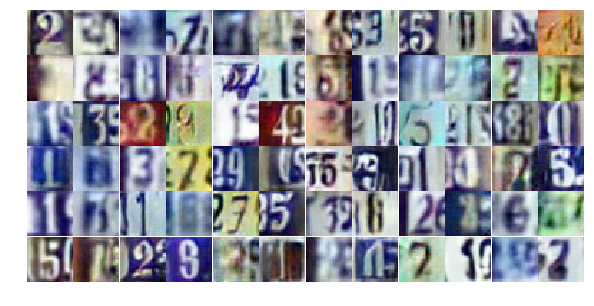

Epoch 25/25... Discriminator Loss: 1.2252... Generator Loss: 0.5840
Epoch 25/25... Discriminator Loss: 0.9482... Generator Loss: 0.7679
Epoch 25/25... Discriminator Loss: 1.4203... Generator Loss: 0.5425
Epoch 25/25... Discriminator Loss: 0.7021... Generator Loss: 1.3698
Epoch 25/25... Discriminator Loss: 0.6619... Generator Loss: 1.6234
Epoch 25/25... Discriminator Loss: 0.6091... Generator Loss: 1.0990
Epoch 25/25... Discriminator Loss: 0.6894... Generator Loss: 1.1106
Epoch 25/25... Discriminator Loss: 0.5115... Generator Loss: 1.3387
Epoch 25/25... Discriminator Loss: 0.7749... Generator Loss: 1.0524
Epoch 25/25... Discriminator Loss: 0.4124... Generator Loss: 1.5648


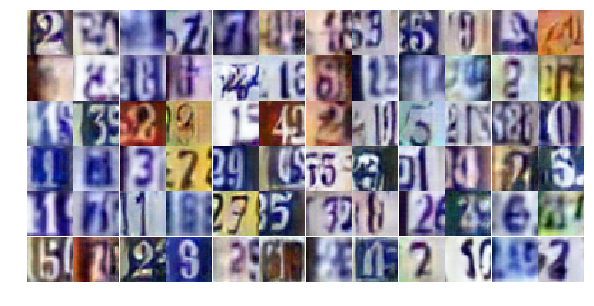

Epoch 25/25... Discriminator Loss: 0.4542... Generator Loss: 1.4690
Epoch 25/25... Discriminator Loss: 0.4937... Generator Loss: 1.2627
Epoch 25/25... Discriminator Loss: 0.6327... Generator Loss: 2.4718
Epoch 25/25... Discriminator Loss: 0.9208... Generator Loss: 0.9232
Epoch 25/25... Discriminator Loss: 1.7977... Generator Loss: 0.4383
Epoch 25/25... Discriminator Loss: 0.8427... Generator Loss: 0.9190
Epoch 25/25... Discriminator Loss: 0.7159... Generator Loss: 1.0409
Epoch 25/25... Discriminator Loss: 0.7755... Generator Loss: 0.8783
Epoch 25/25... Discriminator Loss: 1.6175... Generator Loss: 0.4400
Epoch 25/25... Discriminator Loss: 0.6954... Generator Loss: 0.9454


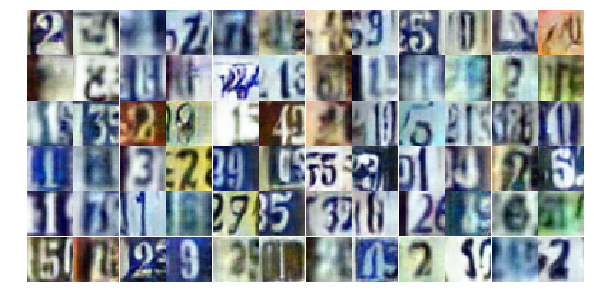

Epoch 25/25... Discriminator Loss: 0.7476... Generator Loss: 1.1384
Epoch 25/25... Discriminator Loss: 0.8645... Generator Loss: 0.7686
Epoch 25/25... Discriminator Loss: 1.3212... Generator Loss: 0.4642
Epoch 25/25... Discriminator Loss: 0.8848... Generator Loss: 0.7745
Epoch 25/25... Discriminator Loss: 0.9573... Generator Loss: 0.7271
Epoch 25/25... Discriminator Loss: 0.4867... Generator Loss: 1.2983
Epoch 25/25... Discriminator Loss: 1.3354... Generator Loss: 0.4399
Epoch 25/25... Discriminator Loss: 0.7627... Generator Loss: 0.9296
Epoch 25/25... Discriminator Loss: 5.0663... Generator Loss: 6.3771
Epoch 25/25... Discriminator Loss: 1.8486... Generator Loss: 0.4123


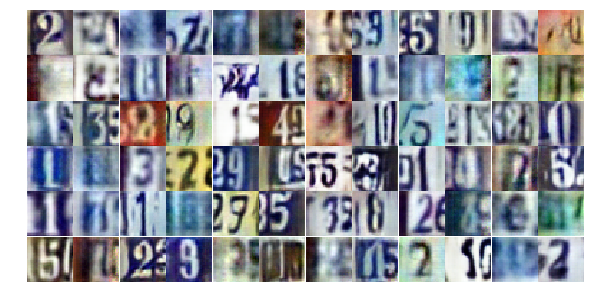

Epoch 25/25... Discriminator Loss: 0.6500... Generator Loss: 1.4701
Epoch 25/25... Discriminator Loss: 1.6648... Generator Loss: 0.3495


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

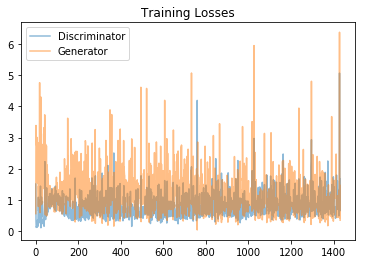

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

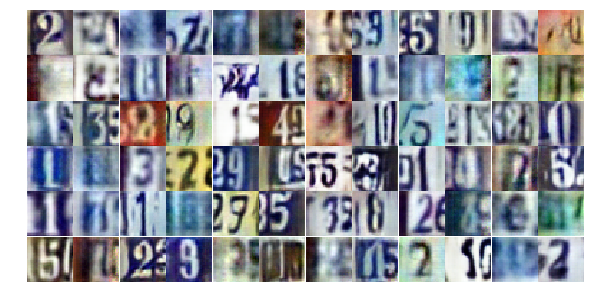

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))